 # **Customer Behaviour Segmentation Analysis**

#  Importing Libraries

In [1]:
# Essential Configuration
%matplotlib inline
%config InlineBackend.figure_formats = {'retina', 'svg'}

# Core Libraries
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')

# Visualization Libraries
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from matplotlib.colors import LinearSegmentedColormap
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.gridspec as gridspec
from matplotlib import colors as mcolors
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)

# Statistical and Data Manipulation
from scipy.stats import linregress
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from collections import Counter


# Scikit-learn Libraries
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA
from sklearn.ensemble import IsolationForest
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering, MeanShift, estimate_bandwidth
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.feature_selection import SelectKBest, f_regression, RFE
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import SequentialFeatureSelector as SFS
from tabulate import tabulate


# Visualization Helpers for Clustering
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

# Display Settings
pd.set_option('display.max_columns', None)  # Show all columns
pd.set_option('display.width', None)        # Adjust the display width to accommodate all columns

# Seaborn Default Settings
sns.set(
    {
        "figure.figsize": (8, 6)
    },
    style='ticks',
    color_codes=True,
    font_scale=0.8
)


# PART A - DATA UNDERSTANDING & EXPLORATION

# 1.0 Loading the Dataset

In [2]:
# Load dataset using panda read_csv to and check first five rows
df = pd.read_csv('Dataset_ecommerce.csv')
df.head()

,InvoiceNo,InvoiceDate,CustomerID,StockCode,Description,Quantity,UnitPrice,Country
0,536365,2010-12-01 08:26:00,17850.0,SC1734,Electronics,65,10.23,Egypt
1,536365,2010-12-01 08:26:00,17850.0,SC2088,Furniture,95,19.61,Mali
2,536365,2010-12-01 08:26:00,17850.0,SC3463,Books,78,61.49,Mali
3,536365,2010-12-01 08:26:00,17850.0,SC6228,Toys,15,24.73,South Africa
4,536365,2010-12-01 08:26:00,17850.0,SC2149,Toys,50,38.83,Rwanda


# Dataset Description:

1. InvoiceNo: Code representing each unique transaction.
2. StockCode:	Code uniquely assigned to each distinct product.
3. Description:	Description of each product.
4. Quantity:	The number of units of a product in a transaction.
5. InvoiceDate:	The date and time of the transaction.
6. UnitPrice:	The unit price of the product in sterling.
7. CustomerID:	Identifier uniquely assigned to each customer.
8. Country:	The country of the customer.

# 2.0 Data Understanding

In [3]:
#check data shape
df.shape

(541909, 8)

In [4]:
#check data information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   InvoiceDate  541909 non-null  object 
 2   CustomerID   406829 non-null  float64
 3   StockCode    541909 non-null  object 
 4   Description  541909 non-null  object 
 5   Quantity     541909 non-null  int64  
 6   UnitPrice    541909 non-null  float64
 7   Country      541909 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 33.1+ MB


In [5]:
# Check duplicate values
df.duplicated().sum()

# Displaying the number of duplicate rows
print(f"The dataset contains {df.duplicated().sum()} duplicate rows that need to be removed.")

The dataset contains 0 duplicate rows that need to be removed.


In [6]:
# Checking for missing values in dataset
df.isnull().sum()

InvoiceNo           0
InvoiceDate         0
CustomerID     135080
StockCode           0
Description         0
Quantity            0
UnitPrice           0
Country             0
dtype: int64

In [7]:
# check data statistics
df.describe(include='all').round(2)

,InvoiceNo,InvoiceDate,CustomerID,StockCode,Description,Quantity,UnitPrice,Country
count,541909,541909,406829.00,541909,541909,541909.00,541909.00,541909
unique,25900,23260,NaN,9000,10,NaN,NaN,28
top,573585,2011-10-31 14:41:00,NaN,SC2014,Sports Equipment,NaN,NaN,Cote d'Ivoire
freq,1114,1114,NaN,96,54765,NaN,NaN,19651
mean,NaN,NaN,15287.69,NaN,NaN,50.53,50.48,NaN
std,NaN,NaN,1713.60,NaN,NaN,28.85,28.56,NaN
min,NaN,NaN,12346.00,NaN,NaN,1.00,1.00,NaN
25%,NaN,NaN,13953.00,NaN,NaN,26.00,25.75,NaN
50%,NaN,NaN,15152.00,NaN,NaN,51.00,50.43,NaN
75%,NaN,NaN,16791.00,NaN,NaN,76.00,75.18,NaN


# Comments:

1. Quantity: The average quantity of products in a transaction is approximately 50.53. The quantity has a range with a minimum value of 1 and a maximum value of 100.
2. UnitPrice: The average unit price of the products is approximately 50.58.
The unit price also shows a wide range, from 1 to 100.
3. CustomerID: There are 406829 non-null entries, indicating missing values in the dataset which need to be addressed. The Customer IDs range from 12346 to 18287, helping in identifying unique customers.
4. InvoiceNo: There are 25900 unique invoice numbers, indicating 25900 separate transactions. The most frequent invoice number is 573585, appearing 1114 times, possibly representing a large transaction or an order with multiple items.
5. StockCode: There are 9000 unique stock codes representing different products.
The most frequent stock code is SC2014, appearing 96 times in the dataset.
6. Description: There are 10 unique product descriptions. The most frequent product description is "Sports Equipment", appearing 54765 times.
7. Country: The transactions come from 28 different countries, with a dominant majority of the transactions (approximately 3.6%) originating from the Cote d'Ivoire

# Other Observations:
1.   The data has 541,909 rows and  8 features.
2.   The missing values is from "CustomerID" only having missing values of 	135,080. The rows will be removed from the data.
3.   No duplicated values observed in the data.
4.   Unique Values: The unique vales are made of 28 countries , 22,190 invoices, 9,000 stock code.
5.   The data types consist of 5 objects, 2 floats , and 1 interger.
6.   The common words from 'Description' and 'Country' are 'Sports equipments' and 'Cote d'Ivouire'.


# 3.0 Data Preprocessing 

In [8]:
# Drop rows with missing values
df.dropna(inplace=True)

# Verifying the removal of missing values
print("No missing values:", df.isnull().sum().sum())


No missing values: 0


# Comment:

   CustomerID (135,080 missing values) : The CustomerID column contains nearly a quarter of missing data. This column is essential for clustering customers and creating a recommendation system. Imputing such a large percentage of missing values might introduce significant bias or noise into the analysis.
   
   Moreover, since the clustering is based on customer behavior and preferences, it's crucial to have accurate data on customer identifiers. Therefore, removing the rows with missing CustomerIDs seems to be the most reasonable approach to maintain the integrity of the clusters and the analysis.




In [9]:
#check data shape
df.shape

(406829, 8)

In [10]:
#convert date to pandas datetime
df["InvoiceDate"] = pd.to_datetime(df["InvoiceDate"])
df.head()

,InvoiceNo,InvoiceDate,CustomerID,StockCode,Description,Quantity,UnitPrice,Country
0,536365,2010-12-01 08:26:00,17850.0,SC1734,Electronics,65,10.23,Egypt
1,536365,2010-12-01 08:26:00,17850.0,SC2088,Furniture,95,19.61,Mali
2,536365,2010-12-01 08:26:00,17850.0,SC3463,Books,78,61.49,Mali
3,536365,2010-12-01 08:26:00,17850.0,SC6228,Toys,15,24.73,South Africa
4,536365,2010-12-01 08:26:00,17850.0,SC2149,Toys,50,38.83,Rwanda


In [11]:
# check data statistics
df.describe(include='all').round(2)

,InvoiceNo,InvoiceDate,CustomerID,StockCode,Description,Quantity,UnitPrice,Country
count,406829,406829,406829.00,406829,406829,406829.00,406829.00,406829
unique,22190,NaN,NaN,9000,10,NaN,NaN,28
top,576339,NaN,NaN,SC2014,Jewelry,NaN,NaN,Nigeria
freq,542,NaN,NaN,79,41017,NaN,NaN,14714
mean,NaN,2011-07-10 16:30:57.879207424,15287.69,NaN,NaN,50.48,50.48,NaN
min,NaN,2010-12-01 08:26:00,12346.00,NaN,NaN,1.00,1.00,NaN
25%,NaN,2011-04-06 15:02:00,13953.00,NaN,NaN,25.00,25.71,NaN
50%,NaN,2011-07-31 11:48:00,15152.00,NaN,NaN,50.00,50.43,NaN
75%,NaN,2011-10-20 13:06:00,16791.00,NaN,NaN,75.00,75.17,NaN
max,NaN,2011-12-09 12:50:00,18287.00,NaN,NaN,100.00,100.00,NaN


# Comment:
   After removing the missing data, 75% of the dataset remains, totaling 406,829 records.

# 4.0 Exploratory Data Analysis (EDA)


#  4.1 Total quantities grouped by country Analysis

In [12]:
# Total quantities grouped by country
qty_by_country = df.groupby(['Country'])['Quantity'].sum().reset_index()
qty_by_country = qty_by_country.sort_values(by='Quantity', ascending=False).reset_index(drop=True)
qty_by_country

,Country,Quantity
0,Togo,741223
1,South Africa,740589
2,Cote d'Ivoire,740229
3,Nigeria,739708
4,Libya,739206
5,Benin,738133
6,Zimbabwe,737522
7,Somalia,736219
8,Algeria,736181
9,Sierra Leone,735477


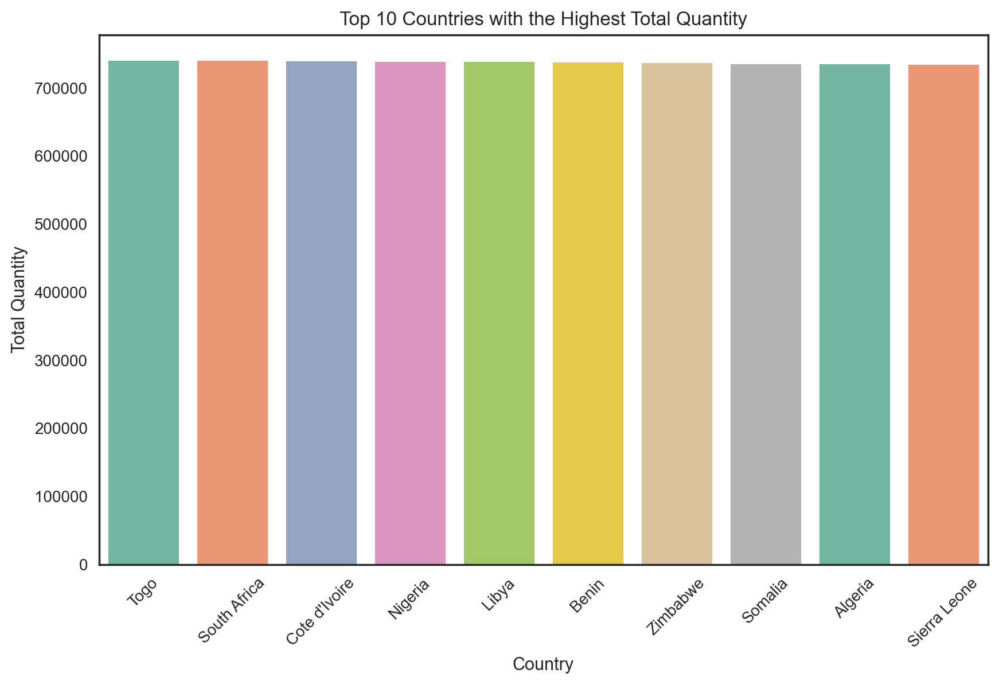

In [13]:
# Barplot of the Top 10 countries grouped by Quantities
top_10_countries = df.groupby('Country')['Quantity'].sum().nlargest(10)

#print(top_15_countries)

plt.figure(figsize=(10, 6))
colors = sns.color_palette("Set2", len(top_10_countries))
sns.barplot(x=top_10_countries.index, y=top_10_countries.values,palette=colors)
plt.xlabel('Country')
plt.ylabel('Total Quantity')
plt.title('Top 10 Countries with the Highest Total Quantity')
plt.xticks(rotation=45)
plt.show()

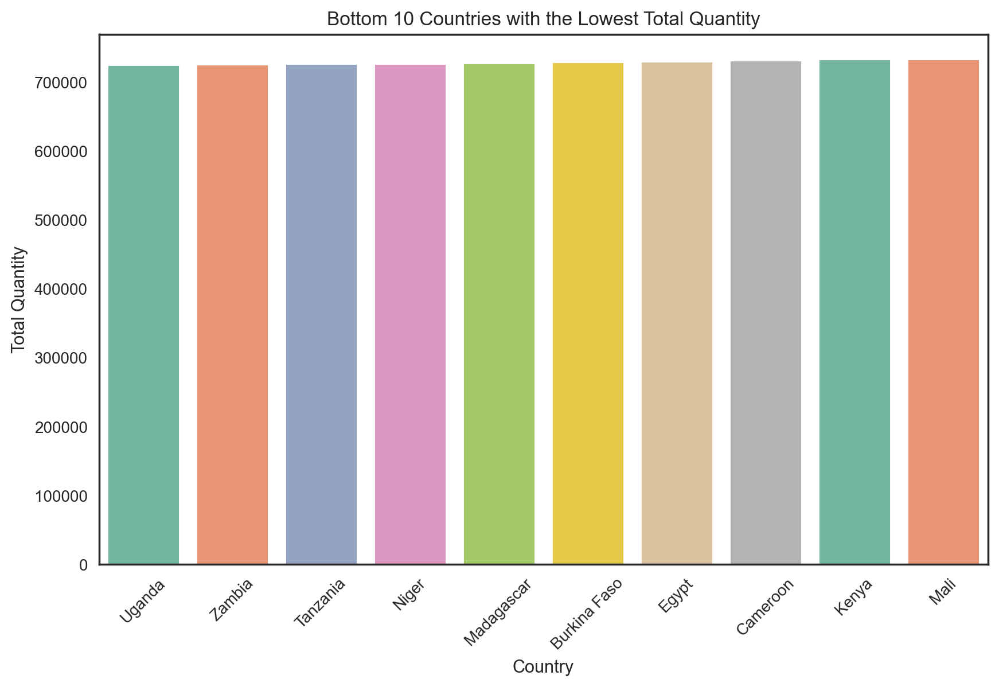

In [14]:
# Bottom 10 countries with the lowest total quantity
bottom_10_countries = df.groupby('Country')['Quantity'].sum().nsmallest(10)

# Create a bar plot with different colors for each bar
plt.figure(figsize=(10, 6))
colors = sns.color_palette("Set2", len(bottom_10_countries))  # Choose a color palette
sns.barplot(x=bottom_10_countries.index, y=bottom_10_countries.values, palette=colors)
plt.xlabel('Country')
plt.ylabel('Total Quantity')
plt.title('Bottom 10 Countries with the Lowest Total Quantity')
plt.xticks(rotation=45)
plt.show()

# Comment:
The results show the total quantities grouped by country, sorted in descending order.

* Togo has the highest quantity with 741,223, followed closely by South Africa (740,589) and Cote d'Ivoire (740,229).
*  Nigeria (739,708) and Libya (739,206) round out the top five.
*  At the lower end of the list, Uganda has the smallest total with 724,525.

Overall, the quantities are closely distributed among the countries, with Togo leading by a small margin.

# 4.2 Customers grouped by Countries Analysis

In [18]:
# Customers grouped by Countries Analysis
country_customer_count = df.groupby('Country')['CustomerID'].nunique().reset_index()
country_customer_count = country_customer_count.sort_values(by='CustomerID', ascending=False).reset_index(drop=True)
country_customer_count

,Country,CustomerID
0,Mozambique,3072
1,Benin,3054
2,Togo,3053
3,Nigeria,3051
4,Burkina Faso,3049
5,Sierra Leone,3046
6,Mali,3044
7,Algeria,3043
8,Senegal,3040
9,Niger,3039


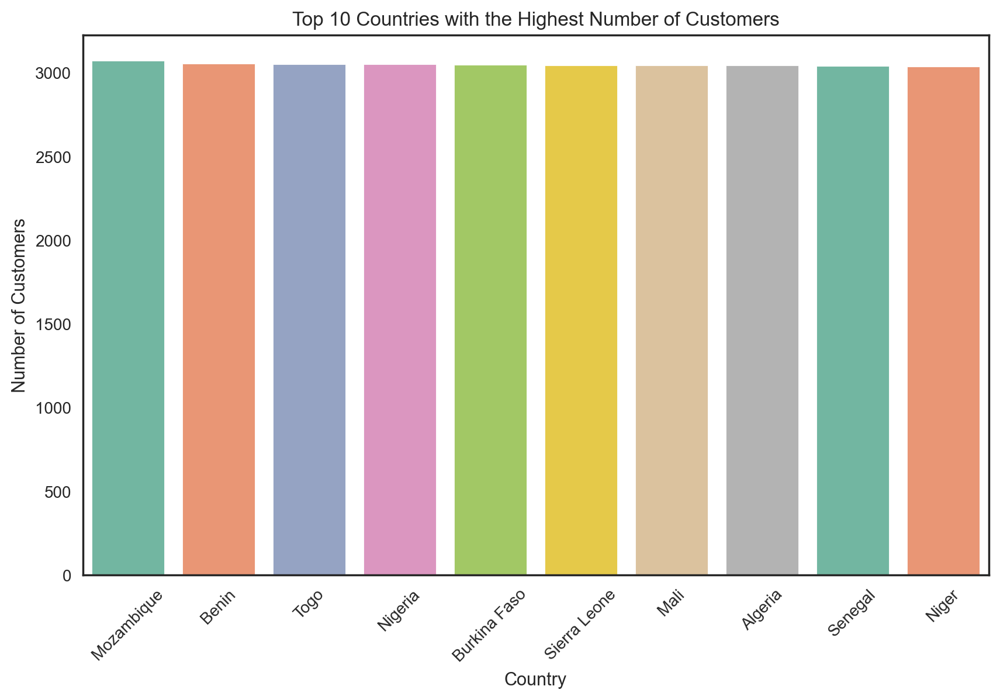

In [ ]:
# Top 10 countries by number of customers
top_countries_by_customers = df.groupby('Country')['CustomerID'].nunique().nlargest(10)

plt.figure(figsize=(10, 6))
colors = sns.color_palette("Set2", len(top_countries_by_customers))  # Choose a color palette
sns.barplot(x=top_countries_by_customers.index, y=top_countries_by_customers.values, palette=colors)
#plt.tight_layout
plt.xlabel('Country')
plt.ylabel('Number of Customers')
plt.title('Top 10 Countries with the Highest Number of Customers')
plt.xticks(rotation=45)
plt.show()

#Comment:

The results show the number of unique customers grouped by country, sorted in descending order of customer count.

*  Mozambique leads with the highest number of unique customers, 3,072, followed by Benin (3,054) and Togo (3,053).
* Nigeria (3,051) and Burkina Faso (3,049) complete the top five countries.
*  At the lower end, Uganda has the smallest unique customer count with 2,981, followed by Morocco (2,993).

The distribution of unique customer counts across countries is fairly even, with the top and bottom countries differing by less than 100 customers.


# 4.3 Monthly-Year Sales Trend

Monthly Sales Trend:
        Month  Total Sales
0  2010-12-01      1350834
1  2011-01-01      1105886
2  2011-02-01      1033468
3  2011-03-01      1406617
4  2011-04-01      1175052
5  2011-05-01      1459981
6  2011-06-01      1402857
7  2011-07-01      1388119
8  2011-08-01      1387695
9  2011-09-01      2061181
10 2011-10-01      2559609
11 2011-11-01      3313177
12 2011-12-01       891630


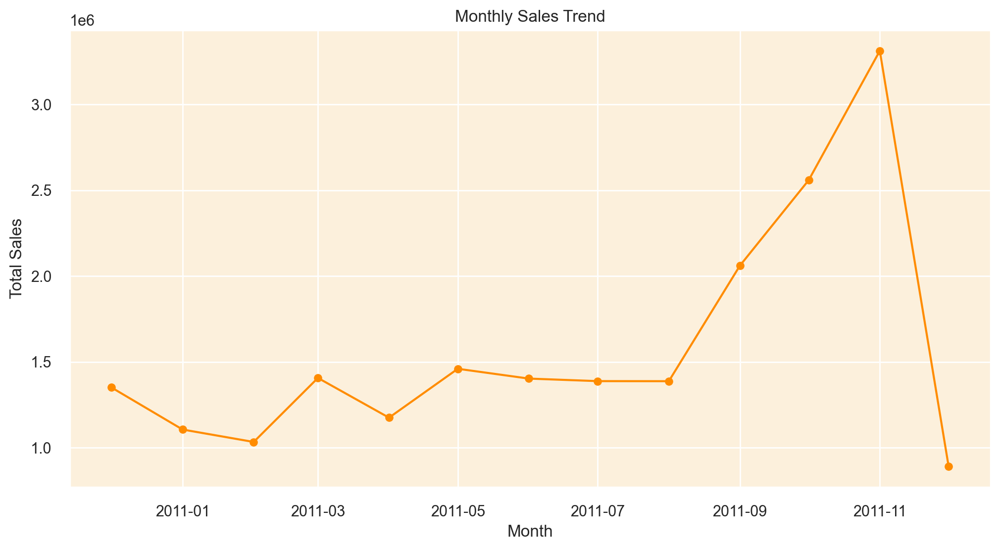

In [ ]:
# Group by InvoiceDate and sum the sales
monthly_sales = df.groupby(df['InvoiceDate'].dt.to_period('M'))['Quantity'].sum()

# Convert the Series to a DataFrame
monthly_sales_df = monthly_sales.reset_index()
monthly_sales_df.columns = ['Month', 'Total Sales']
monthly_sales_df['Month'] = monthly_sales_df['Month'].dt.to_timestamp()

# Display the table
print("Monthly Sales Trend:")
print(monthly_sales_df)

# Create the line plot
plt.figure(figsize=(12, 6))
plt.plot(monthly_sales_df['Month'], monthly_sales_df['Total Sales'], marker='o')
plt.xlabel('Month')
plt.ylabel('Total Sales')
plt.title('Monthly Sales Trend')
plt.grid(True)
plt.show()


# Monthly Sales Trend Analysis:

* General Trend:

The sales trend exhibits fluctuations throughout the year, with some months showing significant peaks.
A steady increase is observed from September to November 2011, followed by a sharp drop in December 2011.

* High Sales Periods:

November 2011 recorded the highest sales at 3,313,177, likely due to holiday shopping or promotional activities.
October 2011 and September 2011 also saw elevated sales, with 2,559,609 and 2,061,181, respectively, indicating a strong build-up to the holiday season.

* Low Sales Periods:

December 2011 had the lowest sales at 891,630, possibly due to reduced activity after the holiday peak or incomplete data for the month.
Early months, such as February 2011 (1,033,468) and January 2011 (1,105,886), also recorded relatively lower sales.

* Seasonal Patterns:

A significant surge in sales starts in the second half of the year, especially from September onward, suggesting a seasonal demand increase.
Mid-year months like June to August 2011 maintain steady sales around 1.38–1.40 million, indicating a stable customer base during this period.

# PART B SECTION - COHORT ANALYSIS

# 5. 0 Cohort Analysis

This tool evaluates customer retention by grouping customers into cohorts based on shared characteristics or behaviors within a specific time frame. To conduct this analysis, key elements such as the **cohort date, cohort index, and cohort table **need to be created. The following sections outline the steps taken to perform this analysis effectively.

# 5.1 Creation of Cohort Date

In [21]:
# Function to extract year, month, and set day to 1
def extract_year_month(x):
    """Extracts the year and month from a datetime object, setting the day to 1.

    Args:
        x: A datetime object.

    Returns:
        A pandas Timestamp with the year, month, and day set to 1.
    """
    return pd.Timestamp(x.year, x.month, 1)

# Sample DataFrame for demonstration
# df = pd.DataFrame({'InvoiceDate': ['2023-11-18', '2024-02-15']})
# df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])

# Apply the function to the 'InvoiceDate' column
df['InvoiceDate'] = df['InvoiceDate'].apply(extract_year_month)

# Display the modified DataFrame
df.head()


,InvoiceNo,InvoiceDate,CustomerID,StockCode,Description,Quantity,UnitPrice,Country
0,536365,2010-12-01,17850.0,SC1734,Electronics,65,10.23,Egypt
1,536365,2010-12-01,17850.0,SC2088,Furniture,95,19.61,Mali
2,536365,2010-12-01,17850.0,SC3463,Books,78,61.49,Mali
3,536365,2010-12-01,17850.0,SC6228,Toys,15,24.73,South Africa
4,536365,2010-12-01,17850.0,SC2149,Toys,50,38.83,Rwanda


In [ ]:
# function to create new column  called "cohort_date" using 'min' Invoicedate 

def get_cohort_date(df):
  """
  Creates a new column 'cohort_date' which represents the minimum InvoiceDate for each customer.

  Args:
      df: pandas DataFrame with 'CustomerID' and 'InvoiceDate' columns.

  Returns:
      pandas DataFrame with a new 'cohort_date' column.
  """
  cohort_df = df.groupby('CustomerID')['InvoiceDate'].min().reset_index()
  cohort_df = cohort_df.rename(columns={'InvoiceDate': 'cohort_date'})
  df = pd.merge(df, cohort_df, on='CustomerID', how='left')
  return df

# Apply the function to the DataFrame
df = get_cohort_date(df)

# Print the updated DataFrame
df.head()

,InvoiceNo,InvoiceDate,CustomerID,StockCode,Description,Quantity,UnitPrice,Country,cohort_date
0,536365,2010-12-01,17850.0,SC1734,Electronics,65,10.23,Egypt,2010-12-01
1,536365,2010-12-01,17850.0,SC2088,Furniture,95,19.61,Mali,2010-12-01
2,536365,2010-12-01,17850.0,SC3463,Books,78,61.49,Mali,2010-12-01
3,536365,2010-12-01,17850.0,SC6228,Toys,15,24.73,South Africa,2010-12-01
4,536365,2010-12-01,17850.0,SC2149,Toys,50,38.83,Rwanda,2010-12-01


# Comment:

The 'cohort_date' is the first month and year each unique 'customers' made their first purchase.

# 5.2 Creation of Cohort Index

In [23]:
# Function to calculate cohort index directly
def create_cohort_index(df, first_col, latest_col):
    """Calculates the cohort index directly without creating extra columns.

    Args:
        df: The DataFrame.
        first_col: The column name of the first purchase date as a string.
        latest_col: The column name of the latest purchase date as a string.

    Returns:
        The DataFrame with a new 'cohort_index' column.
    """
    first_year = df[first_col].dt.year
    first_month = df[first_col].dt.month
    latest_year = df[latest_col].dt.year
    latest_month = df[latest_col].dt.month

    # Create the cohort index directly in the DataFrame
    df['cohort_index'] = (latest_year - first_year) * 12 + (latest_month - first_month) + 1
    return df

# Apply the function to calculate the cohort index
df = create_cohort_index(df, 'cohort_date', 'InvoiceDate')

# Display the modified DataFrame
df.head()


,InvoiceNo,InvoiceDate,CustomerID,StockCode,Description,Quantity,UnitPrice,Country,cohort_date,cohort_index
0,536365,2010-12-01,17850.0,SC1734,Electronics,65,10.23,Egypt,2010-12-01,1
1,536365,2010-12-01,17850.0,SC2088,Furniture,95,19.61,Mali,2010-12-01,1
2,536365,2010-12-01,17850.0,SC3463,Books,78,61.49,Mali,2010-12-01,1
3,536365,2010-12-01,17850.0,SC6228,Toys,15,24.73,South Africa,2010-12-01,1
4,536365,2010-12-01,17850.0,SC2149,Toys,50,38.83,Rwanda,2010-12-01,1


# Comment:

The 'cohort_index' is a numerical value representing time difference in which each unique customer made their first purchase and their next purchase.

# 5.3 Creation of Cohort Pivot Table

In [ ]:
# Group by 'cohort_date' and 'cohort_index' to calculate unique CustomerIDs
cohort_info = df.groupby(['cohort_date', 'cohort_index'])['CustomerID'].nunique().reset_index()

# Rename 'CustomerID' column to 'no_of_customers'
cohort_info = cohort_info.rename(columns={'CustomerID': 'no_of_customers'})
cohort_info

,cohort_date,cohort_index,no_of_customers
0,2010-12-01,1,948
1,2010-12-01,2,362
2,2010-12-01,3,317
3,2010-12-01,4,367
4,2010-12-01,5,341
...,...,...,...
86,2011-10-01,2,93
87,2011-10-01,3,46
88,2011-11-01,1,321
89,2011-11-01,2,43


In [25]:
# Create a pivot table for the cohort_info
cohort_table = cohort_info.pivot(index='cohort_date', columns='cohort_index', values='no_of_customers')
cohort_table.index = cohort_table.index.strftime('%B, %Y')
cohort_table

cohort_index,1,2,3,4,5,6,7,8,9,10,11,12,13
cohort_date,,,,,,,,,,,,,
"December, 2010",948.0,362.0,317.0,367.0,341.0,376.0,360.0,336.0,336.0,374.0,354.0,474.0,260.0
"January, 2011",421.0,101.0,119.0,102.0,138.0,126.0,110.0,108.0,131.0,146.0,155.0,63.0,NaN
"February, 2011",380.0,94.0,73.0,106.0,102.0,94.0,97.0,107.0,98.0,119.0,35.0,NaN,NaN
"March, 2011",440.0,84.0,112.0,96.0,102.0,78.0,116.0,105.0,127.0,39.0,NaN,NaN,NaN
"April, 2011",299.0,68.0,66.0,63.0,62.0,71.0,69.0,78.0,25.0,NaN,NaN,NaN,NaN
"May, 2011",279.0,66.0,48.0,48.0,60.0,68.0,74.0,29.0,NaN,NaN,NaN,NaN,NaN
"June, 2011",235.0,49.0,44.0,64.0,58.0,79.0,24.0,NaN,NaN,NaN,NaN,NaN,NaN
"July, 2011",191.0,40.0,39.0,44.0,52.0,22.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"August, 2011",167.0,42.0,42.0,42.0,23.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# 5.4 Cohort Analysis Heatmap

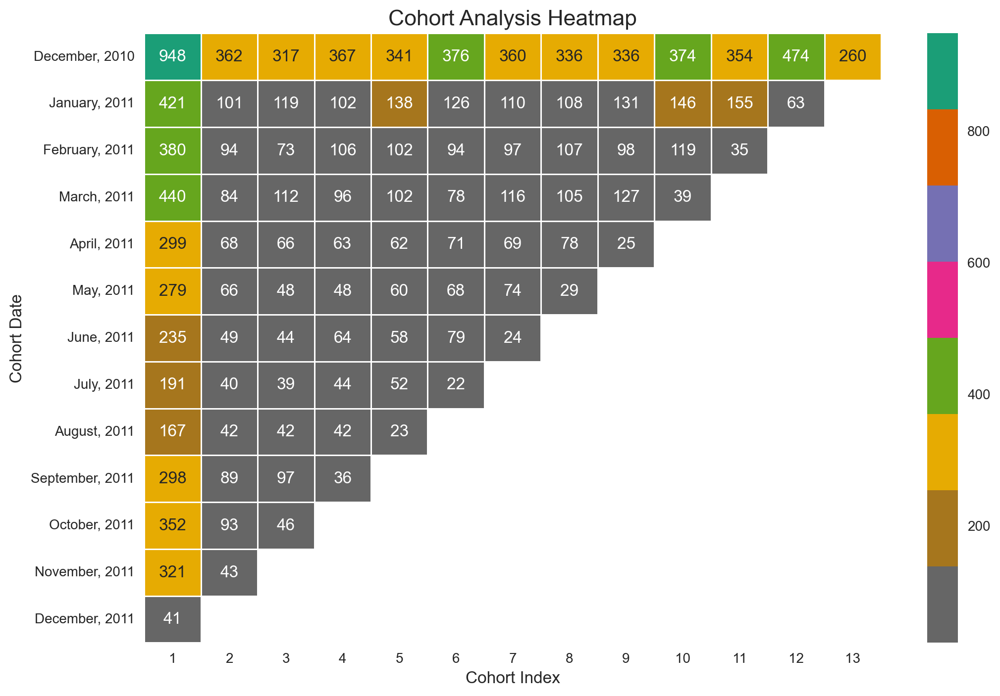

In [26]:
# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(cohort_table, annot=True, fmt='g', cmap='Dark2_r', linewidths=0.5)
plt.title('Cohort Analysis Heatmap', fontsize=16)
plt.xlabel('Cohort Index', fontsize=12)
plt.ylabel('Cohort Date', fontsize=12)
#plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

# Comment:

1. Acquisition Analysis:
For the first month, December 2010, there has been a steady decline in acquiring new customers. The number dropped from 948 customers in December 2010 to 421 in January 2011 and further down to 380 in February 2011. By December 2011 (12 months later), only 41 new customers were acquired, marking a sharp decline in new customer acquisitions over the span of a year.

2. Retention Analysis:
For subsequent months following the first-month analysis, it was observed that 948 customers made their first purchase in December 2010. Of these, 362 customers returned to make a purchase in the second month, and 317 customers completed their third purchase in the third month. Interestingly, there were increases in the number of customers making purchases during the 6th, 10th, and 12th months, suggesting periods of renewed engagement or retention strategies being effective during those months.

# 5.5 Cohort Analysis Heatmap (Percentage Retention)

In [27]:
# create new cohort table for Cohort Analysis Heatmap (Percentage Retention)
new_cohort_table=cohort_table.divide(cohort_table.iloc[:, 0], axis=0)
new_cohort_table

cohort_index,1,2,3,4,5,6,7,8,9,10,11,12,13
cohort_date,,,,,,,,,,,,,
"December, 2010",1.0,0.381857,0.334388,0.387131,0.359705,0.396624,0.379747,0.354430,0.354430,0.394515,0.373418,0.500000,0.274262
"January, 2011",1.0,0.239905,0.282660,0.242280,0.327791,0.299287,0.261283,0.256532,0.311164,0.346793,0.368171,0.149644,NaN
"February, 2011",1.0,0.247368,0.192105,0.278947,0.268421,0.247368,0.255263,0.281579,0.257895,0.313158,0.092105,NaN,NaN
"March, 2011",1.0,0.190909,0.254545,0.218182,0.231818,0.177273,0.263636,0.238636,0.288636,0.088636,NaN,NaN,NaN
"April, 2011",1.0,0.227425,0.220736,0.210702,0.207358,0.237458,0.230769,0.260870,0.083612,NaN,NaN,NaN,NaN
"May, 2011",1.0,0.236559,0.172043,0.172043,0.215054,0.243728,0.265233,0.103943,NaN,NaN,NaN,NaN,NaN
"June, 2011",1.0,0.208511,0.187234,0.272340,0.246809,0.336170,0.102128,NaN,NaN,NaN,NaN,NaN,NaN
"July, 2011",1.0,0.209424,0.204188,0.230366,0.272251,0.115183,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"August, 2011",1.0,0.251497,0.251497,0.251497,0.137725,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


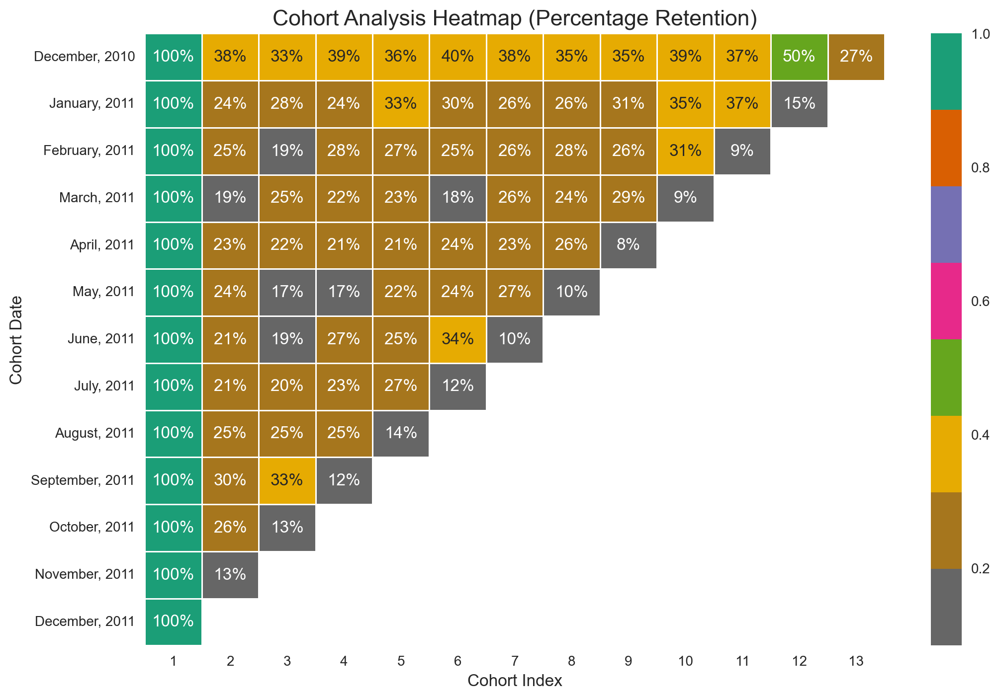

In [28]:
# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(new_cohort_table, annot=True, fmt=".0%", cmap='Dark2_r', linewidths=0.5)
plt.title('Cohort Analysis Heatmap (Percentage Retention)', fontsize=16)
plt.xlabel('Cohort Index', fontsize=12)
plt.ylabel('Cohort Date', fontsize=12)
#plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

# Comment:

1. Customer Percentage Retention Analysis:
   Analyzing the heatmap, the average benchmark retention rate ranges between 30% and 40%. Notably, only December 2010 managed to sustain this benchmark, even achieving a 50% retention rate by the 12th month. This is followed by January 2011, which also performed relatively well. In contrast, other months have maintained lower retention rates, ranging between 20% and 29%.

# 5.6 Cohort Analysis Heatmap (Total Quantities Bought by Cohort)


In [ ]:
# Group by cohort_date, cohort_index, and sum the Quantity to get qty_bought
qty_bought = df.groupby(['cohort_date', 'cohort_index'])['Quantity'].sum().reset_index()

# Rename the 'Quantity' column to 'qty_bought' (optional)
#qty_bought = qty_bought.rename(columns={'Quantity': 'qty_bought'})

# Print the qty_bought DataFrame
qty_bought

,cohort_date,cohort_index,Quantity
0,2010-12-01,1,1350834
1,2010-12-01,2,546873
2,2010-12-01,3,462374
3,2010-12-01,4,613244
4,2010-12-01,5,510943
...,...,...,...
86,2011-10-01,2,181888
87,2011-10-01,3,44776
88,2011-11-01,1,574330
89,2011-11-01,2,56021


In [ ]:
# Create a pivot table for the qty_bought DataFrame
qty_table = qty_bought.pivot(index='cohort_date', columns='cohort_index', values='Quantity')

# Set the index to be the cohort dates formatted as 'Month, Year'
qty_table.index = qty_table.index.strftime('%B, %Y')

# Print the pivot table
qty_table

cohort_index,1,2,3,4,5,6,7,8,9,10,11,12,13
cohort_date,,,,,,,,,,,,,
"December, 2010",1350834.0,546873.0,462374.0,613244.0,510943.0,636443.0,597676.0,604504.0,600481.0,757806.0,725896.0,1165046.0,375469.0
"January, 2011",559013.0,121074.0,155931.0,120023.0,194675.0,166585.0,144835.0,149848.0,200661.0,258400.0,330607.0,76504.0,NaN
"February, 2011",450020.0,74008.0,98850.0,122918.0,111386.0,104214.0,108442.0,135276.0,151180.0,145405.0,21787.0,NaN,NaN
"March, 2011",563434.0,74215.0,125519.0,119480.0,122078.0,107554.0,139852.0,182259.0,212009.0,49685.0,NaN,NaN,NaN
"April, 2011",371021.0,71541.0,66410.0,65115.0,70639.0,105065.0,97319.0,110572.0,27119.0,NaN,NaN,NaN,NaN
"May, 2011",308885.0,55453.0,44637.0,45690.0,76473.0,118534.0,97156.0,41183.0,NaN,NaN,NaN,NaN,NaN
"June, 2011",285867.0,47847.0,35516.0,76483.0,88504.0,127400.0,31264.0,NaN,NaN,NaN,NaN,NaN,NaN
"July, 2011",254889.0,25983.0,68721.0,69466.0,91529.0,26831.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"August, 2011",243542.0,80156.0,144849.0,141888.0,45405.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


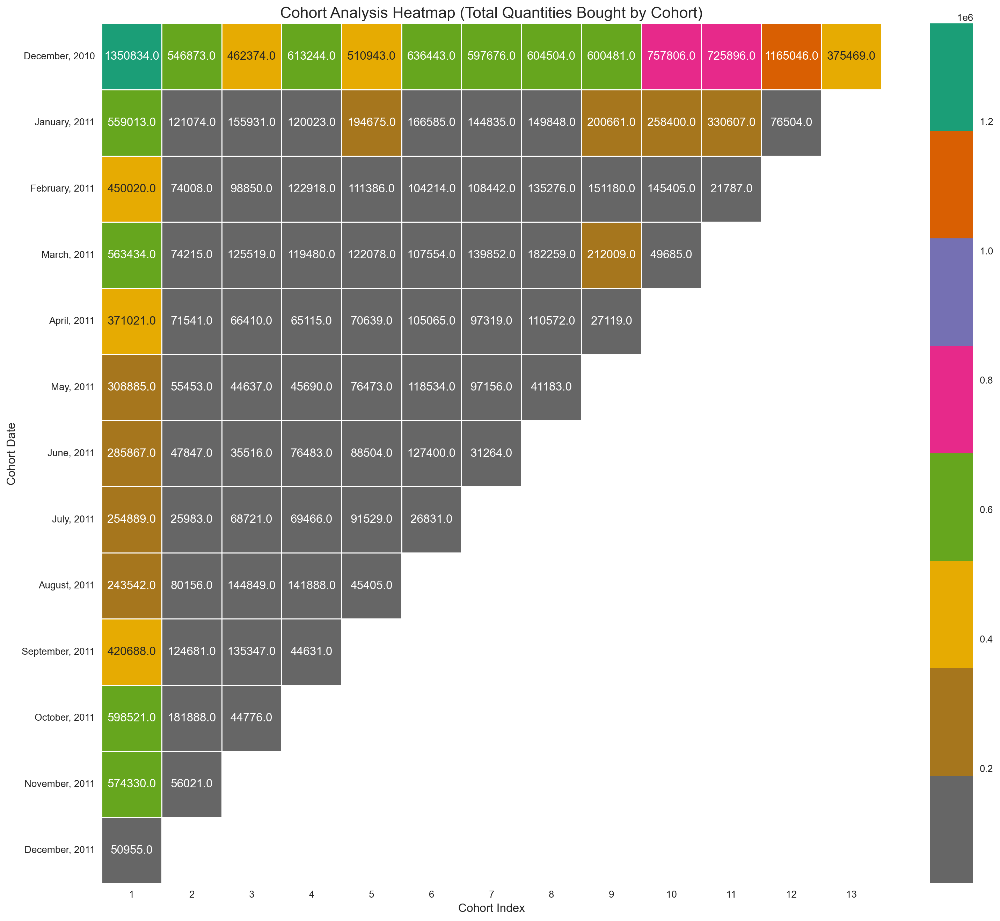

In [31]:
# Plot the heatmap
plt.figure(figsize=(18, 16))
sns.heatmap(qty_table, annot=True, fmt=".1f", cmap='Dark2_r', linewidths=0.5)
plt.title('Cohort Analysis Heatmap (Total Quantities Bought by Cohort)', fontsize=16)
plt.xlabel('Cohort Index', fontsize=12)
plt.ylabel('Cohort Date', fontsize=12)
#plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

#Comment:

The total quantity purchased across all cohorts ranges from a minimum of 50,955 in December 2011 to a maximum of 1,350,834 in December 2010. This aligns with the earlier analysis of customer retention rates, highlighting the strong performance in December 2010 compared to subsequent months.

## 5.7 Cohort Analysis Heatmap (Mean Quantities Bought by Cohort)

In [ ]:
# Group by cohort_date, cohort_index, and sum the Quantity to get qty_bought
mean_qty_bought = df.groupby(['cohort_date', 'cohort_index'])['Quantity'].mean().reset_index()

# Rename the 'Quantity' column to 'qty_bought' (optional)
#qty_bought = qty_bought.rename(columns={'Quantity': 'qty_bought'})

# Print the qty_bought DataFrame
mean_qty_bought

,cohort_date,cohort_index,Quantity
0,2010-12-01,1,50.310391
1,2010-12-01,2,50.259443
2,2010-12-01,3,50.351084
3,2010-12-01,4,50.635290
4,2010-12-01,5,50.628518
...,...,...,...
86,2011-10-01,2,49.928081
87,2011-10-01,3,49.367144
88,2011-11-01,1,51.056094
89,2011-11-01,2,48.629340


In [ ]:
# Create a pivot table for the qty_bought DataFrame
mean_qty_table = mean_qty_bought.pivot(index='cohort_date', columns='cohort_index', values='Quantity')

# Set the index to be the cohort dates formatted as 'Month, Year'
mean_qty_table.index = mean_qty_table.index.strftime('%B, %Y')

# Print the pivot table
mean_qty_table

cohort_index,1,2,3,4,5,6,7,8,9,10,11,12,13
cohort_date,,,,,,,,,,,,,
"December, 2010",50.310391,50.259443,50.351084,50.635290,50.628518,50.423309,50.526334,50.467858,50.182266,50.574346,50.546341,50.640963,50.677419
"January, 2011",50.676548,50.616221,50.758789,50.621257,50.908734,50.373450,50.289931,50.436890,50.468058,49.942018,50.590207,50.531044,NaN
"February, 2011",51.208466,49.736559,51.032525,50.334971,50.219116,50.687743,49.180045,50.741185,50.919502,49.592428,50.085057,NaN,NaN
"March, 2011",50.527666,50.213126,50.247798,50.243902,50.114122,50.613647,50.000715,51.081558,50.120331,50.441624,NaN,NaN,NaN
"April, 2011",50.685929,49.854355,49.969902,50.127021,50.637276,50.318487,50.294057,49.919639,51.071563,NaN,NaN,NaN,NaN
"May, 2011",50.745030,49.379341,50.153933,49.663043,51.186747,50.547548,49.926002,51.350374,NaN,NaN,NaN,NaN,NaN
"June, 2011",50.578025,50.955272,48.452933,50.550562,51.366222,50.878594,50.263666,NaN,NaN,NaN,NaN,NaN,NaN
"July, 2011",50.734275,49.491429,50.791574,50.083634,49.771071,50.720227,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"August, 2011",50.506429,49.848259,50.434889,51.038849,50.171271,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


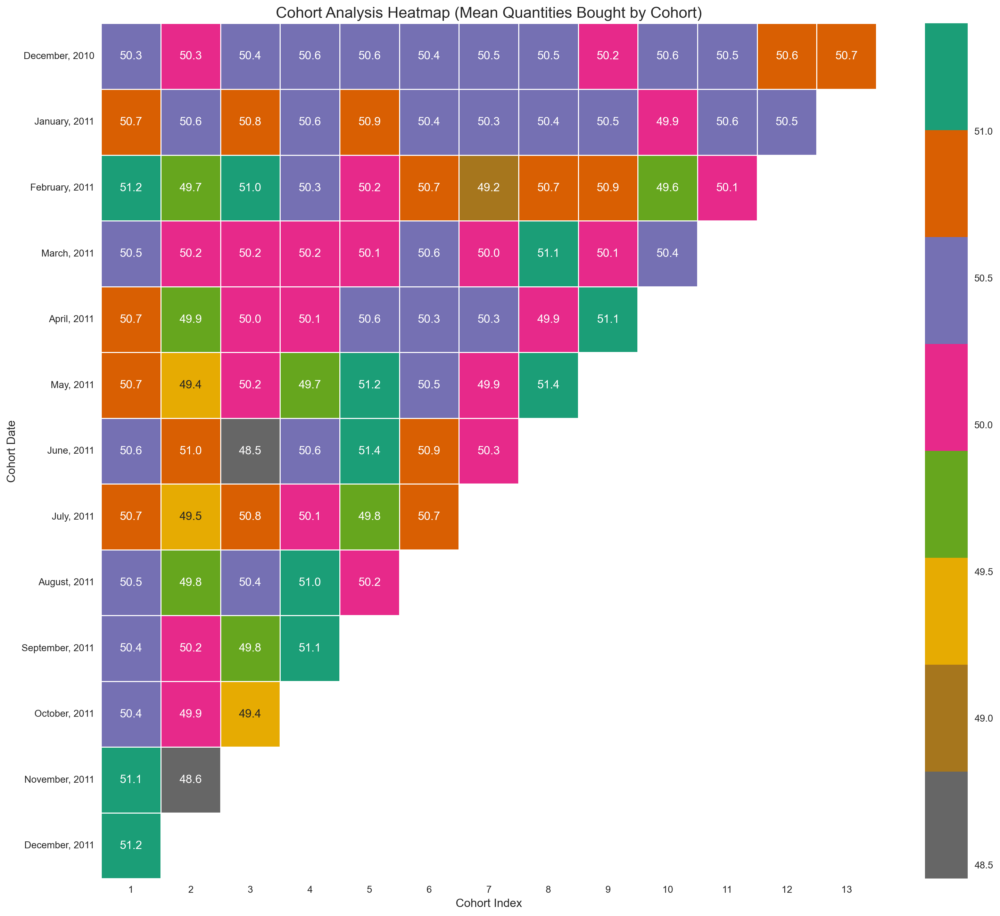

In [34]:
# Plot the heatmap
plt.figure(figsize=(18, 16))
sns.heatmap(mean_qty_table, annot=True, fmt=".1f", cmap='Dark2_r', linewidths=0.5)
plt.title('Cohort Analysis Heatmap (Mean Quantities Bought by Cohort)', fontsize=16)
plt.xlabel('Cohort Index', fontsize=12)
plt.ylabel('Cohort Date', fontsize=12)
#plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

# Comment:

The average quantity purchased across all cohorts is approximately 50, ranging from a low of 48.5 to a high of 51.4. This suggests that as the number of customers decreased over time, the remaining customers likely purchased more products, leading to the observed average quantities.

# PART C SECTION - CUSTOMER SEGMENTATION ANALYSIS

# 1.0 Feature Engineering

# 1.1 Recency (R)
Recency measures how recently a customer has made a purchase, providing insights into their engagement with the business.

Feature to be engineered:

1. Days Since Last Purchase: This represents the number of days since the customer's last purchase.
    * Lower value: Indicates recent activity and higher engagement.
    * Higher value: Suggests decreased engagement or inactivity.

By analyzing recency, businesses can identify disengaged customers and implement targeted strategies to re-engage them, improving retention and fostering loyalty.

In [15]:
# Step 1: Ensure 'InvoiceDate' is in datetime format
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])

# Step 2: Extract only the date (without time) and store it in a new column 'InvoiceDay'
df['InvoiceDay'] = df['InvoiceDate'].dt.date

# Step 3: Determine the most recent purchase date for each customer
customer_data = (
    df.groupby('CustomerID', as_index=False)['InvoiceDay']
    .max()
    .rename(columns={'InvoiceDay': 'LastPurchaseDate'})
)

# Step 4: Find the most recent date across all transactions in the dataset
most_recent_date = pd.to_datetime(df['InvoiceDay'].max())

# Step 5: Convert 'LastPurchaseDate' to datetime for subtraction
customer_data['LastPurchaseDate'] = pd.to_datetime(customer_data['LastPurchaseDate'])

# Step 6: Calculate the number of days since the last purchase for each customer
customer_data['Days_Since_Last_Purchase'] = (most_recent_date - customer_data['LastPurchaseDate']).dt.days

# Step 7: Remove the 'LastPurchaseDate' column as it's no longer needed
customer_data.drop(columns=['LastPurchaseDate'], inplace=True)

# Display the final DataFrame
customer_data.head()

,CustomerID,Days_Since_Last_Purchase
0,12346.0,325
1,12347.0,2
2,12348.0,75
3,12349.0,18
4,12350.0,310


# 1.2  Frequency (F)

Frequency Features for Customer Engagement
To quantify customer engagement with the retailer, I will create two key features:

1.  Total Transactions: Represents the total number of unique transactions made by a customer. This helps assess the level of customer interaction with the retailer.
2. Total Products Purchased: Represents the total quantity of products purchased by a customer across all transactions, offering insights into their buying behavior and purchase volume.

These features enable effective customer segmentation based on buying frequency, which is essential for targeted marketing and personalized recommendations.

In [16]:
# Compute the number of unique transactions per customer
transaction_counts = (
    df.groupby('CustomerID')['InvoiceNo']
    .nunique()
    .reset_index()
    .rename(columns={'InvoiceNo': 'Transaction_Count'})
)

# Compute the total quantity of products bought by each customer
product_totals = (
    df.groupby('CustomerID')['Quantity']
    .sum()
    .reset_index()
    .rename(columns={'Quantity': 'Total_Products'})
)

# Incorporate the new metrics into the main customer_data dataframe
customer_data = customer_data.merge(transaction_counts, on='CustomerID', how='left')
customer_data = customer_data.merge(product_totals, on='CustomerID', how='left')

# Preview the enriched customer_data dataframe
customer_data.head()


,CustomerID,Days_Since_Last_Purchase,Transaction_Count,Total_Products
0,12346.0,325,2,119
1,12347.0,2,7,8511
2,12348.0,75,4,1539
3,12349.0,18,1,3434
4,12350.0,310,1,917


# 1.3  Monetary (M)

Monetary Features for Customer Insights
In this step, we will compute two essential metrics that provide insights into the monetary aspect of customer transactions:

1. Total Expenditure: This metric measures the total amount spent by each
customer. It is derived by summing the product of UnitPrice and Quantity across all transactions for a customer. This metric is critical for understanding customer value, as it directly contributes to business revenue.
2. Average Purchase Value: This metric is calculated by dividing the Total Expenditure by the number of transactions (Total Transactions) for each customer. It highlights the average spending per transaction and offers insights into a customer's purchasing behavior, helping to personalize offers and marketing campaigns.

In [17]:
# Calculate the monetary value for each transaction
df['Monetary_Value'] = df['UnitPrice'] * df['Quantity']

# Aggregate the total expenditure for each customer
customer_spend = (
    df.groupby('CustomerID')['Monetary_Value']
    .sum()
    .reset_index()
    .rename(columns={'Monetary_Value': 'Total_Expenditure'})
)

# Compute the average transaction value for each customer
avg_transaction_value = customer_spend.merge(transaction_counts, on='CustomerID', how='left')
avg_transaction_value['Avg_Transaction_Value'] = (
    avg_transaction_value['Total_Expenditure'] / avg_transaction_value['Transaction_Count']
)

# Integrate these metrics into the main customer_data DataFrame
customer_data = customer_data.merge(customer_spend, on='CustomerID', how='left')
customer_data = customer_data.merge(avg_transaction_value[['CustomerID', 'Avg_Transaction_Value']], on='CustomerID', how='left')

# Display the first few records of the enriched DataFrame
customer_data.head()


,CustomerID,Days_Since_Last_Purchase,Transaction_Count,Total_Products,Total_Expenditure,Avg_Transaction_Value
0,12346.0,325,2,119,5342.40,2671.2000
1,12347.0,2,7,8511,431501.00,61643.0000
2,12348.0,75,4,1539,82378.47,20594.6175
3,12349.0,18,1,3434,176075.12,176075.1200
4,12350.0,310,1,917,48173.37,48173.3700


# 1.4  Product Diversity

Analyzing Product Diversity in Customer Purchases
This step focuses on understanding the variety of products purchased by customers. Product diversity provides insights into customer preferences and helps in creating tailored marketing strategies and product recommendations.

Key Metric:
* Unique Products Purchased: This metric captures the number of distinct products a customer has bought.

    *  A higher value indicates that the customer explores a wide variety of products, suggesting diverse preferences.
    * A lower value reflects a more focused purchasing pattern, where the customer repeatedly buys a limited range of products.
Segmenting customers based on product diversity allows businesses to better target their recommendations and promotions to suit individual customer preferences.



In [18]:
# Calculate the diversity of products purchased by each customer
product_diversity = (
    df.groupby('CustomerID')['StockCode']
    .nunique()
    .reset_index()
    .rename(columns={'StockCode': 'Product_Diversity'})
)

# Integrate the product diversity metric into the customer data
customer_data = customer_data.merge(product_diversity, on='CustomerID', how='left')

# View the updated customer data
customer_data.head()


,CustomerID,Days_Since_Last_Purchase,Transaction_Count,Total_Products,Total_Expenditure,Avg_Transaction_Value,Product_Diversity
0,12346.0,325,2,119,5342.40,2671.2000,2
1,12347.0,2,7,8511,431501.00,61643.0000,181
2,12348.0,75,4,1539,82378.47,20594.6175,31
3,12349.0,18,1,3434,176075.12,176075.1200,73
4,12350.0,310,1,917,48173.37,48173.3700,17


# 1.5 Behavioral Features

Understanding Customer Shopping Behavior
To better capture customer preferences and patterns, we introduce behavioral features. These metrics will help in identifying when customers are likely to shop and tailor marketing efforts accordingly.

Features Introduced:
1. Average Days Between Purchases: The average number of days a customer waits

before making another purchase. This metric helps predict future shopping activity and enables proactive engagement through targeted campaigns.

2. Preferred Shopping Day: The day of the week when the customer makes the most purchases. Insights from this feature can be used to schedule promotions on days that align with customer activity.


These behavioral insights create a comprehensive view of the customer, enabling more effective customer segmentation and tailored marketing strategies.



In [19]:
# Extract day of the week and hour from InvoiceDate
df['DayOfWeek'] = df['InvoiceDate'].dt.dayofweek
df['InvoiceDay'] = pd.to_datetime(df['InvoiceDay'], errors='coerce')

# Calculate the average number of days between consecutive purchases for each customer
average_days_gap = (
    df.groupby('CustomerID')['InvoiceDay']
    .apply(lambda dates: dates.diff().dt.days.mean())  # Use .dt accessor for datetime operations
    .reset_index()
    .rename(columns={'InvoiceDay': 'Avg_Days_Between_Purchases'})
)

# Identify the preferred shopping day for each customer
preferred_day = (
    df.groupby(['CustomerID', 'DayOfWeek'])
    .size()
    .reset_index(name='Count')
    .loc[lambda x: x.groupby('CustomerID')['Count'].idxmax()]
    [['CustomerID', 'DayOfWeek']]
    .rename(columns={'DayOfWeek': 'Preferred_Shopping_Day'})
)


# Merge the new features into the customer data
customer_data = customer_data.merge(average_days_gap, on='CustomerID', how='left')
customer_data = customer_data.merge(preferred_day, on='CustomerID', how='left')


# Display the first few rows of the updated dataframe
customer_data.head()


,CustomerID,Days_Since_Last_Purchase,Transaction_Count,Total_Products,Total_Expenditure,Avg_Transaction_Value,Product_Diversity,Avg_Days_Between_Purchases,Preferred_Shopping_Day
0,12346.0,325,2,119,5342.40,2671.2000,2,0.000000,1
1,12347.0,2,7,8511,431501.00,61643.0000,181,2.016575,1
2,12348.0,75,4,1539,82378.47,20594.6175,31,9.433333,3
3,12349.0,18,1,3434,176075.12,176075.1200,73,0.000000,0
4,12350.0,310,1,917,48173.37,48173.3700,17,0.000000,2


# 1.6 Geographic Features

In this step, the focus is on incorporating a geographic feature that captures customer location. Understanding customer distribution across regions provides valuable insights into buying patterns and operational considerations.

* Geographic Feature:
    * Country: Indicates the customer's country. This feature helps identify region-specific preferences, tailor marketing strategies, and optimize logistics. For example, different regions may favor distinct products, and shipping strategies can be adjusted accordingly.

In [20]:
# Analyze the distribution of customers by country
country_distribution = df['Country'].value_counts(normalize=True)

# Display the top countries by customer proportion
country_distribution.head(10).sort_values(ascending=False)


Country
Nigeria          0.036168
Sierra Leone     0.036094
Somalia          0.036025
Cote d'Ivoire    0.035998
Mozambique       0.035983
Cameroon         0.035934
Senegal          0.035927
Benin            0.035912
Ghana            0.035897
Libya            0.035850
Name: proportion, dtype: float64

 # Comment:

Since all the countries have approximately equal proportions in your dataset (around 3.5%–3.6%), directly using country as a categorical feature may not provide significant information for clustering and may even add unnecessary dimensionality, especially for algorithms like K-means that are sensitive to the number of features.

# Customer Data : Dataset Description:

1. CustomerID: Unique identifier assigned to each customer for distinction.
2. Days_Since_Last_Purchase:	Number of days since the customer's last purchase.
3. Transaction_Count:	Total number of transactions made by the customer.
4. Total_Products:	Total quantity of products purchased by the customer across all transactions.
5. Total_Expenditure:	Total amount of money spent by the customer across all transactions.
6. Avg_Transaction_Value:	Average transaction value, calculated as total spend divided by the number of transactions.
7. Product_Diversity:	Number of distinct products purchased by the customer.
8. Avg_Days_Between_Purchases: 	Average number of days between consecutive purchases made by the customer.
9. Preferred_Shopping_Day:	Preferred shopping day of the week, represented numerically (0 for Monday, 6 for Sunday).


In [21]:
# check data first 5 rows
customer_data.head()

,CustomerID,Days_Since_Last_Purchase,Transaction_Count,Total_Products,Total_Expenditure,Avg_Transaction_Value,Product_Diversity,Avg_Days_Between_Purchases,Preferred_Shopping_Day
0,12346.0,325,2,119,5342.40,2671.2000,2,0.000000,1
1,12347.0,2,7,8511,431501.00,61643.0000,181,2.016575,1
2,12348.0,75,4,1539,82378.47,20594.6175,31,9.433333,3
3,12349.0,18,1,3434,176075.12,176075.1200,73,0.000000,0
4,12350.0,310,1,917,48173.37,48173.3700,17,0.000000,2


In [43]:
# check data descriptions
customer_data.describe()

,CustomerID,Days_Since_Last_Purchase,Transaction_Count,Total_Products,Total_Expenditure,Avg_Transaction_Value,Product_Diversity,Avg_Days_Between_Purchases,Preferred_Shopping_Day
count,4372.000000,4372.000000,4372.000000,4372.000000,4.372000e+03,4372.000000,4372.000000,4293.000000,4372.000000
mean,15299.677722,91.581199,5.075480,4697.188015,2.372909e+05,50779.050577,90.024245,3.428176,2.535910
std,1722.390705,100.772139,9.338754,11755.863678,5.944603e+05,47930.896386,188.809824,11.516805,1.841548
min,12346.000000,0.000000,1.000000,1.000000,1.736000e+01,17.360000,1.000000,0.000000,0.000000
25%,13812.750000,16.000000,1.000000,865.750000,4.350893e+04,20591.351458,17.000000,0.000000,1.000000
50%,15300.500000,50.000000,3.000000,2094.000000,1.066925e+05,37204.237500,42.000000,1.174757,2.000000
75%,16778.250000,143.000000,5.000000,5145.250000,2.599154e+05,64792.096716,101.000000,3.093023,4.000000
max,18287.000000,373.000000,248.000000,404411.000000,2.038383e+07,604145.450000,5272.000000,309.000000,6.000000


# 2.0  Data Preprocessing after featured engineering


# 2. 1 Handling Missing Values

In [22]:
#Handling Missing Values
def impute_missing_values(data, features):
    imputer = SimpleImputer(strategy='mean')
    data[features] = imputer.fit_transform(data[features])
    return data

features = ['Days_Since_Last_Purchase', 'Transaction_Count', 'Total_Products',
            'Total_Expenditure', 'Avg_Transaction_Value', 'Product_Diversity',
            'Avg_Days_Between_Purchases', 'Preferred_Shopping_Day']

customer_data = impute_missing_values(customer_data, features)
print("Missing values handled successfully!")


Missing values handled successfully!


# 2.2 Outliers Detection

Given the multi-dimensional nature of the data, it would be prudent to use algorithms that can detect outliers in multi-dimensional spaces. I am going to use the *Isolation Forest algorithm* for this task. This algorithm works well for multi-dimensional data and is computationally efficient. It isolates observations by randomly selecting a feature and then randomly selecting a split value between the maximum and minimum values of the selected feature

In [23]:
def detect_and_remove_outliers(data, features, contamination=0.01):
    isolation_forest = IsolationForest(contamination=contamination, random_state=42)
    outliers = isolation_forest.fit_predict(data[features])
    data['is_outlier'] = outliers == -1
    data_cleaned = data[~data['is_outlier']].drop(columns=['is_outlier'])
    return data_cleaned

customer_data_cleaned = detect_and_remove_outliers(customer_data, features)
print(f"Outliers removed. Remaining rows: {len(customer_data_cleaned)}")


Outliers removed. Remaining rows: 4328


#Comment:

* The outliers removed were 1.0%(44 rows) of the total dataset leaving 4,328 data remining.

*  I  have successfully removed the outliers for further analysis and cleaned the main dataset.This cleaned dataset is now ready for the next steps for customer segmentation project.


# 2.3 Feature Scaling

Before proceeding, it's crucial to scale the features, as this is vital for distance-based methods like K-means and PCA:

K-means: Relies on distances to form clusters. Without scaling, features with larger ranges can dominate, leading to biased clustering.

PCA: Identifies directions of maximum variance. Unscaled features with larger ranges can overshadow others, distorting results.


Exceptions to Scaling:
*  CustomerID: Serves as an identifier, not meaningful for clustering.
* Preferred_Shopping_Day: A categorical feature (0–6), so scaling is unnecessary.

In [47]:
def scale_features(data, exclude_columns):
    scaler = StandardScaler()
    columns_to_scale = data.columns.difference(exclude_columns)
    data[columns_to_scale] = scaler.fit_transform(data[columns_to_scale])
    return data

exclude_columns = ['CustomerID', 'Preferred_Shopping_Day']
customer_data_scaled = scale_features(customer_data_cleaned.copy(), exclude_columns)
print("Feature scaling completed!")


Feature scaling completed!


In [ ]:
# # # Columns to exclude from scaling
# exclude_columns = ['CustomerID', 'Preferred_Shopping_Day']

# # Columns to scale (all except the ones in 'exclude_columns')
# columns_to_scale = customer_data_cleaned.columns.difference(exclude_columns)

# # Initialize the StandardScaler
# scaler = StandardScaler()

# # Make a copy of the cleaned dataset
# customer_data_scaled = customer_data_cleaned.copy()

# # Scale the necessary columns
# customer_data_scaled[columns_to_scale] = scaler.fit_transform(customer_data_scaled[columns_to_scale])

# # Display the first few rows of the scaled dataset
# customer_data_scaled.head()

,CustomerID,Days_Since_Last_Purchase,Transaction_Count,Total_Products,Total_Expenditure,Avg_Transaction_Value,Product_Diversity,Avg_Days_Between_Purchases,Preferred_Shopping_Day
0,12346.0,2.311939,-0.483138,-0.770987,-0.771716,-1.157528,-0.781822,-0.596908,5.0
1,12347.0,-0.978632,0.538884,0.968136,0.972134,0.338141,1.128850,-0.134897,5.0
2,12348.0,-0.082099,-0.074329,-0.476712,-0.456483,-0.702946,-0.472272,1.495601,2.0
3,12349.0,-0.683072,-0.687542,-0.084000,-0.073074,3.240420,-0.023958,-0.596908,1.0
4,12350.0,2.006527,-0.687542,-0.605613,-0.596451,-0.003482,-0.621710,-0.596908,1.0


 # 3.0  Featuring Selection 

# 3.1  Correlation Matrix and Multicollinearity Check

 Before performing KMeans clustering, it's crucial to examine the correlation between features in the dataset. High correlation between features, known as multicollinearity, can hinder the clustering process by providing redundant information. This reduces the model's ability to uncover true patterns and can lead to poorly separated clusters.

If multicollinearity is found, we can apply AFS and dimensionality reduction techniques, like PCA, to transform correlated features into a new set of uncorrelated variables. This improves clustering quality and computational efficiency by retaining most of the data’s variance while reducing redundancy

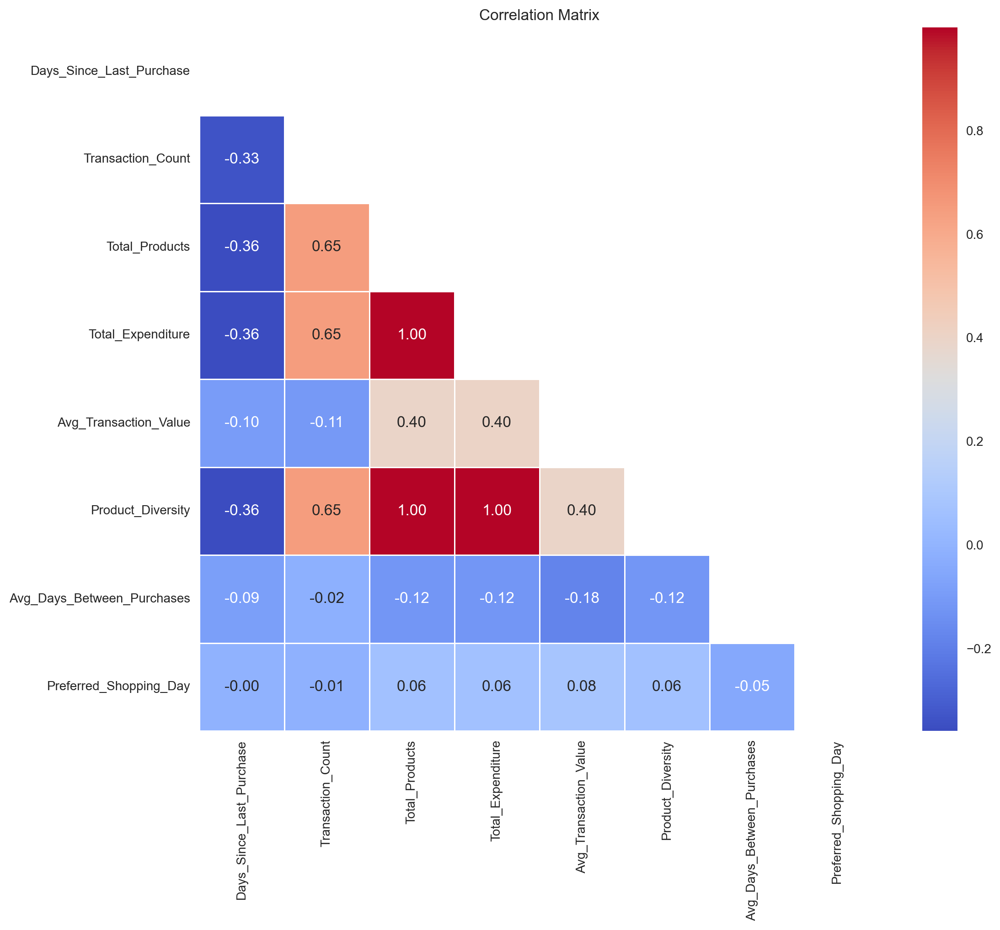

In [48]:
#Correlation Matrix and Multicollinearity Check
def plot_correlation_matrix(data, drop_columns):
    corr_matrix = data.drop(columns=drop_columns).corr()
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
    plt.figure(figsize=(12, 10))
    sns.heatmap(corr_matrix, mask=mask, cmap='coolwarm', annot=True, fmt='.2f', linewidths=0.5)
    plt.title('Correlation Matrix')
    plt.show()
    return corr_matrix

corr_matrix = plot_correlation_matrix(customer_data_scaled, ['CustomerID'])


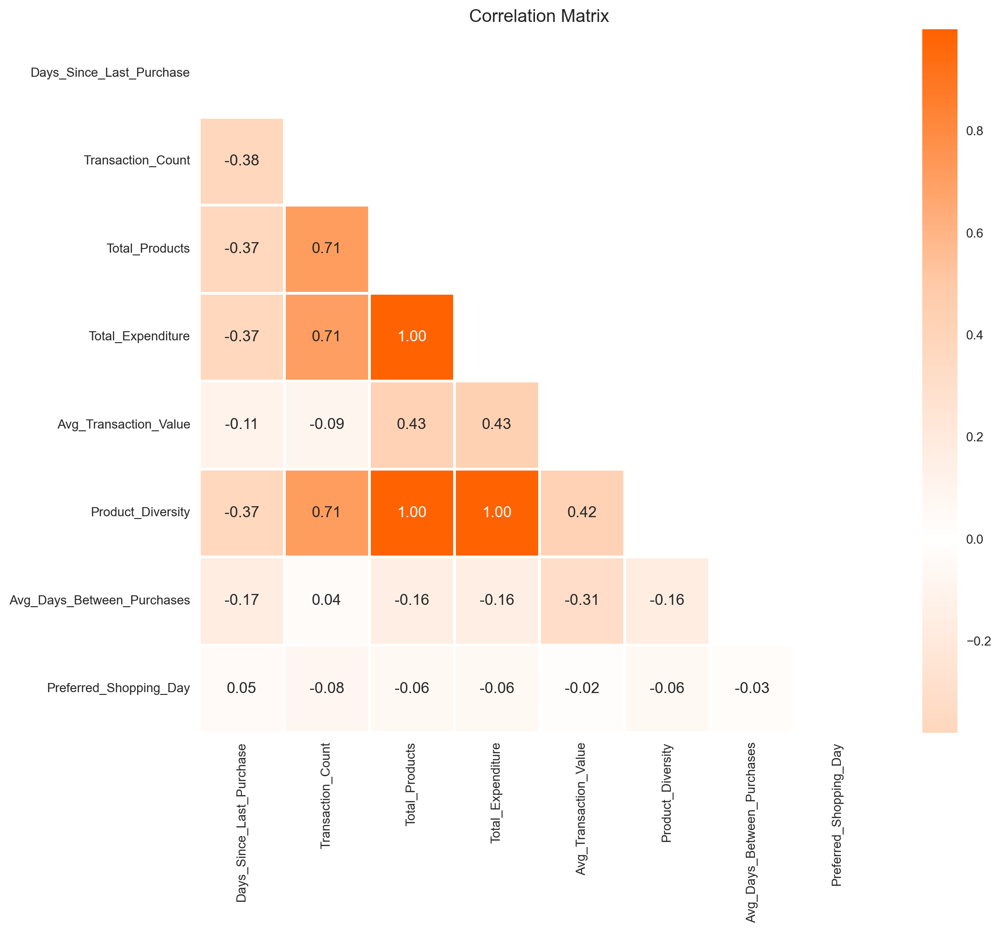

Features to Keep: ['Days_Since_Last_Purchase', 'Transaction_Count', 'Avg_Transaction_Value', 'Avg_Days_Between_Purchases', 'Preferred_Shopping_Day']
Features to Remove: ['Total_Expenditure', 'Product_Diversity', 'Total_Products']


In [ ]:
# # Drop 'CustomerID' and calculate the correlation matrix for the remaining features
# corr_matrix = customer_data_cleaned.drop(columns=['CustomerID']).corr()

# # Define a custom colormap
# colormap = LinearSegmentedColormap.from_list('custom_map', ['#ff6200', '#ffcaa8', 'white', '#ffcaa8', '#ff6200'], N=256)

# # Mask the upper triangle to avoid duplicate information
# mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

# # Plot the heatmap
# plt.figure(figsize=(12, 10))
# sns.heatmap(corr_matrix, mask=mask, cmap=colormap, annot=True, center=0, fmt='.2f', linewidths=2)
# plt.title('Correlation Matrix', fontsize=14)
# plt.show()

# # Identify features to keep and remove based on correlation threshold
# correlation_threshold = 0.8  # Set correlation threshold to determine multicollinearity

# # Create a list to store features to remove
# features_to_remove = []

# # Loop through the correlation matrix to find pairs of highly correlated features
# for column in corr_matrix.columns:
#     # Get the columns with correlations higher than the threshold
#     highly_correlated = corr_matrix[column][abs(corr_matrix[column]) > correlation_threshold].index.tolist()

#     # Remove the current column from the list of highly correlated features
#     if column in highly_correlated:
#         highly_correlated.remove(column)

#     # Add the features to remove list
#     features_to_remove.extend(highly_correlated)

# # Remove duplicates from the list of features to remove
# features_to_remove = list(set(features_to_remove))

# # Features to keep are those that are not in the features_to_remove list
# features_to_keep = [feature for feature in corr_matrix.columns if feature not in features_to_remove]

# # Output the features to keep and remove
# print("Features to Keep:", features_to_keep)
# print("Features to Remove:", features_to_remove)

# Comment:
   Upon reviewing the heatmap, we observe that several pairs of variables exhibit high correlations, such as:

* Total_Expenditure and Total_Products
* Total_Products and Product_Diversity
* Product_Diversity and Total_Expenditure

These strong correlations suggest that these variables are closely related, indicating potential multicollinearity. Therefore, it may be sufficient to retain only one of these features (Total_Expenditure, Total_Products, or Product_Diversity) for further clustering analysis.

To improve the clustering process, we may apply feature selection techniques like KBest, SFS (Sequential Feature Selection), or RFE (Recursive Feature Elimination). These methods, similar to dimensionality reduction techniques like PCA, can help streamline the feature set, improving the stability and reliability of the clusters formed by KMeans.


# 3.2 Automatic Feature Selection 

In [49]:
#Automatic Feature Selection
X = customer_data_scaled.drop(columns=["CustomerID"])
y = customer_data_cleaned["CustomerID"]  # Replace with actual target variable if needed

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

def select_features(X_train, y_train, method, k=6):
    if method == "SelectKBest":
        selector = SelectKBest(score_func=f_regression, k=k)
    elif method == "RFE":
        model = RandomForestRegressor(random_state=42)
        selector = RFE(estimator=model, n_features_to_select=k)
    elif method == "SFS":
        model = RandomForestRegressor(random_state=42)
        selector = SFS(estimator=model, n_features_to_select=k, direction='forward', scoring='r2', cv=5)
    else:
        raise ValueError("Invalid method. Choose 'SelectKBest', 'RFE', or 'SFS'.")
    selector.fit(X_train, y_train)
    return X_train.columns[selector.get_support()]

print("SelectKBest Features:", select_features(X_train, y_train, "SelectKBest"))
print("RFE Features:", select_features(X_train, y_train, "RFE"))
print("SFS Features:", select_features(X_train, y_train, "SFS"))


SelectKBest Features: Index(['Days_Since_Last_Purchase', 'Transaction_Count', 'Total_Expenditure',
       'Product_Diversity', 'Avg_Days_Between_Purchases',
       'Preferred_Shopping_Day'],
      dtype='object')
RFE Features: Index(['Days_Since_Last_Purchase', 'Total_Products', 'Total_Expenditure',
       'Avg_Transaction_Value', 'Product_Diversity',
       'Avg_Days_Between_Purchases'],
      dtype='object')
SFS Features: Index(['Days_Since_Last_Purchase', 'Transaction_Count', 'Total_Expenditure',
       'Avg_Transaction_Value', 'Avg_Days_Between_Purchases',
       'Preferred_Shopping_Day'],
      dtype='object')


In [ ]:
# # Load scaled data
# # Assuming customer_data_scaled is already loaded as a DataFrame
# X = customer_data_scaled.drop(columns=["CustomerID"])  # Drop 'CustomerID' since it's not a feature
# y = customer_data_scaled["CustomerID"]  # Assuming target is 'CustomerID'

# # Split data
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# # ==============================
# # SelectKBest
# # ==============================
# print("SelectKBest Feature Selection")
# k = 6  # Number of top features to select
# select_kbest = SelectKBest(score_func=f_regression, k=k)
# X_new_kbest = select_kbest.fit_transform(X_train, y_train)

# # Get feature scores and selected feature names
# scores = select_kbest.scores_
# selected_features_kbest = X_train.columns[select_kbest.get_support()]
# print(f"Selected Features: {selected_features_kbest}\n")

# # ==============================
# # Recursive Feature Elimination (RFE)
# # ==============================
# print("Recursive Feature Elimination (RFE)")
# model_rfe = RandomForestRegressor(random_state=42)
# rfe = RFE(estimator=model_rfe, n_features_to_select=k)
# rfe.fit(X_train, y_train)

# selected_features_rfe = X_train.columns[rfe.support_]
# print(f"Selected Features: {selected_features_rfe}\n")

# # ==============================
# # Sequential Feature Selection (SFS)
# # ==============================
# print("Sequential Feature Selection (SFS)")
# model_sfs = RandomForestRegressor(random_state=42)
# sfs = SFS(estimator=model_sfs, n_features_to_select=k, direction='forward', scoring='r2', cv=5)
# sfs.fit(X_train, y_train)

# selected_features_sfs = X_train.columns[sfs.get_support()]
# print(f"Selected Features: {selected_features_sfs}\n")


SelectKBest Feature Selection
Selected Features: Index(['Days_Since_Last_Purchase', 'Transaction_Count', 'Total_Products',
       'Avg_Transaction_Value', 'Avg_Days_Between_Purchases',
       'Preferred_Shopping_Day'],
      dtype='object')

Recursive Feature Elimination (RFE)
Selected Features: Index(['Days_Since_Last_Purchase', 'Total_Products', 'Total_Expenditure',
       'Avg_Transaction_Value', 'Product_Diversity',
       'Avg_Days_Between_Purchases'],
      dtype='object')

Sequential Feature Selection (SFS)
Selected Features: Index(['Days_Since_Last_Purchase', 'Transaction_Count', 'Total_Products',
       'Avg_Transaction_Value', 'Avg_Days_Between_Purchases',
       'Preferred_Shopping_Day'],
      dtype='object')



# comment:
The three AFS chose these common features: 'Days_Since_Last_Purchase',  'Total_Expenditure',
       'Avg_Transaction_Value', 'Avg_Days_Between_Purchases',
       

# 4.0  Dimensionality Reduction - Principal Component Analysis (PCA):

# 4.1 PCA Transformation and Plotting

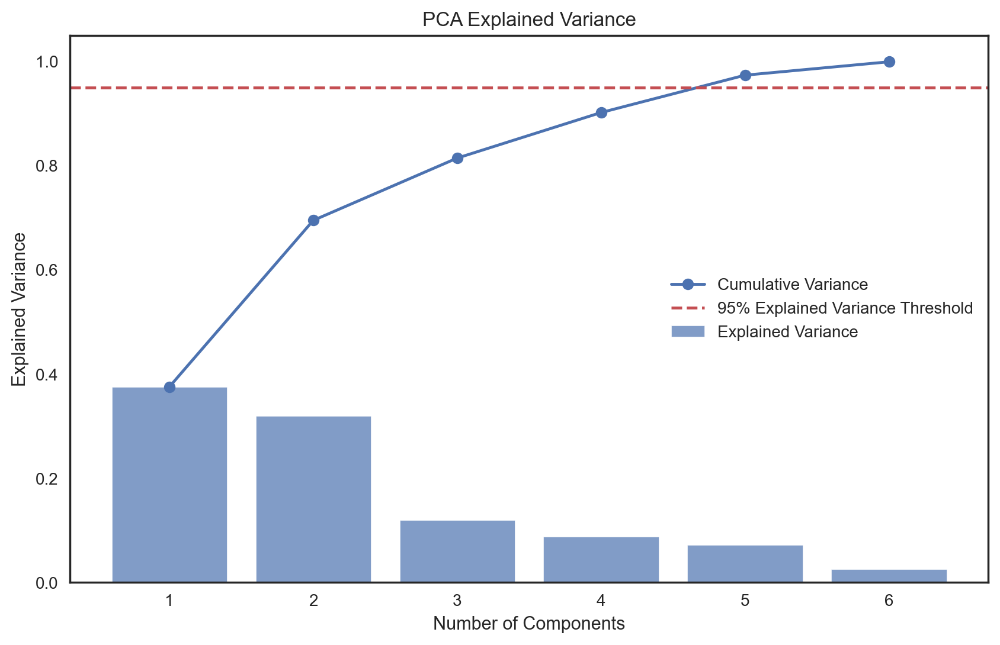

In [50]:
# Ensure CustomerID is the index to avoid it being included in PCA
if 'CustomerID' in customer_data_scaled.columns:
    customer_data_scaled.set_index('CustomerID', inplace=True)

def apply_pca(data, n_components=6):
    pca = PCA(n_components=n_components)
    pca_data = pca.fit_transform(data)
    pca_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(n_components)], index=data.index)
    return pca, pca_df

def plot_pca_variance(pca):
    explained_variance_ratio = pca.explained_variance_ratio_
    cumulative_variance = np.cumsum(explained_variance_ratio)
    plt.figure(figsize=(10, 6))
    plt.bar(range(1, len(cumulative_variance) + 1), explained_variance_ratio, alpha=0.7, label='Explained Variance')
    plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', label='Cumulative Variance')
    plt.axhline(y=0.95, color='r', linestyle='--', label='95% Explained Variance Threshold')
    plt.xlabel('Number of Components')
    plt.ylabel('Explained Variance')
    plt.title('PCA Explained Variance')
    plt.legend()
    plt.show()

# Apply PCA and plot variance
pca, customer_data_pca = apply_pca(customer_data_scaled, n_components=6)
plot_pca_variance(pca)


In [ ]:
# # Setting CustomerID as the index column
# customer_data_scaled.set_index('CustomerID', inplace=True)
# customer_data_scaled.head()

,Days_Since_Last_Purchase,Transaction_Count,Total_Products,Total_Expenditure,Avg_Transaction_Value,Product_Diversity,Avg_Days_Between_Purchases,Preferred_Shopping_Day
CustomerID,,,,,,,,
12346.0,2.311939,-0.483138,-0.770987,-0.771716,-1.157528,-0.781822,-0.596908,5.0
12347.0,-0.978632,0.538884,0.968136,0.972134,0.338141,1.128850,-0.134897,5.0
12348.0,-0.082099,-0.074329,-0.476712,-0.456483,-0.702946,-0.472272,1.495601,2.0
12349.0,-0.683072,-0.687542,-0.084000,-0.073074,3.240420,-0.023958,-0.596908,1.0
12350.0,2.006527,-0.687542,-0.605613,-0.596451,-0.003482,-0.621710,-0.596908,1.0


# 4.2 PCA

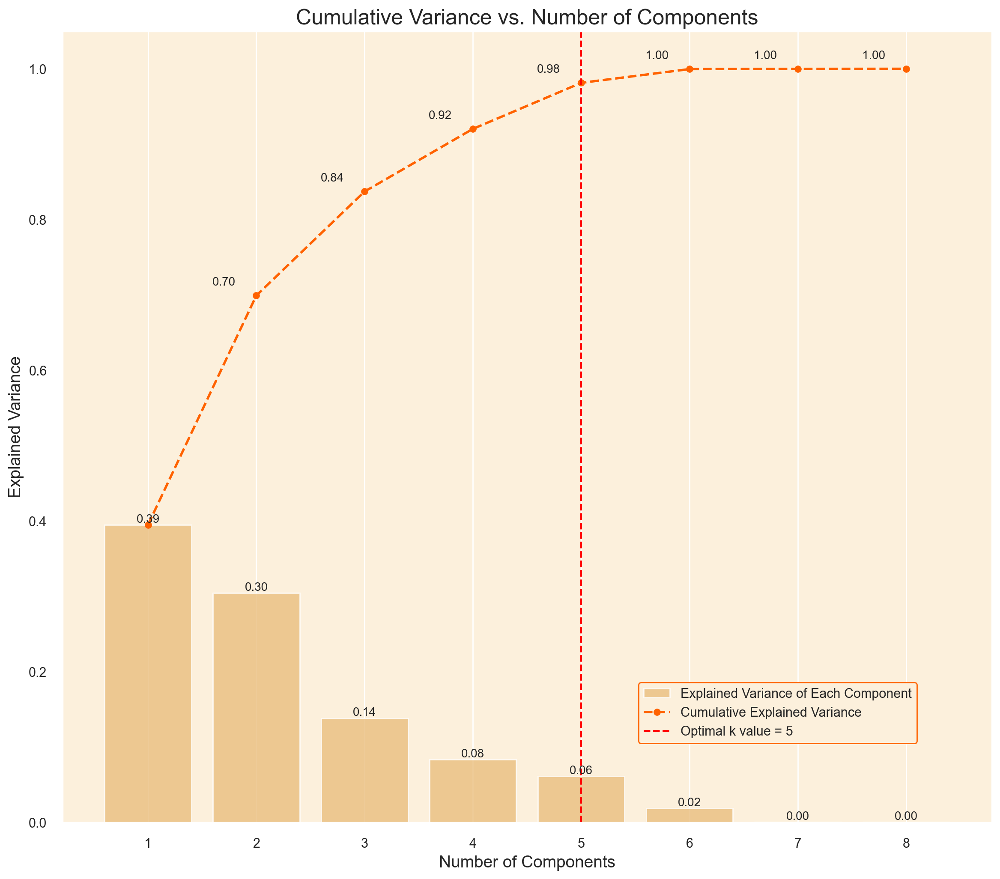

In [ ]:
# # Apply PCA
# pca = PCA().fit(customer_data_scaled)

# # Calculate the Cumulative Sum of the Explained Variance
# explained_variance_ratio = pca.explained_variance_ratio_
# cumulative_explained_variance = np.cumsum(explained_variance_ratio)

# # Set the optimal k value (based on our analysis, we can choose 6)
# optimal_k = 5

# # Set seaborn plot style
# sns.set(rc={'axes.facecolor': '#fcf0dc'}, style='darkgrid')

# # Plot the cumulative explained variance against the number of components
# plt.figure(figsize=(14, 12))

# # Bar chart for the explained variance of each component
# barplot = sns.barplot(x=list(range(1, len(cumulative_explained_variance) + 1)),
#                       y=explained_variance_ratio,
#                       color='#fcc36d',
#                       alpha=0.8)

# # Line plot for the cumulative explained variance
# lineplot, = plt.plot(range(0, len(cumulative_explained_variance)), cumulative_explained_variance,
#                      marker='o', linestyle='--', color='#ff6200', linewidth=2)

# # Plot optimal k value line
# optimal_k_line = plt.axvline(optimal_k - 1, color='red', linestyle='--', label=f'Optimal k value = {optimal_k}')

# # Set labels and title
# plt.xlabel('Number of Components', fontsize=14)
# plt.ylabel('Explained Variance', fontsize=14)
# plt.title('Cumulative Variance vs. Number of Components', fontsize=18)

# # Customize ticks and legend
# plt.xticks(range(0, len(cumulative_explained_variance)))
# plt.legend(handles=[barplot.patches[0], lineplot, optimal_k_line],
#            labels=['Explained Variance of Each Component', 'Cumulative Explained Variance', f'Optimal k value = {optimal_k}'],
#            loc=(0.62, 0.1),
#            frameon=True,
#            framealpha=1.0,
#            edgecolor='#ff6200')

# # Display the variance values for both graphs on the plots
# x_offset = -0.3
# y_offset = 0.01
# for i, (ev_ratio, cum_ev_ratio) in enumerate(zip(explained_variance_ratio, cumulative_explained_variance)):
#     plt.text(i, ev_ratio, f"{ev_ratio:.2f}", ha="center", va="bottom", fontsize=10)
#     if i > 0:
#         plt.text(i + x_offset, cum_ev_ratio + y_offset, f"{cum_ev_ratio:.2f}", ha="center", va="bottom", fontsize=10)

# plt.grid(axis='both')
# plt.show()

# Comment:

The plot and cumulative explained variance show how much variance each principal component captures:

  * First component: Explains ~39% of the variance.
  * First two components: Explain ~70% combined.
  *  First three components: Explain ~84%.

The "elbow point," where adding more components provides diminishing returns, appears after the 6th component (capturing 100% of the variance).

For customer segmentation, retaining the first 6 components balances dimensionality reduction with preserving sufficient variance to identify distinct groups effectively.

In [51]:
# Creating a PCA object with 6 components
pca = PCA(n_components=6)

# Fitting and transforming the original data to the new PCA dataframe
customer_data_pca = pca.fit_transform(customer_data_scaled)

# Creating a new dataframe from the PCA dataframe, with columns labeled PC1, PC2, etc.
customer_data_pca = pd.DataFrame(customer_data_pca, columns=['PC'+str(i+1) for i in range(pca.n_components_)])

# Adding the CustomerID index back to the new PCA dataframe
customer_data_pca.index = customer_data_scaled.index
# Displaying the resulting dataframe based on the PCs
customer_data_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6
CustomerID,,,,,,
12346.0,-2.466073,-0.660725,0.528510,-1.377463,1.403548,-0.181131
12347.0,1.161601,-2.106550,-0.008628,0.224117,-0.379686,-0.336047
12348.0,-0.660736,0.697992,-0.800757,0.092395,-0.103234,-0.042156
12349.0,-0.487933,-2.352216,1.990902,1.820495,-0.777099,0.929875
12350.0,-1.694399,0.167348,1.078907,-0.746220,1.358617,0.077994


In [52]:
# Define a function to highlight the top 3 absolute values in each column of a dataframe
def highlight_top3(column):
    top3 = column.abs().nlargest(3).index
    return ['background-color:  #ffeacc' if i in top3 else '' for i in column.index]

# Create the PCA component DataFrame and apply the highlighting function
pc_df = pd.DataFrame(pca.components_.T, columns=['PC{}'.format(i+1) for i in range(pca.n_components_)],
                     index=customer_data_scaled.columns)

pc_df.style.apply(highlight_top3, axis=0)

,PC1,PC2,PC3,PC4,PC5,PC6
Days_Since_Last_Purchase,-0.217551,0.106775,0.336060,-0.365486,0.831780,0.053795
Transaction_Count,0.328396,-0.173584,-0.389388,-0.396852,0.043115,0.742321
Total_Products,0.469126,-0.180128,0.036951,-0.008171,0.144194,-0.246601
Total_Expenditure,0.469058,-0.180158,0.038827,-0.005915,0.143567,-0.239699
Avg_Transaction_Value,0.212129,-0.027220,0.618248,0.551097,0.017860,0.517671
Product_Diversity,0.469158,-0.180327,0.035880,-0.009619,0.141277,-0.241715
Avg_Days_Between_Purchases,-0.077657,-0.007888,-0.585804,0.636235,0.494572,0.036639
Preferred_Shopping_Day,0.365506,0.927493,-0.076708,-0.015218,0.000401,0.006792


# comment:

Final Best Features Ranking:

1.   Transaction_Count
2.   Total_Products
3.   Total_Expenditure
4.   Product_Diversity
5.   Avg_Transaction_Value
6.   Avg_Days_Between_Purchases
7.   Preferred_Shopping_Day
8.   Days_Since_Last_Purchase


*  This ranking is based on the strength of the feature loadings on the principal components, with Transaction_Count emerging as the most important feature due to its consistent influence across multiple components.

 # 5.0 Model Selection, Building and Training  

# 5.1 Optimal Clusters Analysis
To ascertain the optimal number of clusters (k) for segmenting customers, I will explore two renowned methods:

Elbow Method

Silhouette Method

It's common to utilize both methods in practice to corroborate the results.

In [53]:
# Function to preprocess data
def preprocess_data(df, features):
    """
    Standardizes the dataset and applies PCA for dimensionality reduction.
    """
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(df[features])

    # Apply PCA for dimensionality reduction
    pca = PCA(n_components=6)
    X_pca = pca.fit_transform(X_scaled)
    
    return X_pca

# Load data
customer_data_cleaned = pd.read_csv("customer_data_cleaned.csv")  
features = [
    'Days_Since_Last_Purchase',
    'Transaction_Count',
    'Total_Products',
    'Total_Expenditure',
    'Avg_Transaction_Value',
    'Product_Diversity',
    'Avg_Days_Between_Purchases',
    'Preferred_Shopping_Day'
]
X_pca = preprocess_data(customer_data_cleaned, features)


In [54]:
#Optimal Clusters Analysis
def optimal_clusters_analysis(X, method="elbow", model_type="kmeans"):
    """
    Finds the optimal number of clusters using the specified method.
    """
    if model_type == "kmeans":
        model = KMeans(init='k-means++', n_init=10, max_iter=300, random_state=42)
    elif model_type == "gmm":
        model = GaussianMixture(random_state=42)
    else:
        raise ValueError("Invalid model type. Use 'kmeans' or 'gmm'.")

    if method == "elbow":
        visualizer = KElbowVisualizer(model, k=(2, 15))
        visualizer.fit(X)
        visualizer.show()
    elif method == "silhouette":
        silhouette_scores = []
        for k in range(2, 15):
            if model_type == "kmeans":
                model = KMeans(n_clusters=k, random_state=42)
            elif model_type == "gmm":
                model = GaussianMixture(n_components=k, random_state=42)
            labels = model.fit_predict(X)
            silhouette_scores.append(silhouette_score(X, labels))
        plt.plot(range(2, 15), silhouette_scores, marker='o')
        plt.title("Silhouette Analysis")
        plt.xlabel("Number of Clusters")
        plt.ylabel("Silhouette Score")
        plt.show()

# Elbow Method
# optimal_clusters_analysis(X_pca, method="elbow", model_type="kmeans")



# 5.1.1 Elbow Method(Kmeans) 

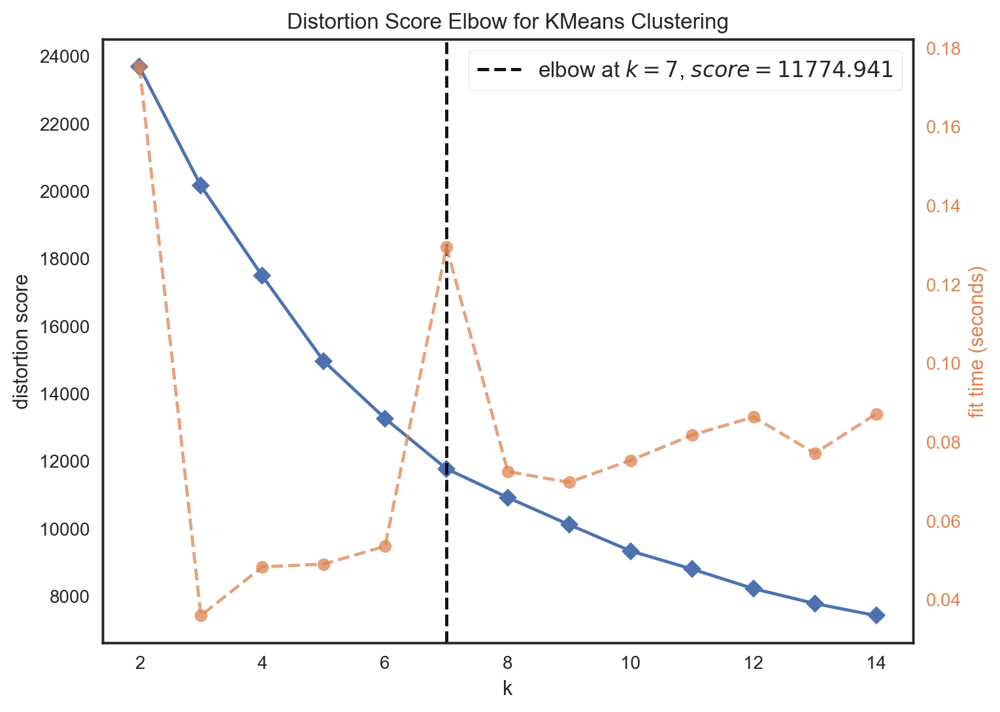

In [55]:
# Elbow Method
optimal_clusters_analysis(X_pca, method="elbow", model_type="kmeans")

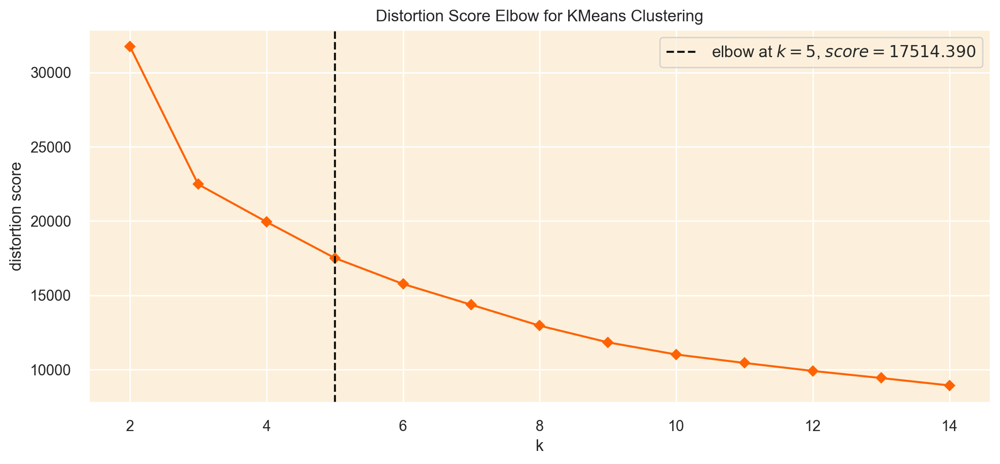

In [ ]:
# # Set plot style, and background color
# sns.set(style='darkgrid', rc={'axes.facecolor': '#fcf0dc'})

# # Set the color palette for the plot
# sns.set_palette(['#ff6200'])

# # Instantiate the clustering model with the specified parameters
# km = KMeans(init='k-means++', n_init=10, max_iter=100, random_state=42)

# # Create a figure and axis with the desired size
# fig, ax = plt.subplots(figsize=(12, 5))

# # Instantiate the KElbowVisualizer with the model and range of k values, and disable the timing plot
# visualizer = KElbowVisualizer(km, k=(2, 15), timings=False, ax=ax)

# # Fit the data to the visualizer
# visualizer.fit(customer_data_pca)

# # Finalize and render the figure
# visualizer.show();

# 5.2.2 Silhouette Method(Kmeans)

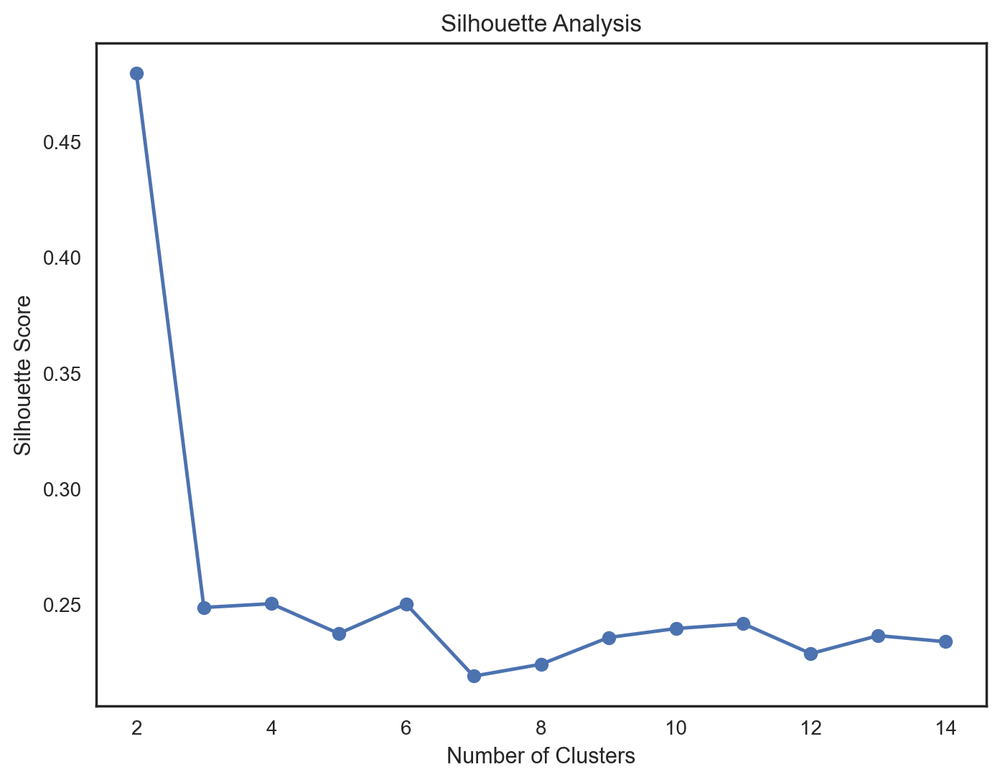

In [56]:
# Silhouette Method
optimal_clusters_analysis(X_pca, method="silhouette", model_type="kmeans")

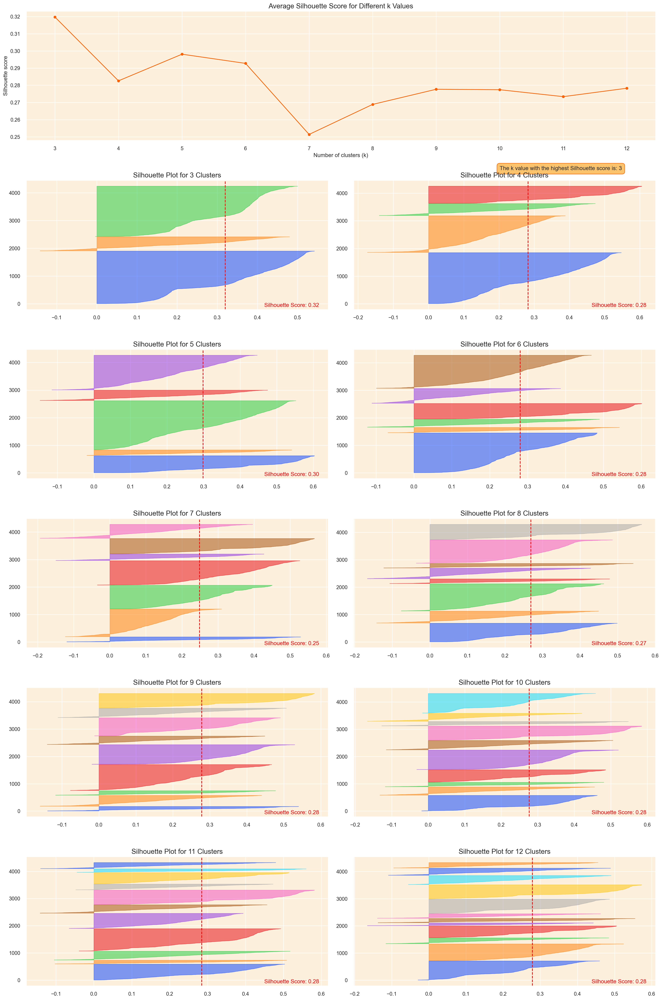

In [ ]:
# def silhouette_analysis(df, start_k, stop_k, figsize=(15, 16)):
#     """
#     Perform Silhouette analysis for a range of k values and visualize the results.
#     """

#     # Set the size of the figure
#     plt.figure(figsize=figsize)

#     # Create a grid with (stop_k - start_k + 1) rows and 2 columns
#     grid = gridspec.GridSpec(stop_k - start_k + 1, 2)

#     # Assign the first plot to the first row and both columns
#     first_plot = plt.subplot(grid[0, :])

#     # First plot: Silhouette scores for different k values
#     sns.set_palette(['darkorange'])

#     silhouette_scores = []

#     # Iterate through the range of k values
#     for k in range(start_k, stop_k + 1):
#         km = KMeans(n_clusters=k, init='k-means++', n_init=10, max_iter=100, random_state=42)
#         km.fit(df)
#         labels = km.predict(df)
#         score = silhouette_score(df, labels)
#         silhouette_scores.append(score)

#     best_k = start_k + silhouette_scores.index(max(silhouette_scores))

#     plt.plot(range(start_k, stop_k + 1), silhouette_scores, marker='o')
#     plt.xticks(range(start_k, stop_k + 1))
#     plt.xlabel('Number of clusters (k)')
#     plt.ylabel('Silhouette score')
#     plt.title('Average Silhouette Score for Different k Values', fontsize=15)

#     # Add the optimal k value text to the plot
#     optimal_k_text = f'The k value with the highest Silhouette score is: {best_k}'
#     plt.text(10, 0.23, optimal_k_text, fontsize=12, verticalalignment='bottom',
#              horizontalalignment='left', bbox=dict(facecolor='#fcc36d', edgecolor='#ff6200', boxstyle='round, pad=0.5'))


#     # Second plot (subplot): Silhouette plots for each k value
#     colors = sns.color_palette("bright")

#     for i in range(start_k, stop_k + 1):
#         km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=0)
#         row_idx, col_idx = divmod(i - start_k, 2)

#         # Assign the plots to the second, third, and fourth rows
#         ax = plt.subplot(grid[row_idx + 1, col_idx])

#         visualizer = SilhouetteVisualizer(km, colors=colors, ax=ax)
#         visualizer.fit(df)

#         # Add the Silhouette score text to the plot
#         score = silhouette_score(df, km.labels_)
#         ax.text(0.97, 0.02, f'Silhouette Score: {score:.2f}', fontsize=12, \
#                 ha='right', transform=ax.transAxes, color='red')

#         ax.set_title(f'Silhouette Plot for {i} Clusters', fontsize=15)

#     plt.tight_layout()
#     plt.show()
# silhouette_analysis(customer_data_pca, 3, 12, figsize=(20, 50))

# comment:

Both the Elbow Method and the Silhouette Score suggest that 3 clusters is the most optimal number. Inertia starts to plateau at 3 clusters, and the Silhouette Score is highest for this configuration, indicating well-separated and stable clusters. Therefore, 3 clusters should be chosen for the optimal customer segmentation.

# 5.2 Hyperparameter tunning for the best model to use

# 5.2.1  PCA for Dimensionality Reduction + KMeans Clustering


--- Clustering for 3 Clusters ---

Cluster Sizes for KMEANS with 3 Clusters:
   Size
0   499
1  1099
2  2730


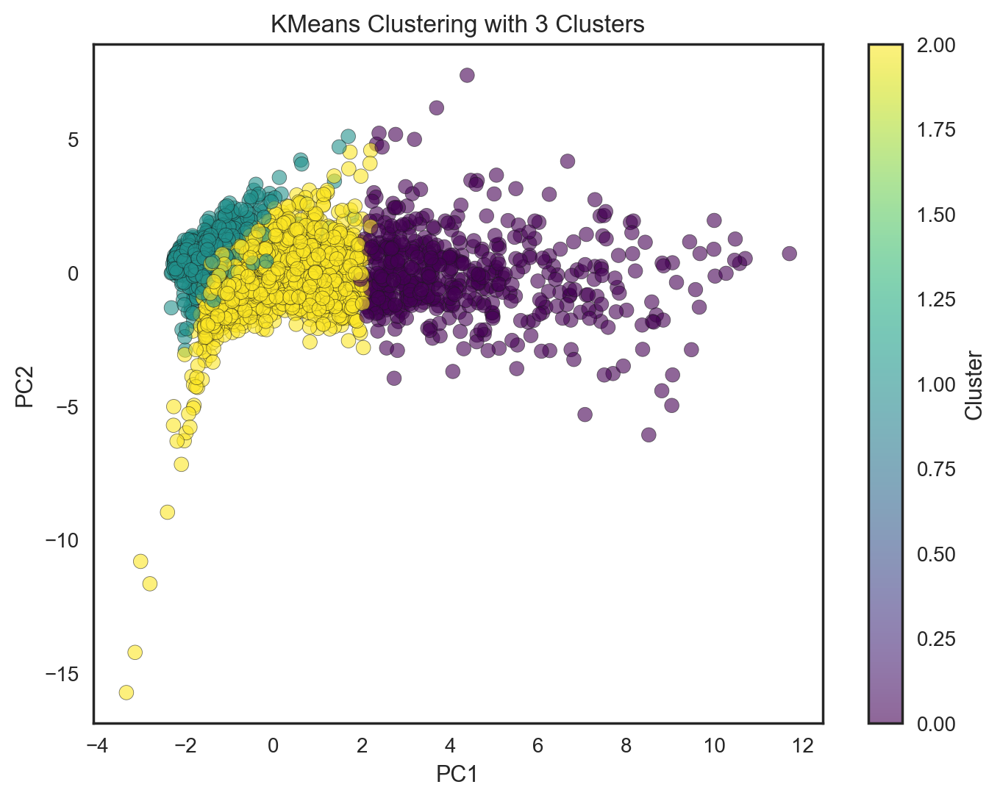

Silhouette Score: 0.25

Cluster Sizes for GMM with 3 Clusters:
   Size
0  1646
1  1234
2  1448


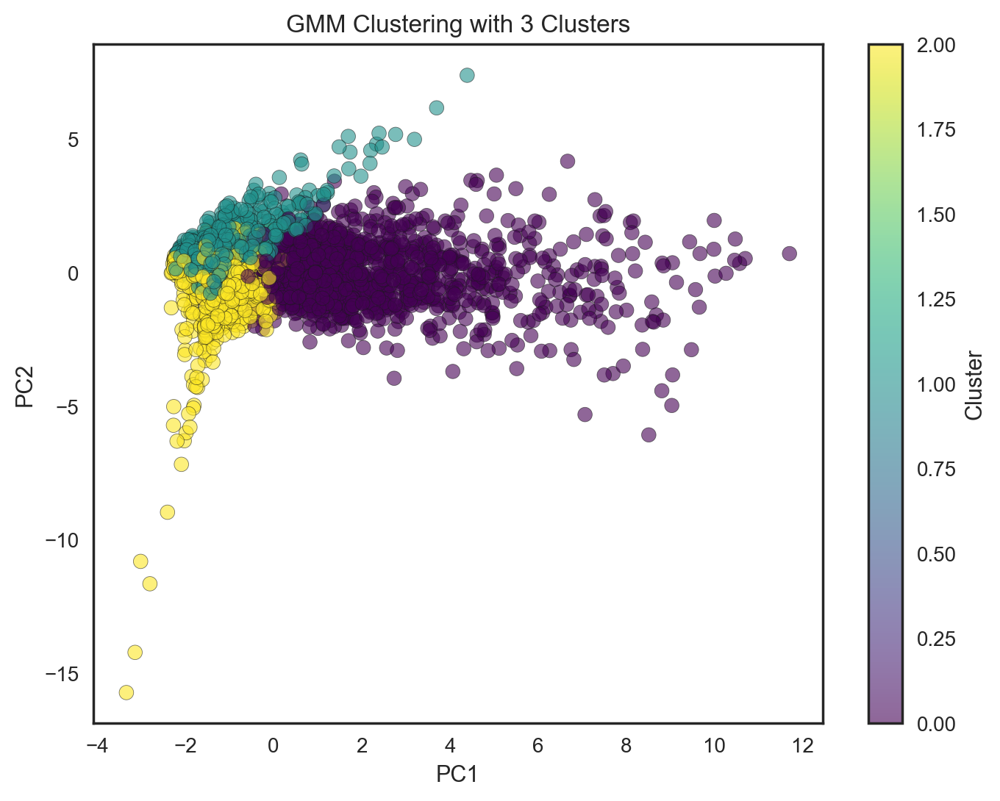

Silhouette Score: 0.07

Cluster Sizes for HIERARCHY with 3 Clusters:
   Size
1   218
2  1082
3  3028


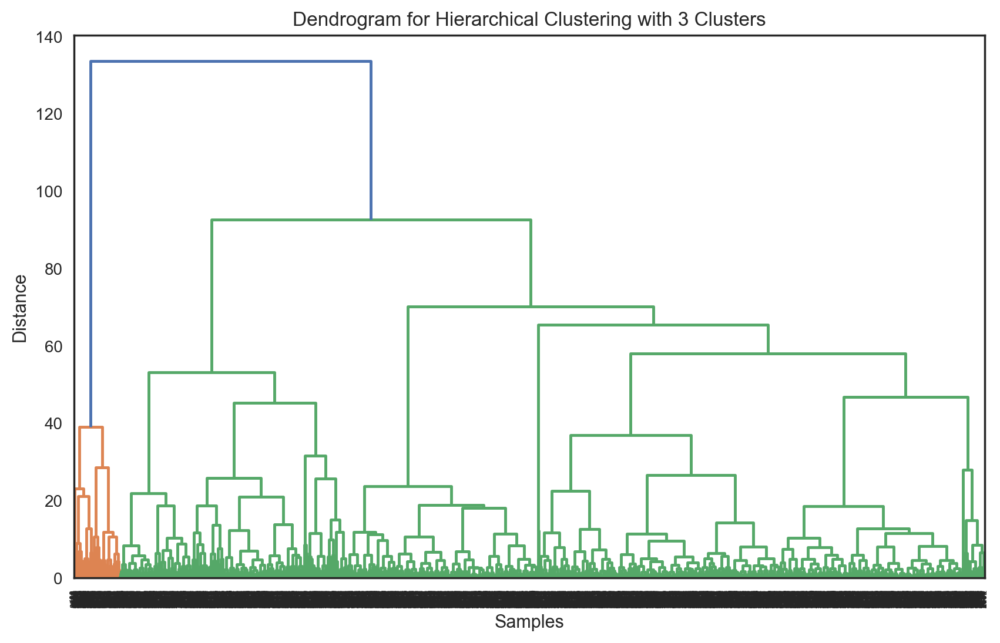

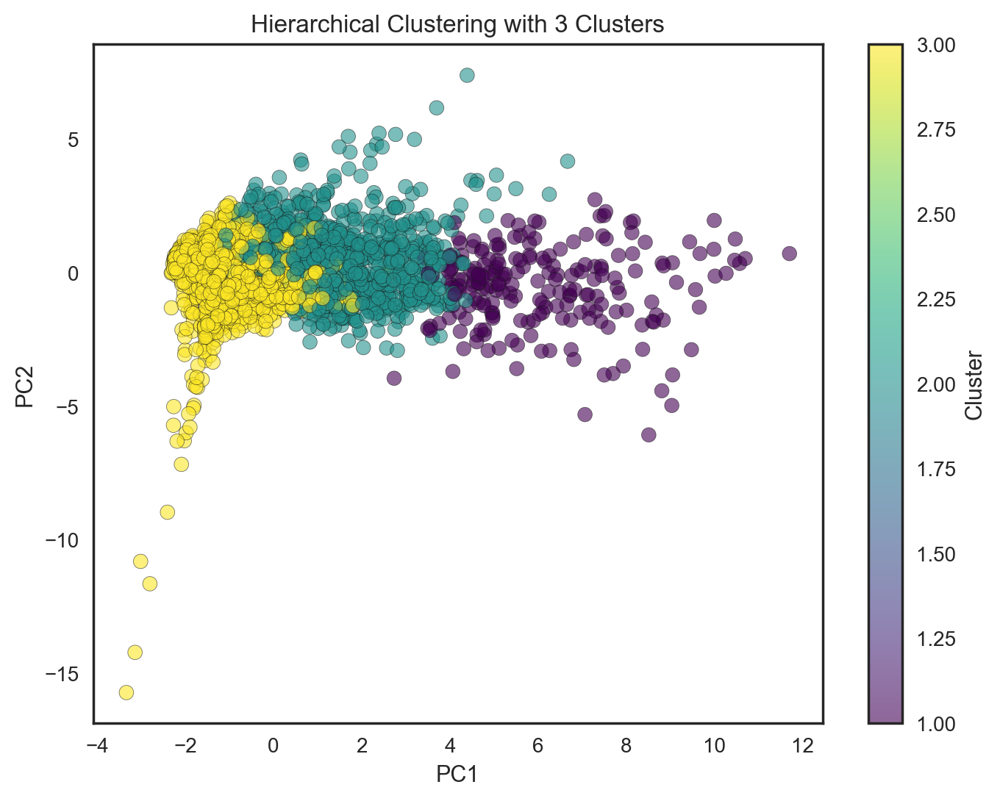

Silhouette Score: 0.25

Cluster Sizes for AGGLOMERATIVE with 3 Clusters:
   Size
0  3028
1   218
2  1082


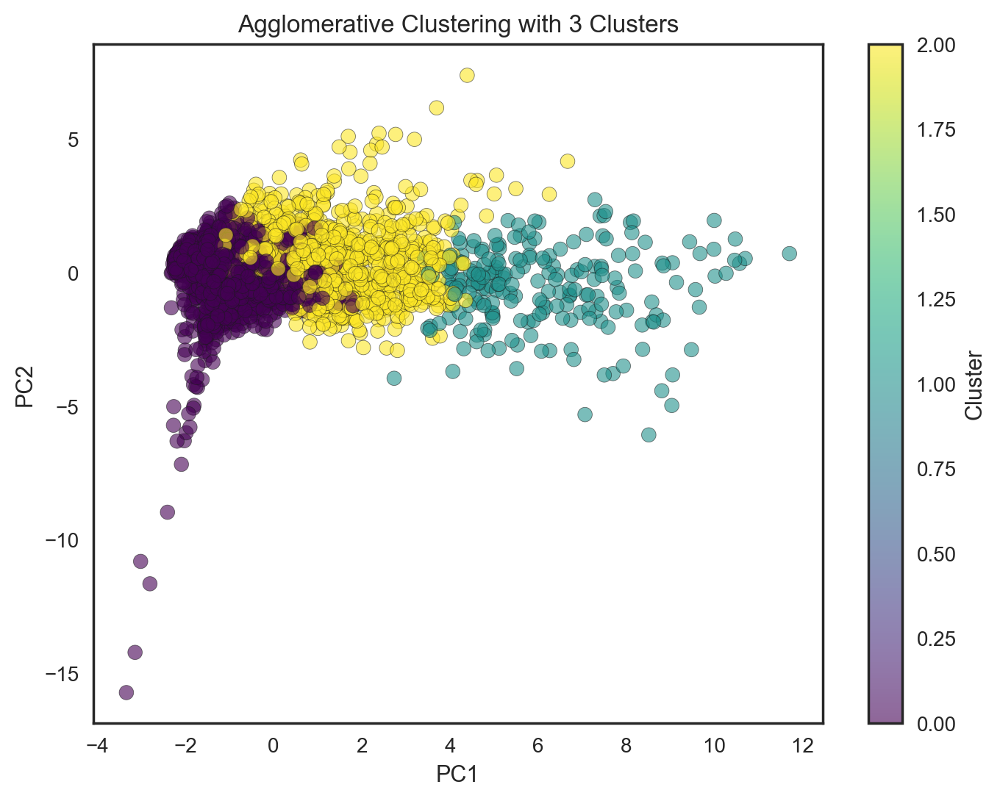

Silhouette Score: 0.25

--- Clustering for 4 Clusters ---

Cluster Sizes for KMEANS with 4 Clusters:
   Size
0   909
1  1014
2  2171
3   234


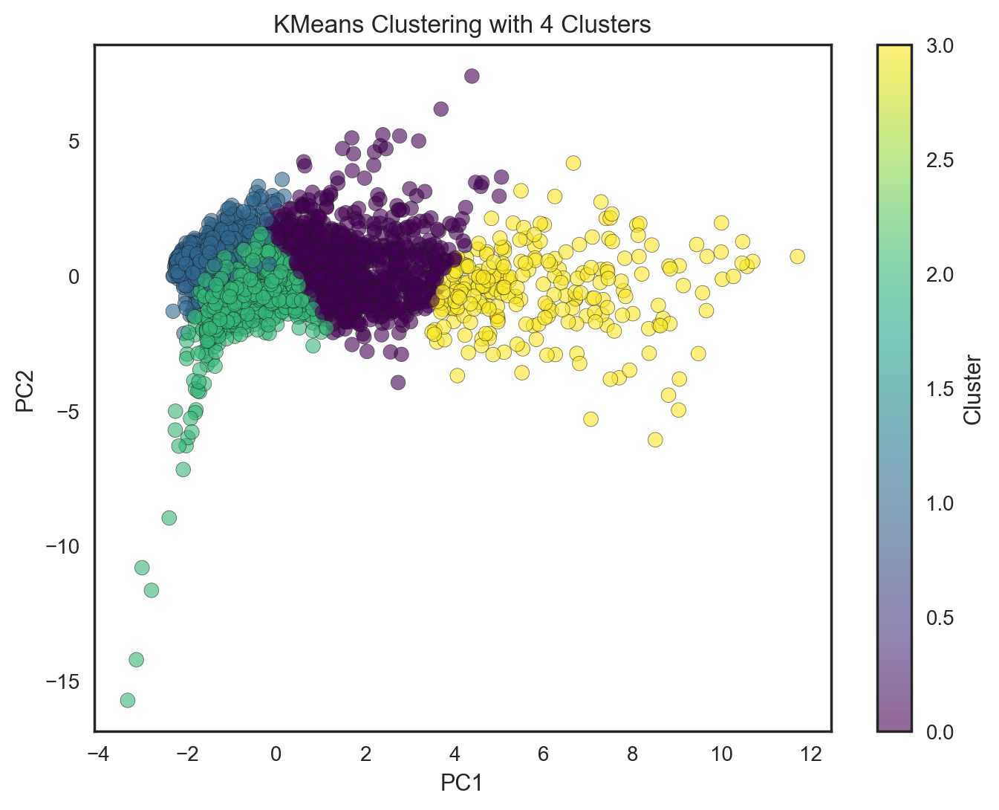

Silhouette Score: 0.25

Cluster Sizes for GMM with 4 Clusters:
   Size
0  1607
1  1234
2   880
3   607


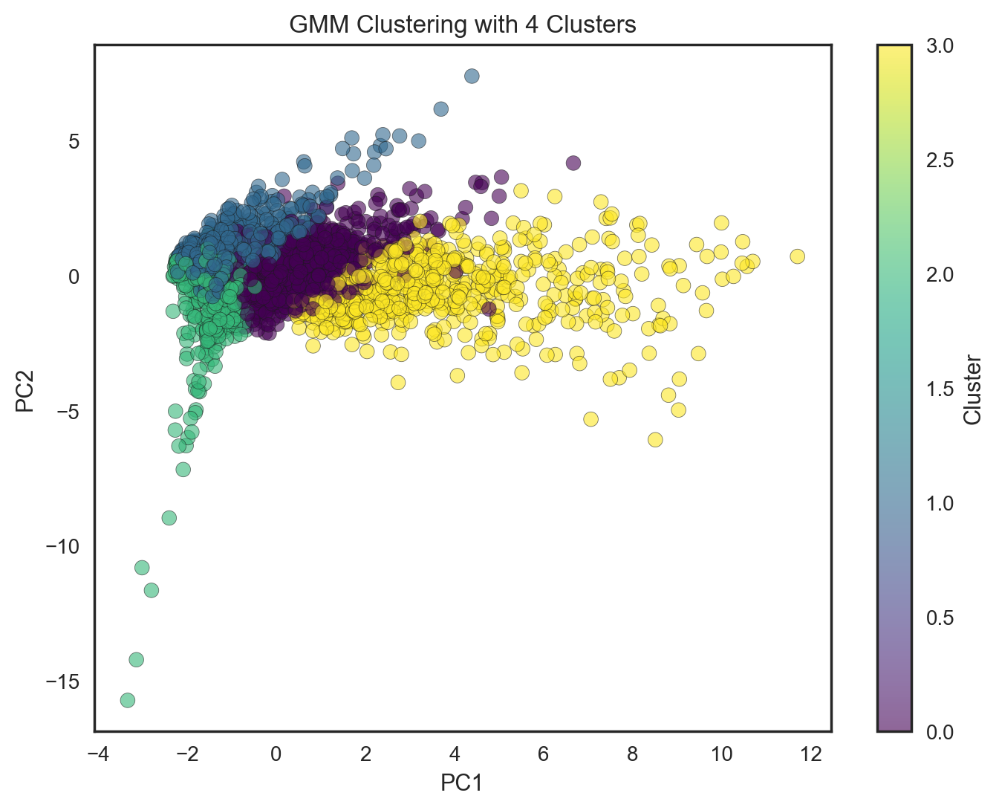

Silhouette Score: 0.09

Cluster Sizes for HIERARCHY with 4 Clusters:
   Size
1   218
2  1082
3   904
4  2124


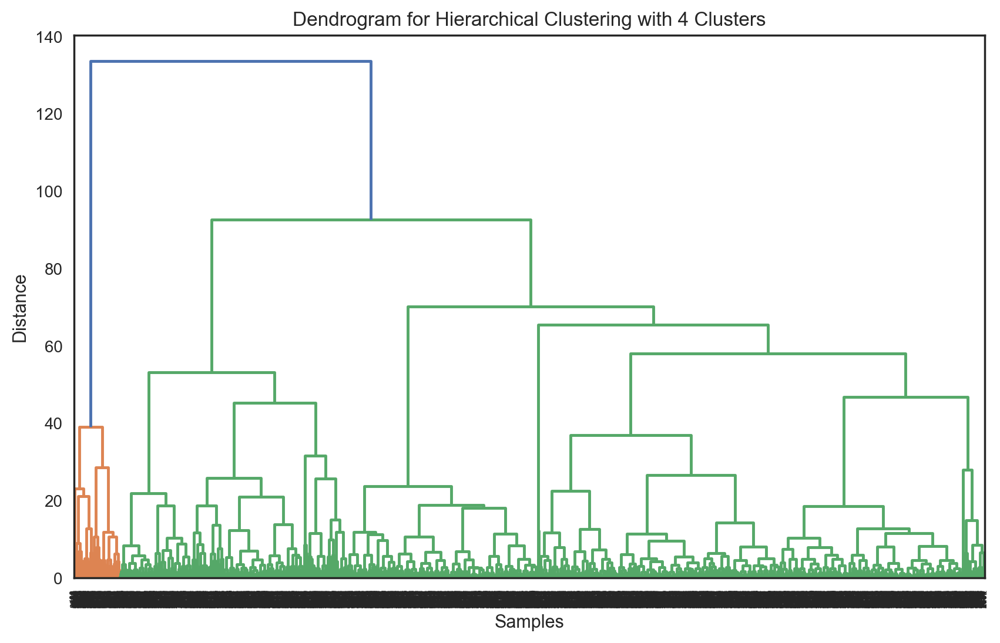

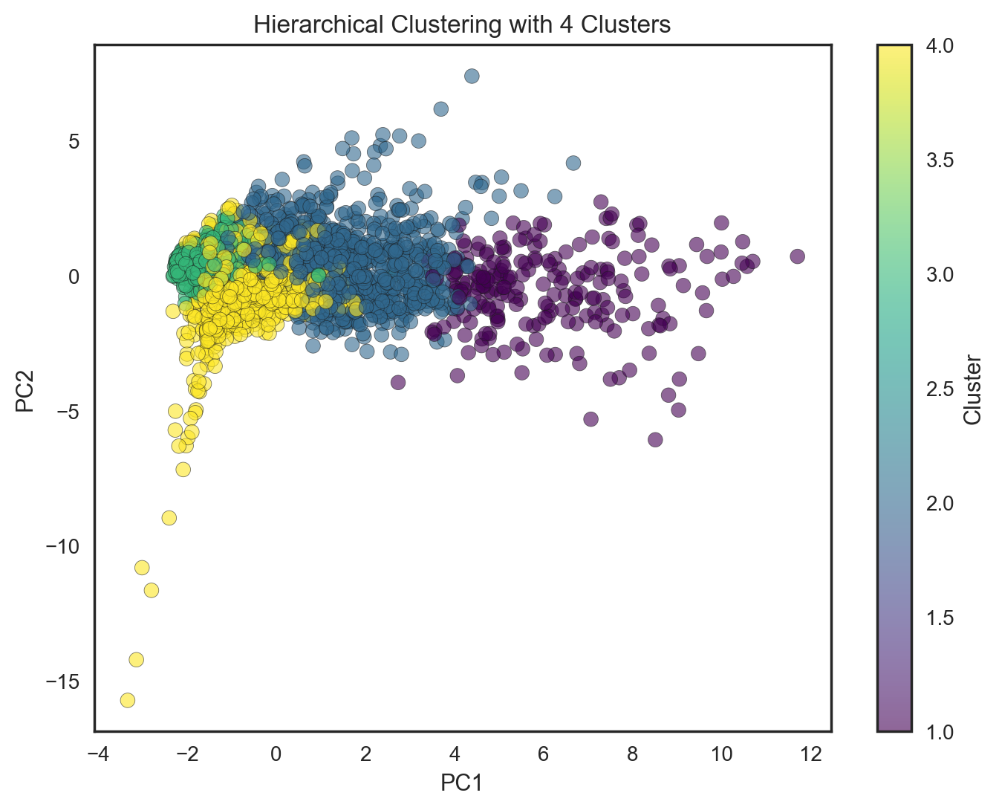

Silhouette Score: 0.19

Cluster Sizes for AGGLOMERATIVE with 4 Clusters:
   Size
0  2124
1   218
2  1082
3   904


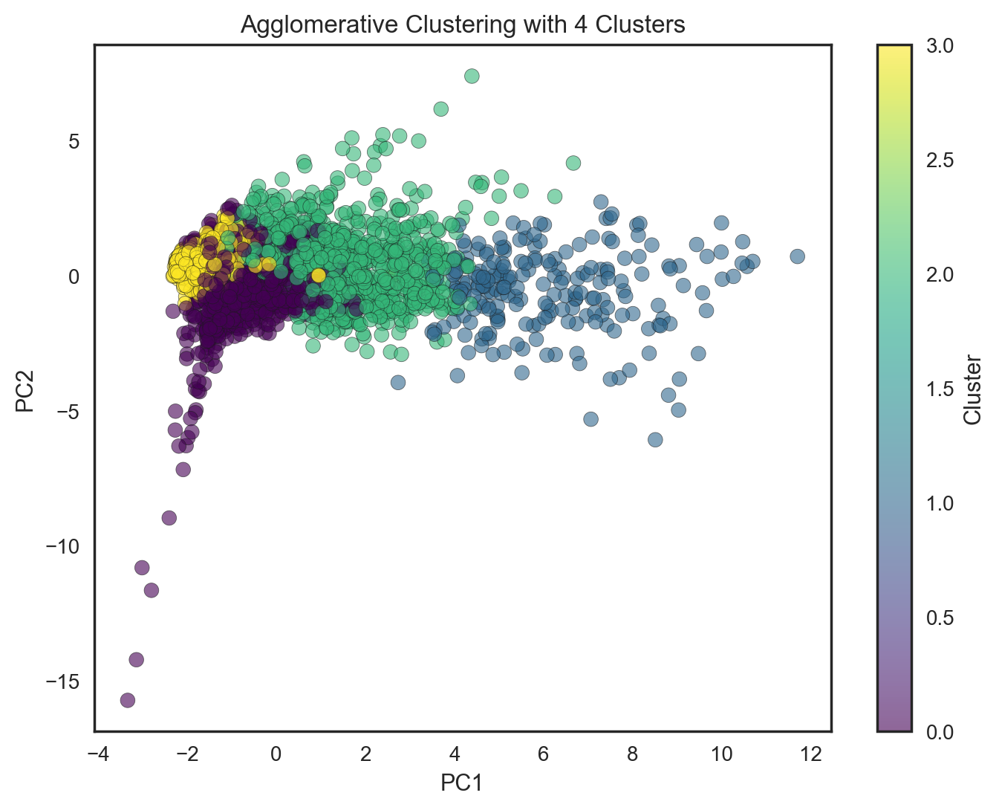

Silhouette Score: 0.19


In [58]:
# Define function

def clustering_pipeline(X, model_type, n_clusters):
    """
    Applies clustering using the specified model and number of clusters.
    Returns cluster labels and model.
    """
    if model_type == "kmeans":
        model = KMeans(n_clusters=n_clusters, random_state=42)
        labels = model.fit_predict(X)
    elif model_type == "gmm":
        model = GaussianMixture(n_components=n_clusters, random_state=42)
        labels = model.fit_predict(X)
    elif model_type == "hierarchy":
        Z = linkage(X, method='ward')
        labels = fcluster(Z, t=n_clusters, criterion='maxclust')
        model = Z  # Store the linkage matrix for dendrogram
    elif model_type == "agglomerative":
        model = AgglomerativeClustering(n_clusters=n_clusters)
        labels = model.fit_predict(X)
    else:
        raise ValueError("Invalid model type. Use 'kmeans', 'gmm', 'hierarchy', or 'agglomerative'.")
    
    return labels, model

def evaluate_clustering(X, labels, method="silhouette"):
    """
    Evaluates clustering performance using the specified method.
    """
    if method == "silhouette":
        score = silhouette_score(X, labels)
        print(f"Silhouette Score: {score:.2f}")
    return score

def plot_clusters(X, labels, title):
    """
    Generates scatterplots for clusters.
    """
    plt.figure(figsize=(8, 6))
    plt.scatter(X[:, 0], X[:, 1], c=labels, cmap='viridis', s=50, alpha=0.6, edgecolors='k')
    plt.title(title)
    plt.xlabel('PC1')
    plt.ylabel('PC2')
    plt.colorbar(label='Cluster')
    plt.show()

def display_cluster_sizes(labels, model_type, n_clusters):
    """
    Displays cluster sizes as a table.
    """
    cluster_sizes = pd.Series(labels).value_counts().sort_index()
    print(f"\nCluster Sizes for {model_type.upper()} with {n_clusters} Clusters:")
    print(cluster_sizes.to_frame('Size'))

def plot_dendrogram(Z, title):
    """
    Plots the dendrogram for Hierarchical Clustering.
    """
    plt.figure(figsize=(10, 6))
    dendrogram(Z)
    plt.title(title)
    plt.xlabel('Samples')
    plt.ylabel('Distance')
    plt.show()

# Apply clustering for both 3 and 4 clusters
for n_clusters in [3, 4]:
    print(f"\n--- Clustering for {n_clusters} Clusters ---")
    
    # KMeans
    kmeans_labels, _ = clustering_pipeline(X_pca, "kmeans", n_clusters)
    display_cluster_sizes(kmeans_labels, "kmeans", n_clusters)
    plot_clusters(X_pca, kmeans_labels, f"KMeans Clustering with {n_clusters} Clusters")
    evaluate_clustering(X_pca, kmeans_labels)
    
    # GMM
    gmm_labels, _ = clustering_pipeline(X_pca, "gmm", n_clusters)
    display_cluster_sizes(gmm_labels, "gmm", n_clusters)
    plot_clusters(X_pca, gmm_labels, f"GMM Clustering with {n_clusters} Clusters")
    evaluate_clustering(X_pca, gmm_labels)
    
    # Hierarchical Clustering
    hc_labels, hc_linkage = clustering_pipeline(X_pca, "hierarchy", n_clusters)
    display_cluster_sizes(hc_labels, "hierarchy", n_clusters)
    plot_dendrogram(hc_linkage, f"Dendrogram for Hierarchical Clustering with {n_clusters} Clusters")
    plot_clusters(X_pca, hc_labels, f"Hierarchical Clustering with {n_clusters} Clusters")
    evaluate_clustering(X_pca, hc_labels)
    
    # Agglomerative Clustering
    ac_labels, _ = clustering_pipeline(X_pca, "agglomerative", n_clusters)
    display_cluster_sizes(ac_labels, "agglomerative", n_clusters)
    plot_clusters(X_pca, ac_labels, f"Agglomerative Clustering with {n_clusters} Clusters")
    evaluate_clustering(X_pca, ac_labels)


In [ ]:
# # Copy the cleaned dataset
# customer_data_cleaned2 = customer_data_cleaned.copy()

Kmeans Cluster Sizes Table:
   3_Clusters  4_Clusters
0       363.0         519
1      3245.0        1909
2       605.0         321
3         NaN        1464


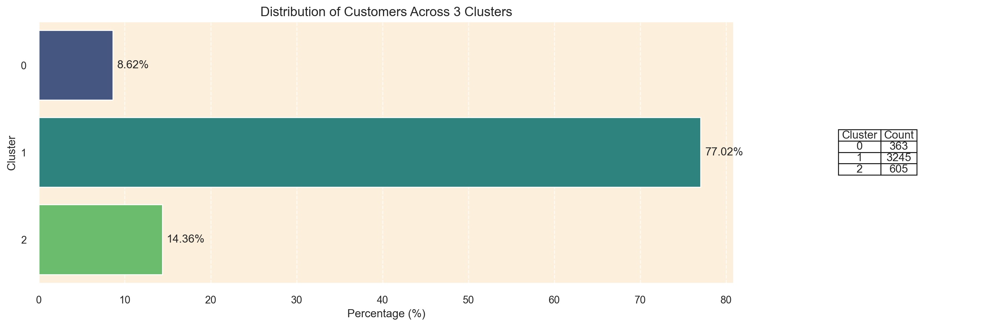

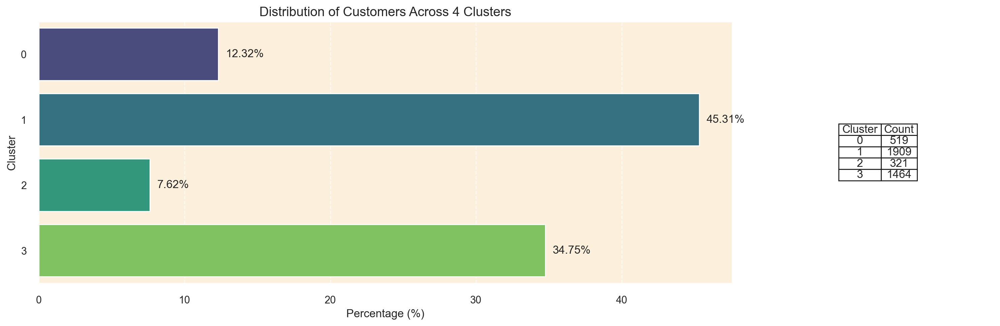

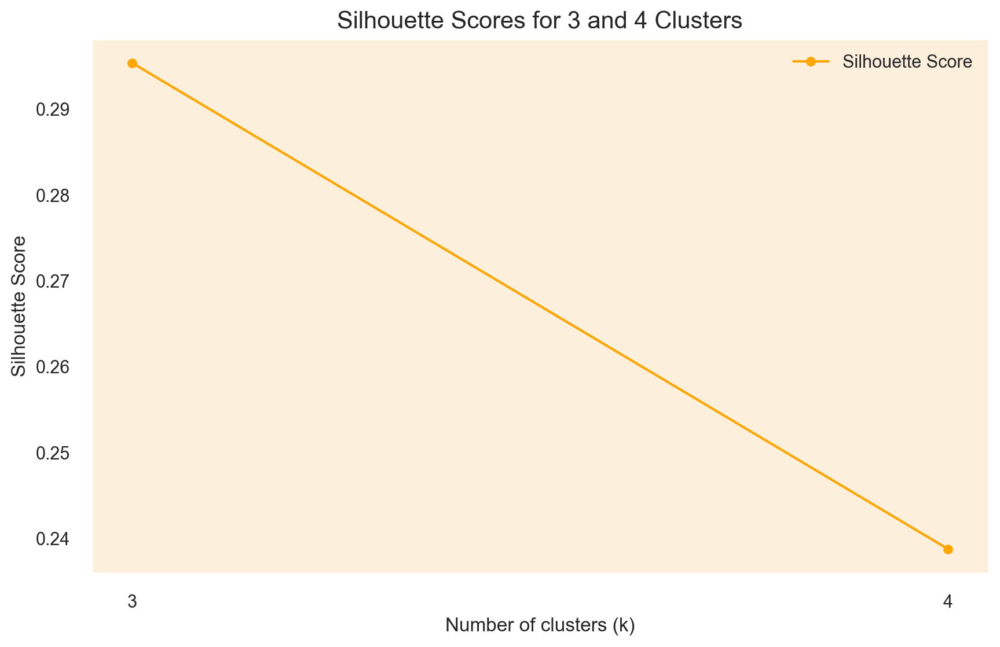

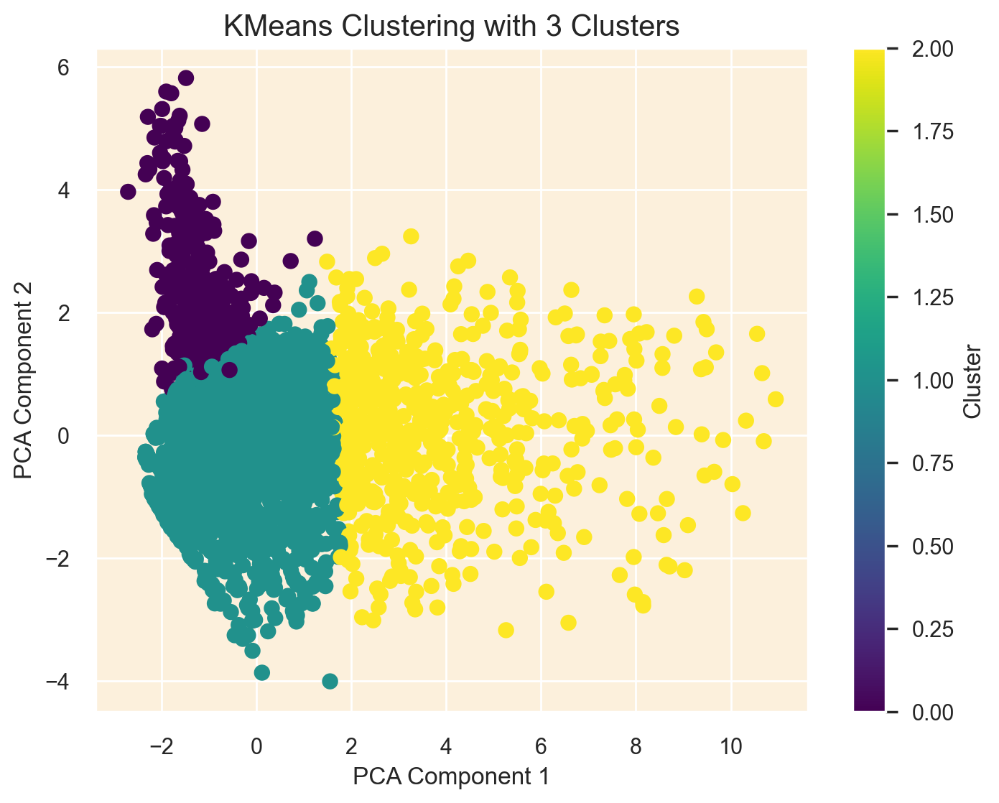

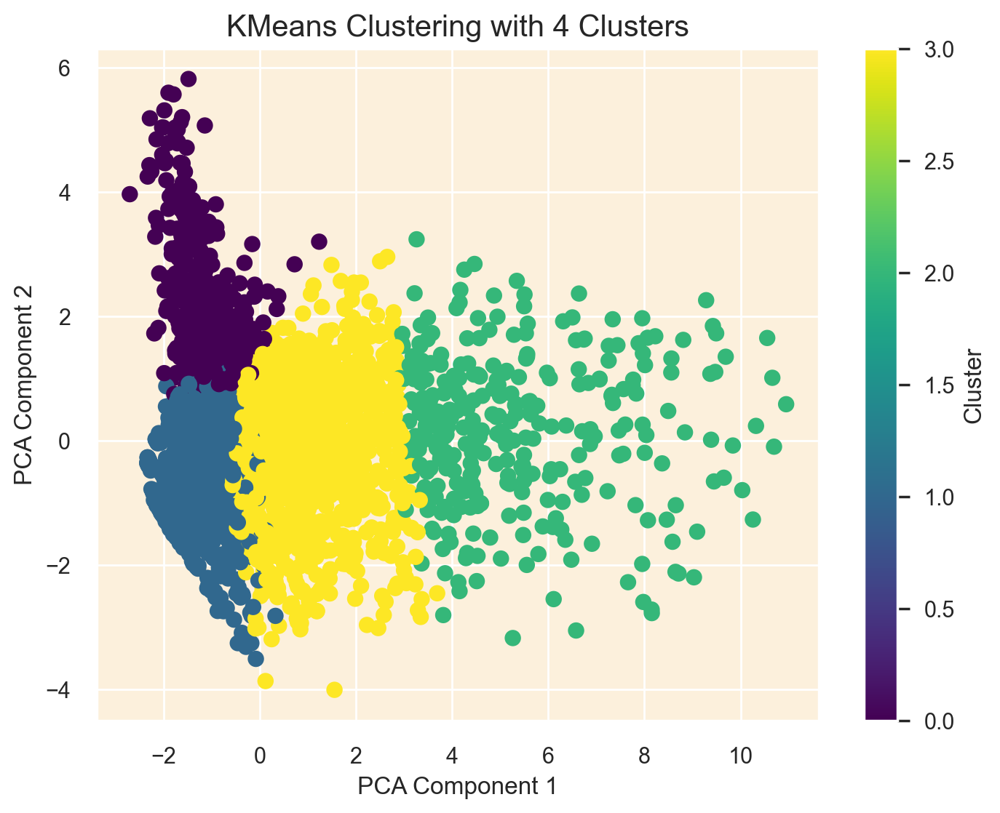

In [ ]:
# # Step 1: Standardize the data
# features = [
#     'Days_Since_Last_Purchase',
#     'Transaction_Count',
#     'Total_Products',
#     'Total_Expenditure',
#     'Avg_Transaction_Value',
#     'Product_Diversity',
#     'Avg_Days_Between_Purchases',
#     'Preferred_Shopping_Day'
# ]
# X = customer_data_cleaned2[features]
# scaler = StandardScaler()
# X_scaled = scaler.fit_transform(X)

# # Step 2: PCA for Dimensionality Reduction
# pca = PCA(n_components=6)
# X_pca = pca.fit_transform(X_scaled)

# # Step 3: Perform KMeans Clustering for 3 and 4 clusters
# cluster_results = {}
# for n_clusters in [3, 4]:
#     kmeans = KMeans(n_clusters=n_clusters, random_state=42)
#     labels = kmeans.fit_predict(X_pca)
#     customer_data_cleaned2[f'Cluster_{n_clusters}'] = labels
#     cluster_results[n_clusters] = pd.Series(labels).value_counts()

# # Create a cluster size table
# cluster_sizes_kmeans = pd.DataFrame(cluster_results)
# cluster_sizes_kmeans.columns = [f"{n}_Clusters" for n in [3, 4]]
# print("Kmeans Cluster Sizes Table:")
# print(cluster_sizes_kmeans)

# # Step 4: Plot Cluster Percentages and Sizes
# for n_clusters in [3, 4]:
#     # Cluster percentages
#     cluster_percentage = (
#         customer_data_cleaned2[f'Cluster_{n_clusters}']
#         .value_counts(normalize=True) * 100
#     ).reset_index()
#     cluster_percentage.columns = ['Cluster', 'Percentage']
#     cluster_percentage.sort_values(by='Cluster', inplace=True)

#     # Cluster sizes
#     cluster_size = (
#         customer_data_cleaned2[f'Cluster_{n_clusters}']
#         .value_counts()
#         .reset_index()
#     )
#     cluster_size.columns = ['Cluster', 'Count']
#     cluster_size.sort_values(by='Cluster', inplace=True)

#     # Plot
#     fig, axes = plt.subplots(1, 2, figsize=(15, 5), gridspec_kw={'width_ratios': [3, 1]})

#     # Bar chart for percentages
#     sns.barplot(
#         x='Percentage',
#         y='Cluster',
#         data=cluster_percentage,
#         orient='h',
#         palette='viridis',
#         ax=axes[0]
#     )
#     for index, value in enumerate(cluster_percentage['Percentage']):
#         axes[0].text(value + 0.5, index, f'{value:.2f}%', va='center')
#     axes[0].set_title(f'Distribution of Customers Across {n_clusters} Clusters', fontsize=14)
#     axes[0].set_xlabel('Percentage (%)')
#     axes[0].set_ylabel('Cluster')
#     axes[0].grid(axis='x', linestyle='--', alpha=0.7)

#     # Table for cluster sizes
#     axes[1].axis('tight')
#     axes[1].axis('off')
#     table = axes[1].table(
#         cellText=cluster_size.values,
#         colLabels=cluster_size.columns,
#         loc='center',
#         cellLoc='center',
#     )
#     table.auto_set_font_size(False)
#     table.set_fontsize(12)
#     table.auto_set_column_width([0, 1])

#     plt.tight_layout()
#     plt.show()

# # Step 5: Compute and Plot Silhouette Scores
# silhouette_scores = []
# range_n_clusters = [3, 4]
# for n_clusters in range_n_clusters:
#     kmeans = KMeans(n_clusters=n_clusters, random_state=42)
#     kmeans.fit(X_pca)
#     silhouette_scores.append(silhouette_score(X_pca, kmeans.labels_))

# plt.figure(figsize=(10, 6))
# plt.plot(range_n_clusters, silhouette_scores, marker='o', color='orange', label='Silhouette Score')
# plt.title('Silhouette Scores for 3 and 4 Clusters', fontsize=15)
# plt.xlabel('Number of clusters (k)')
# plt.ylabel('Silhouette Score')
# plt.xticks(range_n_clusters)
# plt.legend()
# plt.grid()
# plt.show()

# # Step 6: Scatterplots for Clusters
# for n_clusters in [3, 4]:
#     plt.figure(figsize=(8, 6))
#     plt.scatter(X_pca[:, 0], X_pca[:, 1], c=customer_data_cleaned2[f'Cluster_{n_clusters}'], cmap='viridis', s=50)
#     plt.title(f'KMeans Clustering with {n_clusters} Clusters', fontsize=15)
#     plt.xlabel('PCA Component 1')
#     plt.ylabel('PCA Component 2')
#     plt.colorbar(label='Cluster')
#     plt.show()


# 5.2.2 Hierarchical Clustering

Cluster Sizes Table:
   3_Clusters  4_Clusters
0      2915.0         911
1       295.0        2004
2      1003.0         295
3         NaN        1003


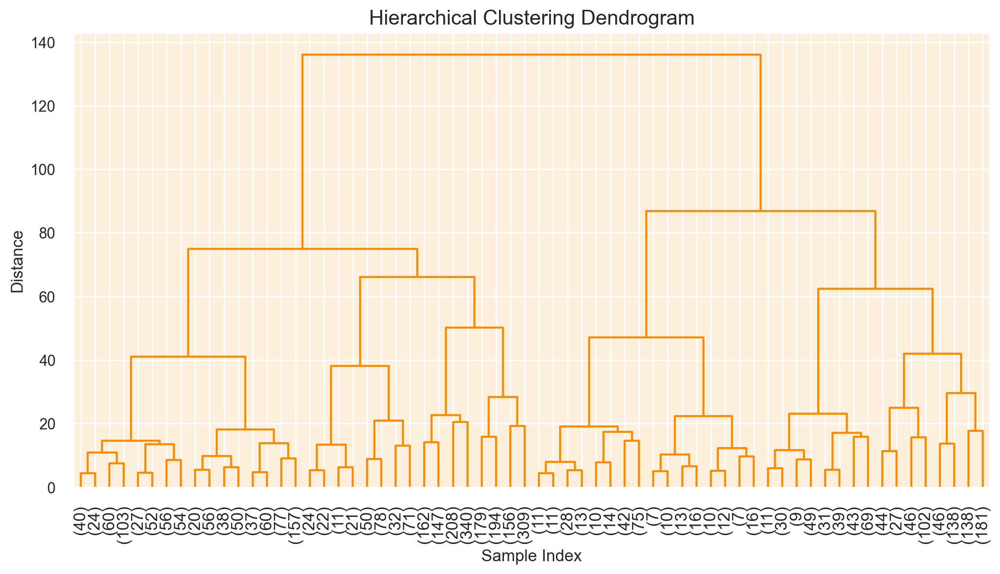

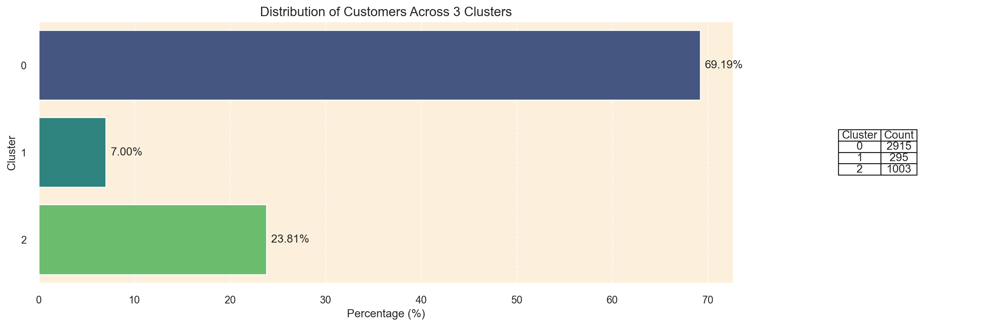

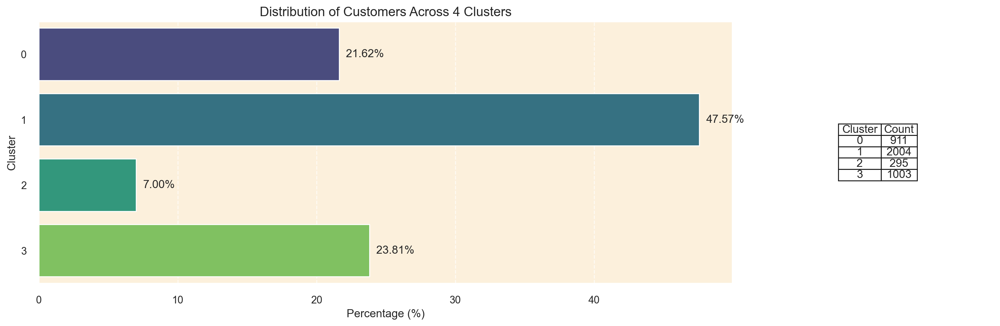

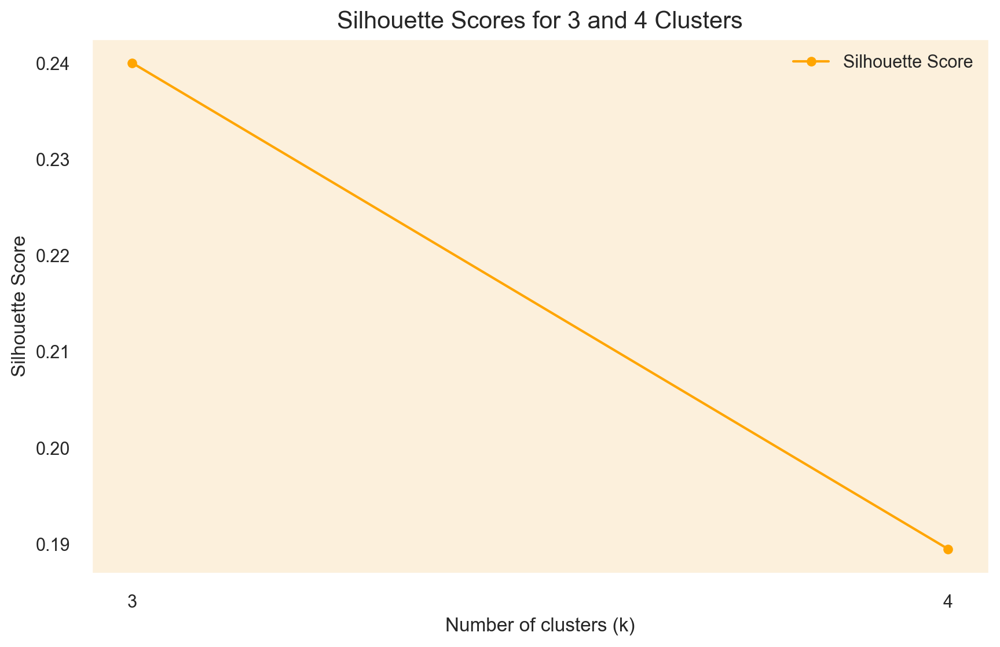

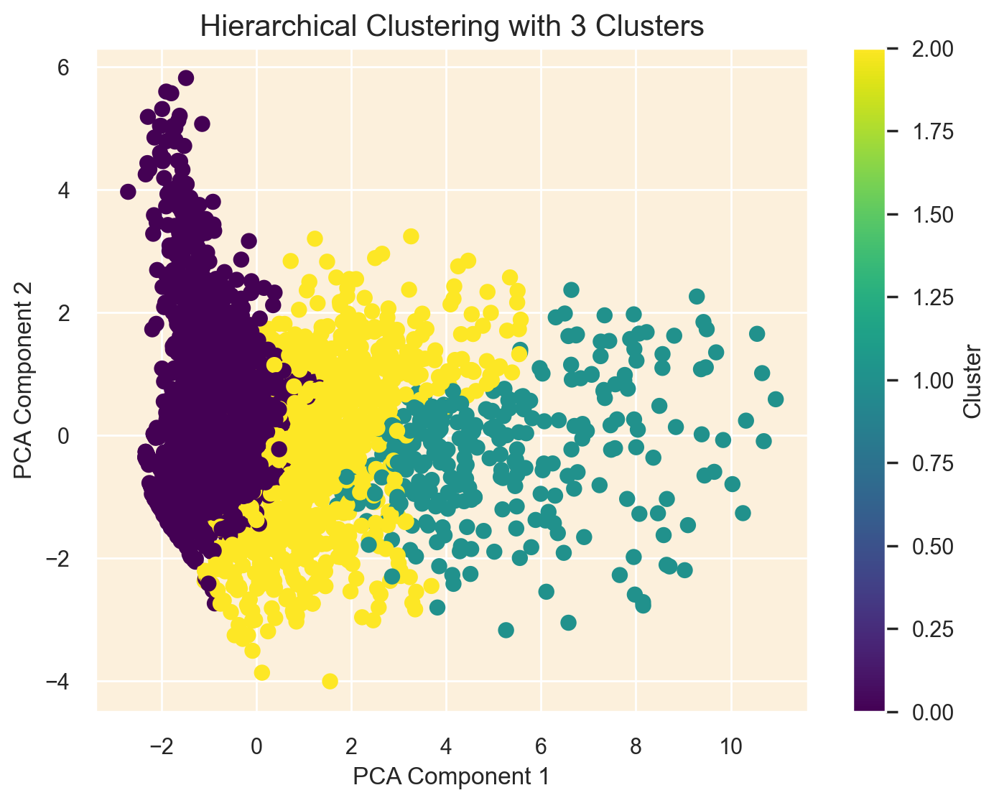

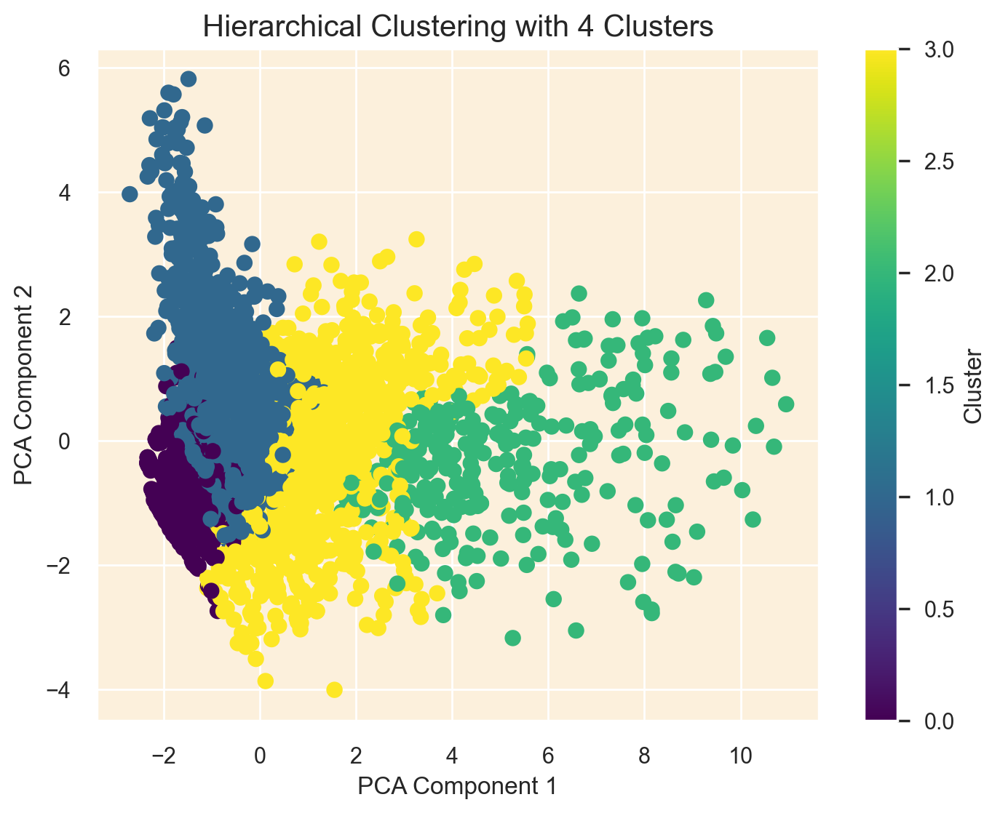

In [ ]:
# # Step 1: Standardize the data
# features = [
#     'Days_Since_Last_Purchase',
#     'Transaction_Count',
#     'Total_Products',
#     'Total_Expenditure',
#     'Avg_Transaction_Value',
#     'Product_Diversity',
#     'Avg_Days_Between_Purchases',
#     'Preferred_Shopping_Day'
# ]
# X = customer_data_cleaned2[features]
# scaler = StandardScaler()
# X_scaled = scaler.fit_transform(X)

# # Step 2: PCA for Dimensionality Reduction
# pca = PCA(n_components=6)
# X_pca = pca.fit_transform(X_scaled)

# # Step 3: Perform Hierarchical Clustering for 3 and 4 clusters
# cluster_results = {}
# linkage_matrix = linkage(X_pca, method='ward')  # Ward linkage for hierarchical clustering

# for n_clusters in [3, 4]:
#     labels = fcluster(linkage_matrix, n_clusters, criterion='maxclust')
#     customer_data_cleaned2[f'Cluster_{n_clusters}'] = labels - 1  # Adjust labels to start from 0
#     cluster_results[n_clusters] = pd.Series(labels - 1).value_counts()

# # Create a cluster size table
# cluster_sizes_hc = pd.DataFrame(cluster_results)
# cluster_sizes_hc.columns = [f"{n}_Clusters" for n in [3, 4]]
# print("Cluster Sizes Table:")
# print(cluster_sizes_hc)

# # Step 4: Plot Dendrogram
# plt.figure(figsize=(12, 6))
# dendrogram(linkage_matrix, truncate_mode='level', p=5, leaf_rotation=90., leaf_font_size=12.)
# plt.title('Hierarchical Clustering Dendrogram', fontsize=15)
# plt.xlabel('Sample Index')
# plt.ylabel('Distance')
# plt.show()

# # Step 5: Plot Cluster Percentages and Sizes
# for n_clusters in [3, 4]:
#     # Cluster percentages
#     cluster_percentage = (
#         customer_data_cleaned2[f'Cluster_{n_clusters}']
#         .value_counts(normalize=True) * 100
#     ).reset_index()
#     cluster_percentage.columns = ['Cluster', 'Percentage']
#     cluster_percentage.sort_values(by='Cluster', inplace=True)

#     # Cluster sizes
#     cluster_size = (
#         customer_data_cleaned2[f'Cluster_{n_clusters}']
#         .value_counts()
#         .reset_index()
#     )
#     cluster_size.columns = ['Cluster', 'Count']
#     cluster_size.sort_values(by='Cluster', inplace=True)

#     # Plot
#     fig, axes = plt.subplots(1, 2, figsize=(15, 5), gridspec_kw={'width_ratios': [3, 1]})

#     # Bar chart for percentages
#     sns.barplot(
#         x='Percentage',
#         y='Cluster',
#         data=cluster_percentage,
#         orient='h',
#         palette='viridis',
#         ax=axes[0]
#     )
#     for index, value in enumerate(cluster_percentage['Percentage']):
#         axes[0].text(value + 0.5, index, f'{value:.2f}%', va='center')
#     axes[0].set_title(f'Distribution of Customers Across {n_clusters} Clusters', fontsize=14)
#     axes[0].set_xlabel('Percentage (%)')
#     axes[0].set_ylabel('Cluster')
#     axes[0].grid(axis='x', linestyle='--', alpha=0.7)

#     # Table for cluster sizes
#     axes[1].axis('tight')
#     axes[1].axis('off')
#     table = axes[1].table(
#         cellText=cluster_size.values,
#         colLabels=cluster_size.columns,
#         loc='center',
#         cellLoc='center',
#     )
#     table.auto_set_font_size(False)
#     table.set_fontsize(12)
#     table.auto_set_column_width([0, 1])

#     plt.tight_layout()
#     plt.show()

# # Step 6: Compute and Plot Silhouette Scores
# silhouette_scores = []
# range_n_clusters = [3, 4]
# for n_clusters in range_n_clusters:
#     labels = fcluster(linkage_matrix, n_clusters, criterion='maxclust') - 1
#     silhouette_scores.append(silhouette_score(X_pca, labels))

# plt.figure(figsize=(10, 6))
# plt.plot(range_n_clusters, silhouette_scores, marker='o', color='orange', label='Silhouette Score')
# plt.title('Silhouette Scores for 3 and 4 Clusters', fontsize=15)
# plt.xlabel('Number of clusters (k)')
# plt.ylabel('Silhouette Score')
# plt.xticks(range_n_clusters)
# plt.legend()
# plt.grid()
# plt.show()

# # Step 7: Scatterplots for Clusters
# for n_clusters in [3, 4]:
#     plt.figure(figsize=(8, 6))
#     plt.scatter(X_pca[:, 0], X_pca[:, 1], c=customer_data_cleaned2[f'Cluster_{n_clusters}'], cmap='viridis', s=50)
#     plt.title(f'Hierarchical Clustering with {n_clusters} Clusters', fontsize=15)
#     plt.xlabel('PCA Component 1')
#     plt.ylabel('PCA Component 2')
#     plt.colorbar(label='Cluster')
#     plt.show()


# 5.2.3 Agglomerative Clustering

Cluster Sizes Table:
   3_Clusters  4_Clusters
0      2915.0        2004
1      1003.0        1003
2       295.0         295
3         NaN         911


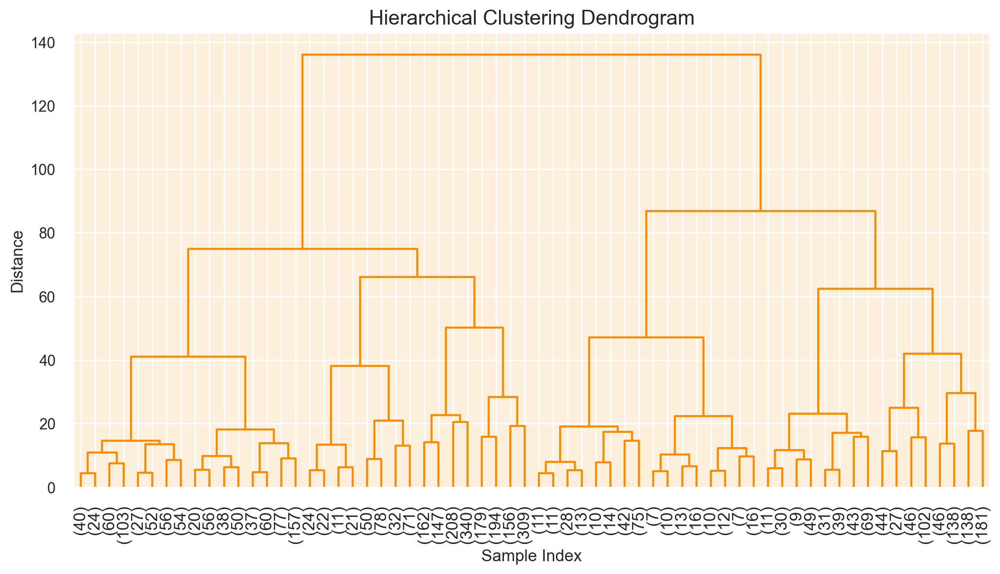

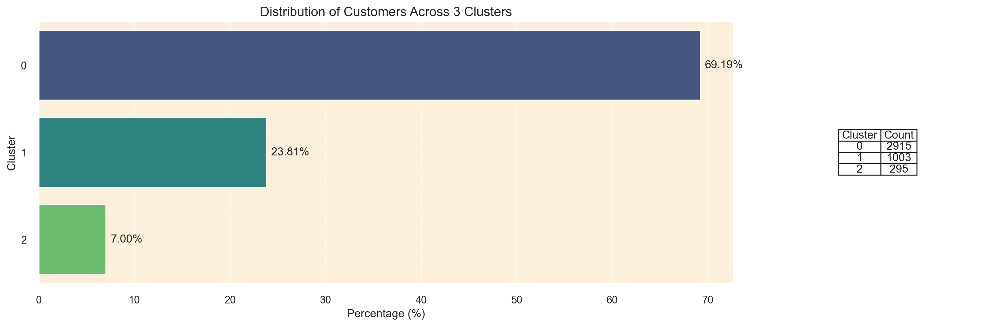

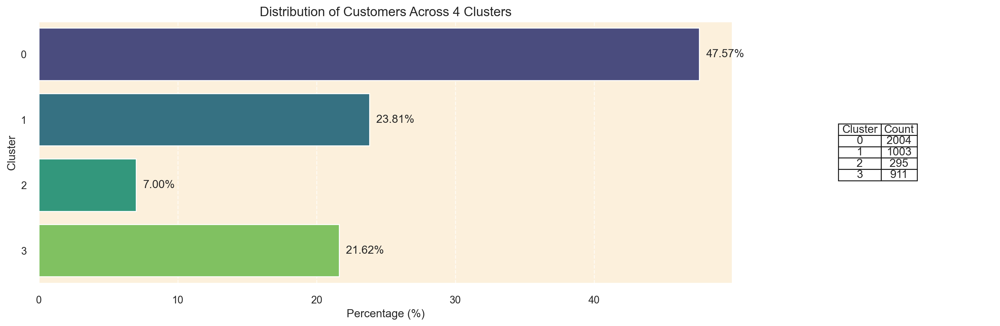

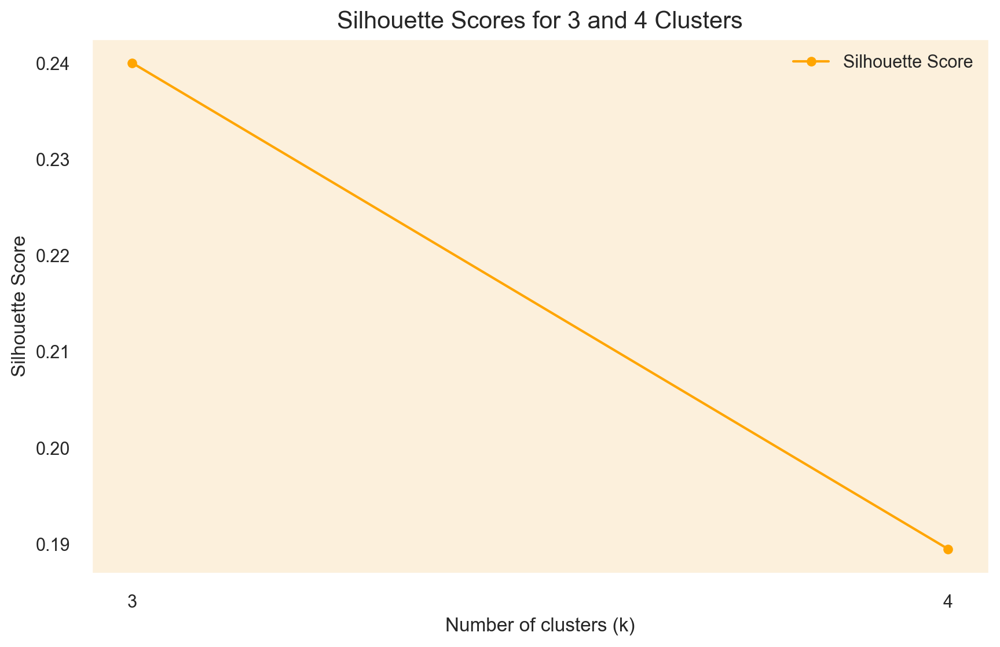

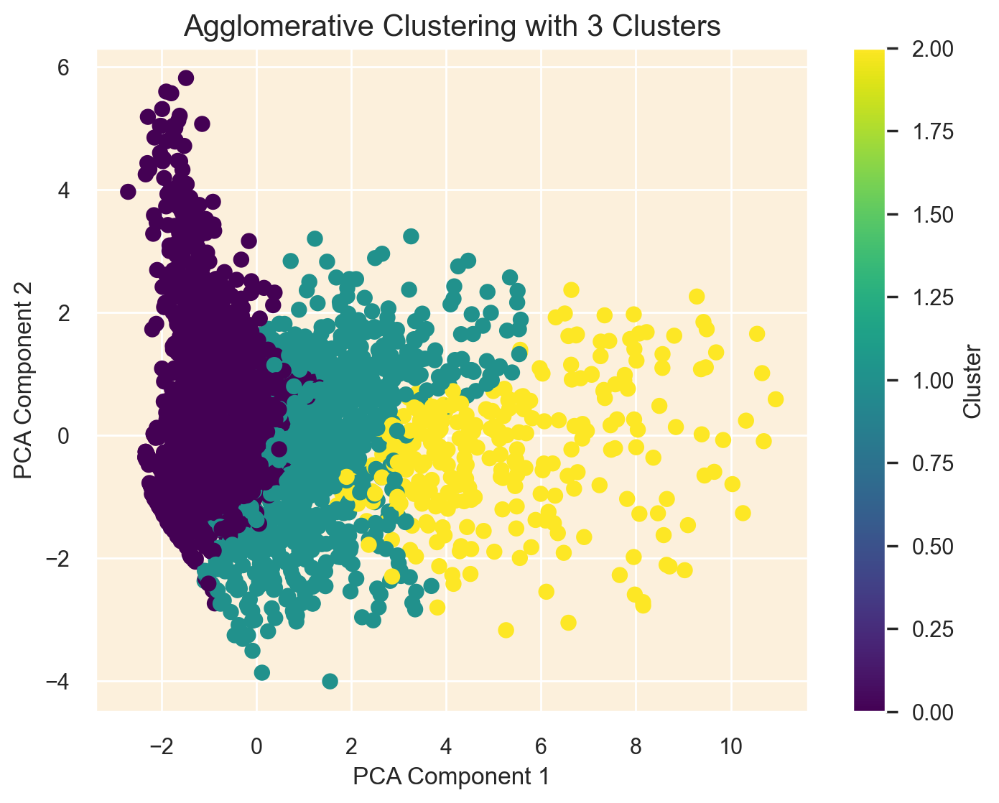

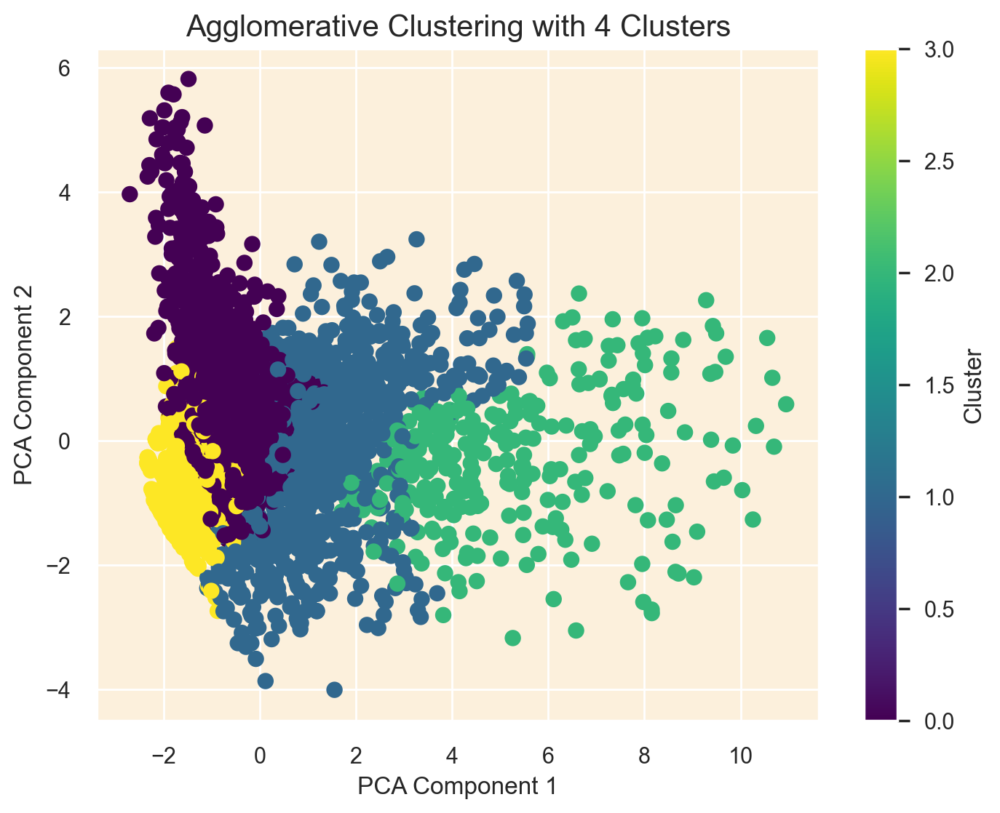

In [ ]:
# # Step 1: Standardize the data
# features = [
#     'Days_Since_Last_Purchase',
#     'Transaction_Count',
#     'Total_Products',
#     'Total_Expenditure',
#     'Avg_Transaction_Value',
#     'Product_Diversity',
#     'Avg_Days_Between_Purchases',
#     'Preferred_Shopping_Day'
# ]
# X = customer_data_cleaned2[features]
# scaler = StandardScaler()
# X_scaled = scaler.fit_transform(X)

# # Step 2: PCA for Dimensionality Reduction
# pca = PCA(n_components=6)
# X_pca = pca.fit_transform(X_scaled)

# # Step 3: Perform Agglomerative Clustering for 3 and 4 clusters
# cluster_results = {}
# linkage_matrix = linkage(X_pca, method='ward')  # Ward linkage for dendrogram

# for n_clusters in [3, 4]:
#     agglomerative = AgglomerativeClustering(n_clusters=n_clusters, metric='euclidean', linkage='ward')
#     labels = agglomerative.fit_predict(X_pca)
#     customer_data_cleaned2[f'Cluster_{n_clusters}'] = labels
#     cluster_results[n_clusters] = pd.Series(labels).value_counts()

# # Create a cluster size table
# cluster_sizes_ac = pd.DataFrame(cluster_results)
# cluster_sizes_ac.columns = [f"{n}_Clusters" for n in [3, 4]]
# print("Cluster Sizes Table:")
# print(cluster_sizes_ac)

# # Step 4: Plot Dendrogram
# plt.figure(figsize=(12, 6))
# dendrogram(linkage_matrix, truncate_mode='level', p=5, leaf_rotation=90., leaf_font_size=12.)
# plt.title('Hierarchical Clustering Dendrogram', fontsize=15)
# plt.xlabel('Sample Index')
# plt.ylabel('Distance')
# plt.show()

# # Step 5: Plot Cluster Percentages and Sizes
# for n_clusters in [3, 4]:
#     # Cluster percentages
#     cluster_percentage = (
#         customer_data_cleaned2[f'Cluster_{n_clusters}']
#         .value_counts(normalize=True) * 100
#     ).reset_index()
#     cluster_percentage.columns = ['Cluster', 'Percentage']
#     cluster_percentage.sort_values(by='Cluster', inplace=True)

#     # Cluster sizes
#     cluster_size = (
#         customer_data_cleaned2[f'Cluster_{n_clusters}']
#         .value_counts()
#         .reset_index()
#     )
#     cluster_size.columns = ['Cluster', 'Count']
#     cluster_size.sort_values(by='Cluster', inplace=True)

#     # Plot
#     fig, axes = plt.subplots(1, 2, figsize=(15, 5), gridspec_kw={'width_ratios': [3, 1]})

#     # Bar chart for percentages
#     sns.barplot(
#         x='Percentage',
#         y='Cluster',
#         data=cluster_percentage,
#         orient='h',
#         palette='viridis',
#         ax=axes[0]
#     )
#     for index, value in enumerate(cluster_percentage['Percentage']):
#         axes[0].text(value + 0.5, index, f'{value:.2f}%', va='center')
#     axes[0].set_title(f'Distribution of Customers Across {n_clusters} Clusters', fontsize=14)
#     axes[0].set_xlabel('Percentage (%)')
#     axes[0].set_ylabel('Cluster')
#     axes[0].grid(axis='x', linestyle='--', alpha=0.7)

#     # Table for cluster sizes
#     axes[1].axis('tight')
#     axes[1].axis('off')
#     table = axes[1].table(
#         cellText=cluster_size.values,
#         colLabels=cluster_size.columns,
#         loc='center',
#         cellLoc='center',
#     )
#     table.auto_set_font_size(False)
#     table.set_fontsize(12)
#     table.auto_set_column_width([0, 1])

#     plt.tight_layout()
#     plt.show()

# # Step 6: Compute and Plot Silhouette Scores
# silhouette_scores = []
# range_n_clusters = [3, 4]
# for n_clusters in range_n_clusters:
#     agglomerative = AgglomerativeClustering(n_clusters=n_clusters, metric='euclidean', linkage='ward')
#     labels = agglomerative.fit_predict(X_pca)
#     silhouette_scores.append(silhouette_score(X_pca, labels))

# plt.figure(figsize=(10, 6))
# plt.plot(range_n_clusters, silhouette_scores, marker='o', color='orange', label='Silhouette Score')
# plt.title('Silhouette Scores for 3 and 4 Clusters', fontsize=15)
# plt.xlabel('Number of clusters (k)')
# plt.ylabel('Silhouette Score')
# plt.xticks(range_n_clusters)
# plt.legend()
# plt.grid()
# plt.show()

# # Step 7: Scatterplots for Clusters
# for n_clusters in [3, 4]:
#     plt.figure(figsize=(8, 6))
#     plt.scatter(X_pca[:, 0], X_pca[:, 1], c=customer_data_cleaned2[f'Cluster_{n_clusters}'], cmap='viridis', s=50)
#     plt.title(f'Agglomerative Clustering with {n_clusters} Clusters', fontsize=15)
#     plt.xlabel('PCA Component 1')
#     plt.ylabel('PCA Component 2')
#     plt.colorbar(label='Cluster')
#     plt.show()


# 5.2. 4 Gaussian Mixture Models (GMM)

Cluster Sizes Table:
   3_Clusters  4_Clusters
0      1617.0        1094
1      1206.0        1206
2      1390.0         650
3         NaN        1263


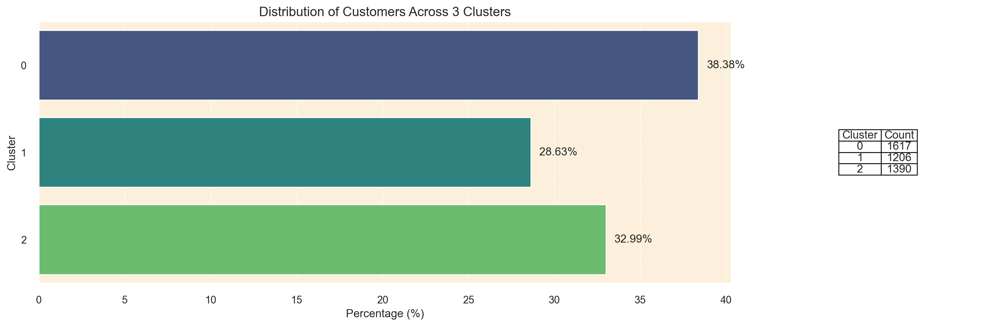

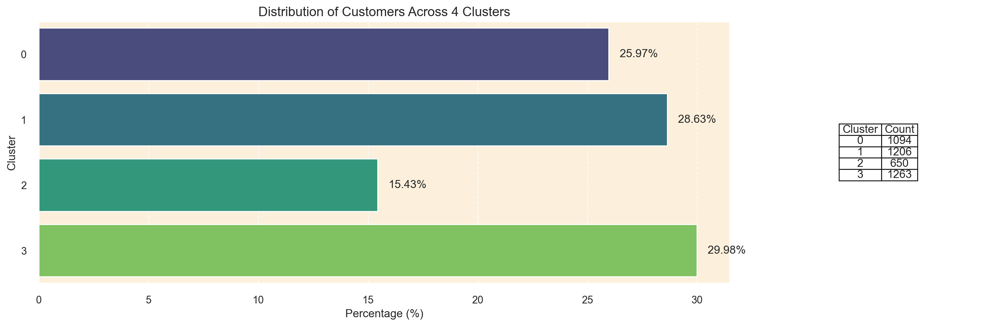

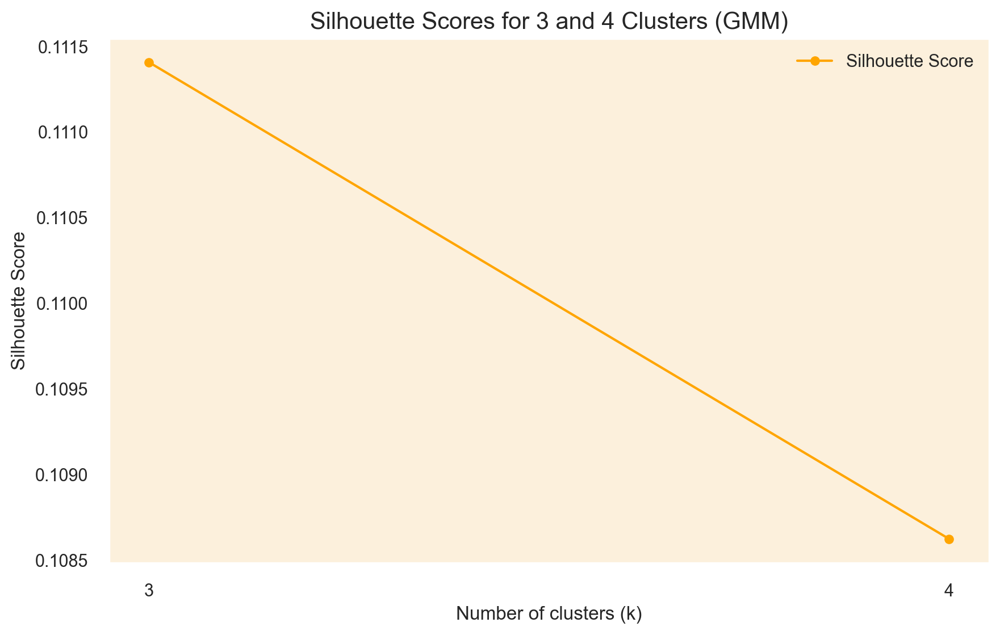

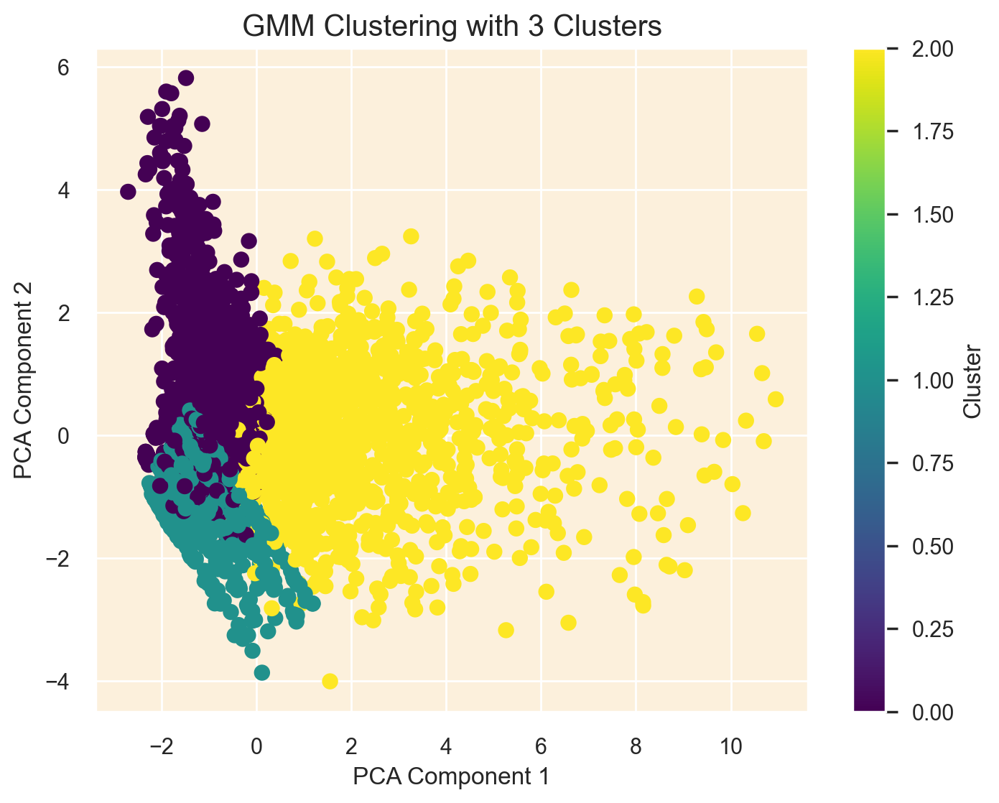

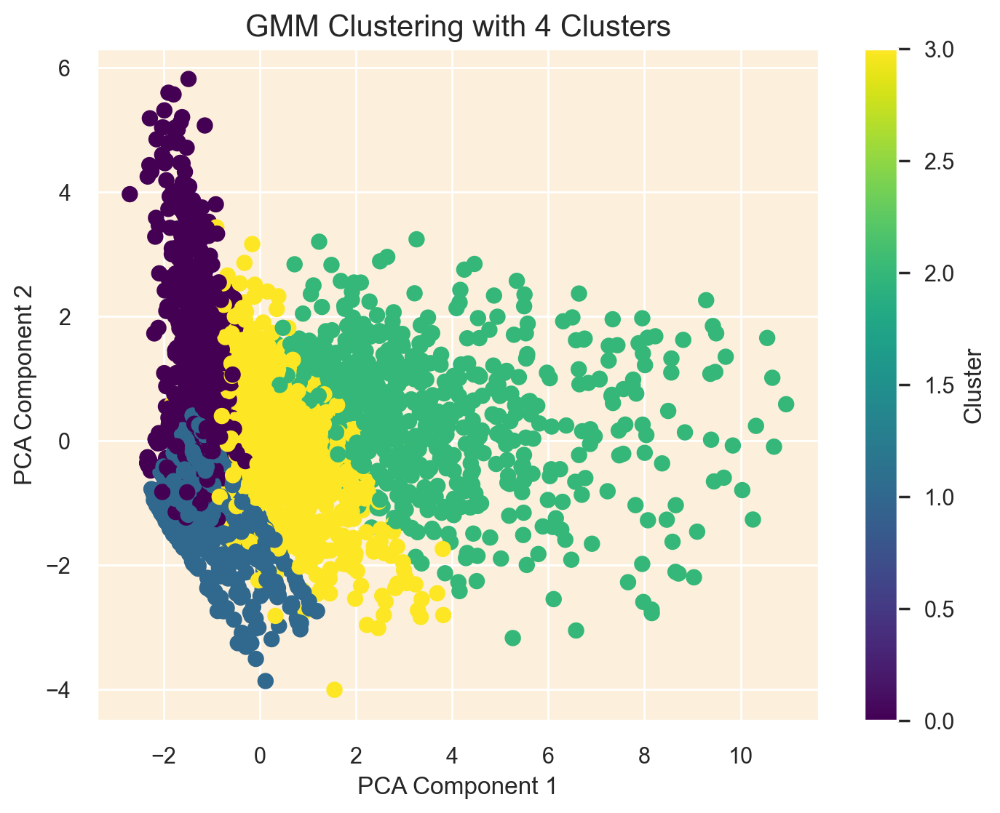

In [ ]:
# # Step 1: Standardize the data
# features = [
#     'Days_Since_Last_Purchase',
#     'Transaction_Count',
#     'Total_Products',
#     'Total_Expenditure',
#     'Avg_Transaction_Value',
#     'Product_Diversity',
#     'Avg_Days_Between_Purchases',
#     'Preferred_Shopping_Day'
# ]
# X = customer_data_cleaned2[features]
# scaler = StandardScaler()
# X_scaled = scaler.fit_transform(X)

# # Step 2: PCA for Dimensionality Reduction
# pca = PCA(n_components=6)
# X_pca = pca.fit_transform(X_scaled)

# # Step 3: Perform GMM Clustering for 3 and 4 clusters
# cluster_results = {}
# for n_clusters in [3, 4]:
#     gmm = GaussianMixture(n_components=n_clusters, random_state=42)
#     labels = gmm.fit_predict(X_pca)
#     customer_data_cleaned2[f'Cluster_{n_clusters}'] = labels
#     cluster_results[n_clusters] = pd.Series(labels).value_counts()

# # Create a cluster size table
# cluster_sizes_gmm = pd.DataFrame(cluster_results)
# cluster_sizes_gmm.columns = [f"{n}_Clusters" for n in [3, 4]]
# print("Cluster Sizes Table:")
# print(cluster_sizes_gmm)

# # Step 4: Plot Cluster Percentages and Sizes
# for n_clusters in [3, 4]:
#     # Cluster percentages
#     cluster_percentage = (
#         customer_data_cleaned2[f'Cluster_{n_clusters}']
#         .value_counts(normalize=True) * 100
#     ).reset_index()
#     cluster_percentage.columns = ['Cluster', 'Percentage']
#     cluster_percentage.sort_values(by='Cluster', inplace=True)

#     # Cluster sizes
#     cluster_size = (
#         customer_data_cleaned2[f'Cluster_{n_clusters}']
#         .value_counts()
#         .reset_index()
#     )
#     cluster_size.columns = ['Cluster', 'Count']
#     cluster_size.sort_values(by='Cluster', inplace=True)

#     # Plot
#     fig, axes = plt.subplots(1, 2, figsize=(15, 5), gridspec_kw={'width_ratios': [3, 1]})

#     # Bar chart for percentages
#     sns.barplot(
#         x='Percentage',
#         y='Cluster',
#         data=cluster_percentage,
#         orient='h',
#         palette='viridis',
#         ax=axes[0]
#     )
#     for index, value in enumerate(cluster_percentage['Percentage']):
#         axes[0].text(value + 0.5, index, f'{value:.2f}%', va='center')
#     axes[0].set_title(f'Distribution of Customers Across {n_clusters} Clusters', fontsize=14)
#     axes[0].set_xlabel('Percentage (%)')
#     axes[0].set_ylabel('Cluster')
#     axes[0].grid(axis='x', linestyle='--', alpha=0.7)

#     # Table for cluster sizes
#     axes[1].axis('tight')
#     axes[1].axis('off')
#     table = axes[1].table(
#         cellText=cluster_size.values,
#         colLabels=cluster_size.columns,
#         loc='center',
#         cellLoc='center',
#     )
#     table.auto_set_font_size(False)
#     table.set_fontsize(12)
#     table.auto_set_column_width([0, 1])

#     plt.tight_layout()
#     plt.show()

# # Step 5: Compute and Plot Silhouette Scores
# silhouette_scores = []
# range_n_clusters = [3, 4]
# for n_clusters in range_n_clusters:
#     gmm = GaussianMixture(n_components=n_clusters, random_state=42)
#     labels = gmm.fit_predict(X_pca)
#     silhouette_scores.append(silhouette_score(X_pca, labels))

# plt.figure(figsize=(10, 6))
# plt.plot(range_n_clusters, silhouette_scores, marker='o', color='orange', label='Silhouette Score')
# plt.title('Silhouette Scores for 3 and 4 Clusters (GMM)', fontsize=15)
# plt.xlabel('Number of clusters (k)')
# plt.ylabel('Silhouette Score')
# plt.xticks(range_n_clusters)
# plt.legend()
# plt.grid()
# plt.show()

# # Step 6: Scatterplots for Clusters
# for n_clusters in [3, 4]:
#     plt.figure(figsize=(8, 6))
#     plt.scatter(X_pca[:, 0], X_pca[:, 1], c=customer_data_cleaned2[f'Cluster_{n_clusters}'], cmap='viridis', s=50)
#     plt.title(f'GMM Clustering with {n_clusters} Clusters', fontsize=15)
#     plt.xlabel('PCA Component 1')
#     plt.ylabel('PCA Component 2')
#     plt.colorbar(label='Cluster')
#     plt.show()


# Model Comparison

In [60]:
def get_cluster_sizes(labels, model_type, n_clusters):
    """
    Returns a Series with cluster sizes labeled by the model type and number of clusters.
    """
    cluster_sizes = pd.Series(labels).value_counts().sort_index()
    cluster_sizes.index = [f"Cluster {i}" for i in cluster_sizes.index]
    cluster_sizes.name = f"{model_type} ({n_clusters} Clusters)"
    return cluster_sizes

# Prepare an empty DataFrame for comparison
comparison_df = pd.DataFrame()

# Perform clustering for both 3 and 4 clusters and merge sizes
for n_clusters in [3, 4]:
    print(f"\n--- Clustering for {n_clusters} Clusters ---")
    
    # KMeans
    kmeans_labels, _ = clustering_pipeline(X_pca, "kmeans", n_clusters)
    kmeans_sizes = get_cluster_sizes(kmeans_labels, "KMeans", n_clusters)
    comparison_df = pd.concat([comparison_df, kmeans_sizes], axis=1)

    # GMM
    gmm_labels, _ = clustering_pipeline(X_pca, "gmm", n_clusters)
    gmm_sizes = get_cluster_sizes(gmm_labels, "GMM", n_clusters)
    comparison_df = pd.concat([comparison_df, gmm_sizes], axis=1)

    # Hierarchical Clustering
    hc_labels, hc_linkage = clustering_pipeline(X_pca, "hierarchy", n_clusters)
    hc_sizes = get_cluster_sizes(hc_labels, "Hierarchical", n_clusters)
    comparison_df = pd.concat([comparison_df, hc_sizes], axis=1)

    # Agglomerative Clustering
    ac_labels, _ = clustering_pipeline(X_pca, "agglomerative", n_clusters)
    ac_sizes = get_cluster_sizes(ac_labels, "Agglomerative", n_clusters)
    comparison_df = pd.concat([comparison_df, ac_sizes], axis=1)

# Fill missing values with 0 (in case some models have fewer clusters than others)
comparison_df.fillna(0, inplace=True)

# Display the final comparison DataFrame
print("\nCluster Size Comparison:")
comparison_df



--- Clustering for 3 Clusters ---

--- Clustering for 4 Clusters ---

Cluster Size Comparison:


,KMeans (3 Clusters),GMM (3 Clusters),Hierarchical (3 Clusters),Agglomerative (3 Clusters),KMeans (4 Clusters),GMM (4 Clusters),Hierarchical (4 Clusters),Agglomerative (4 Clusters)
Cluster 0,499.0,1646.0,0.0,3028.0,909.0,1607.0,0.0,2124.0
Cluster 1,1099.0,1234.0,218.0,218.0,1014.0,1234.0,218.0,218.0
Cluster 2,2730.0,1448.0,1082.0,1082.0,2171.0,880.0,1082.0,1082.0
Cluster 3,0.0,0.0,3028.0,0.0,234.0,607.0,904.0,904.0
Cluster 4,0.0,0.0,0.0,0.0,0.0,0.0,2124.0,0.0


In [ ]:
# # Ensure all DataFrames have proper column names for clarity
# cluster_sizes_ac.columns = [f"AC_{col}" for col in cluster_sizes_ac.columns]
# cluster_sizes_gmm.columns = [f"GMM_{col}" for col in cluster_sizes_gmm.columns]
# cluster_sizes_hc.columns = [f"HC_{col}" for col in cluster_sizes_hc.columns]
# cluster_sizes_kmeans.columns = [f"KMeans_{col}" for col in cluster_sizes_kmeans.columns]

# # Concatenate the DataFrames along the columns axis
# cluster_sizes_combined = pd.concat(
#     [cluster_sizes_ac, cluster_sizes_gmm, cluster_sizes_hc, cluster_sizes_kmeans], 
#     axis=1
# )

# # Display the combined DataFrame
# cluster_sizes_combined


,AC_3_Clusters,AC_4_Clusters,GMM_3_Clusters,GMM_4_Clusters,HC_3_Clusters,HC_4_Clusters,KMeans_3_Clusters,KMeans_4_Clusters
0,2915.0,2004,1617.0,1094,2915.0,911,363.0,519
1,1003.0,1003,1206.0,1206,295.0,2004,3245.0,1909
2,295.0,295,1390.0,650,1003.0,295,605.0,321
3,NaN,911,NaN,1263,NaN,1003,NaN,1464


# Comment:

Best Method and Cluster Number:
Best Model: Gaussian Mixture Model (GMM) provides the most balanced clusters for 3 clusters (1617, 1206, 1390), making it ideal if you want fewer, well-separated customer groups.
Best Alternative: KMeans with 4 clusters produces slightly imbalanced but meaningful clusters, making it better if you prefer more customer groups.
Avoid HC and AC for 3 clusters: Both methods suffer from a dominant cluster, making segmentation less practical.
Rank of Methods (Based on Results):
Gaussian Mixture Model (GMM) – Best balance for 3 clusters.
KMeans – Best for 4 clusters and highly interpretable.
Agglomerative Clustering (AC) – Decent for 4 clusters but not optimal.
Hierarchical Clustering (HC) – Performs similarly to AC but slightly less practical.
Conclusion:
3 clusters: Use GMM.
4 clusters: Use KMeans.

# 5.3 Best Model  Selection and Evaluation metrics 

#  Apply K-means Clustering - 3 clusters

In [61]:
# Load your cleaned dataset
# Replace 'customer_data_cleaned.csv' with the correct file path
customer_data_cleaned = pd.read_csv("customer_data_cleaned.csv")

# Ensure CustomerID is set as the index
if 'CustomerID' in customer_data_cleaned.columns:
    customer_data_cleaned.set_index('CustomerID', inplace=True)


In [62]:
# Standardize the data (excluding the 'cluster' column, if it exists)
scaler = StandardScaler()
features = customer_data_cleaned.drop(columns=['cluster'], errors='ignore')
customer_data_scaled = scaler.fit_transform(features)

# Convert the standardized data back to a DataFrame
customer_data_scaled = pd.DataFrame(
    customer_data_scaled,
    columns=features.columns,
    index=customer_data_cleaned.index
)


In [63]:
def apply_kmeans(data, n_clusters=3):
    kmeans = KMeans(n_clusters=n_clusters, init='k-means++', n_init=10, max_iter=100, random_state=0)
    labels = kmeans.fit_predict(data)
    return kmeans, labels

# Apply KMeans clustering
kmeans, kmeans_labels = apply_kmeans(customer_data_scaled, n_clusters=3)

# Assign cluster labels to the original and scaled datasets
customer_data_cleaned['cluster'] = kmeans_labels
customer_data_scaled['cluster'] = kmeans_labels


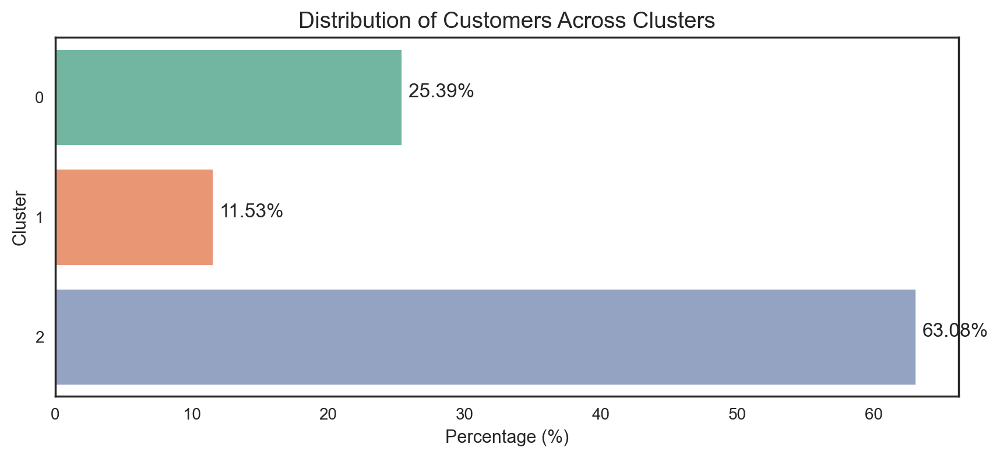

In [64]:
def plot_cluster_distribution(data, palette):
    cluster_percentage = (data['cluster'].value_counts(normalize=True) * 100).reset_index()
    cluster_percentage.columns = ['Cluster', 'Percentage']
    cluster_percentage.sort_values(by='Cluster', inplace=True)

    # Create a horizontal bar plot
    plt.figure(figsize=(10, 4))
    sns.barplot(x='Percentage', y='Cluster', data=cluster_percentage, orient='h', palette=palette)

    # Adding percentages on the bars
    for index, value in enumerate(cluster_percentage['Percentage']):
        plt.text(value + 0.5, index, f'{value:.2f}%')

    plt.title('Distribution of Customers Across Clusters', fontsize=14)
    plt.xlabel('Percentage (%)')
    plt.show()

# Plot cluster distribution
colors = sns.color_palette("Set2", 3)  # Define a palette for 3 clusters
plot_cluster_distribution(customer_data_cleaned, colors)


In [65]:
def evaluate_clustering(data, labels):
    metrics = {
        "Number of Observations": len(data),
        "Silhouette Score": silhouette_score(data, labels),
        "Calinski Harabasz Score": calinski_harabasz_score(data, labels),
        "Davies Bouldin Score": davies_bouldin_score(data, labels),
    }
    return metrics

# Evaluate the clustering
metrics = evaluate_clustering(customer_data_scaled.drop(columns='cluster'), customer_data_scaled['cluster'])
print(tabulate(metrics.items(), headers=["Metric", "Value"], tablefmt="pretty"))


+-------------------------+--------------------+
|         Metric          |       Value        |
+-------------------------+--------------------+
| Number of Observations  |        4328        |
|    Silhouette Score     | 0.2485817453221713 |
| Calinski Harabasz Score | 1548.0942852587098 |
|  Davies Bouldin Score   | 1.2931825809634114 |
+-------------------------+--------------------+


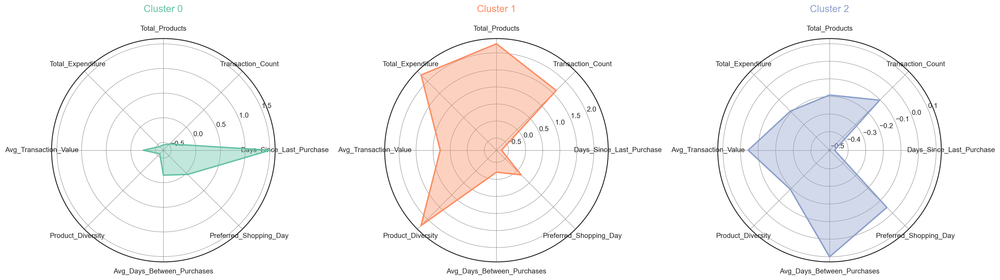

In [66]:
def create_radar_chart(ax, angles, data, color, cluster):
    ax.fill(angles, data, color=color, alpha=0.4)
    ax.plot(angles, data, color=color, linewidth=2, linestyle='solid')
    ax.set_title(f'Cluster {cluster}', size=14, color=color, y=1.1)

# Compute cluster centroids
cluster_centroids = customer_data_scaled.groupby('cluster').mean()

# Radar Chart Setup
labels = cluster_centroids.columns
num_vars = len(labels)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Close the radar chart loop

# Create radar charts for each cluster
fig, axes = plt.subplots(1, 3, figsize=(20, 6), subplot_kw=dict(polar=True))

for i, ax in enumerate(axes):
    data = cluster_centroids.loc[i].tolist() + cluster_centroids.loc[i].tolist()[:1]
    create_radar_chart(ax, angles, data, sns.color_palette("Set2", 3)[i], cluster=i)

# Add labels
for ax in axes:
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels)
    ax.grid(color='grey', linewidth=0.5)

plt.tight_layout()
plt.show()


Cluster Centroids (Standardized Data):
+---------+--------------------------+----------------------+----------------------+----------------------+-----------------------+---------------------+----------------------------+------------------------+
| cluster | Days_Since_Last_Purchase |  Transaction_Count   |    Total_Products    |  Total_Expenditure   | Avg_Transaction_Value |  Product_Diversity  | Avg_Days_Between_Purchases | Preferred_Shopping_Day |
+---------+--------------------------+----------------------+----------------------+----------------------+-----------------------+---------------------+----------------------------+------------------------+
|    0    |    1.5055645724996092    | -0.4794981659992779  | -0.5528055148343476  | -0.5530631814827078  |  -0.2505038778288652  | -0.5564481098224429 |    -0.1530798311695808     |  0.03693587475182285   |
|    1    |   -0.7066337863347544    |  1.6211773159528506  |  2.2662409953152696  |  2.265562999859327   |   0.79047561057343   

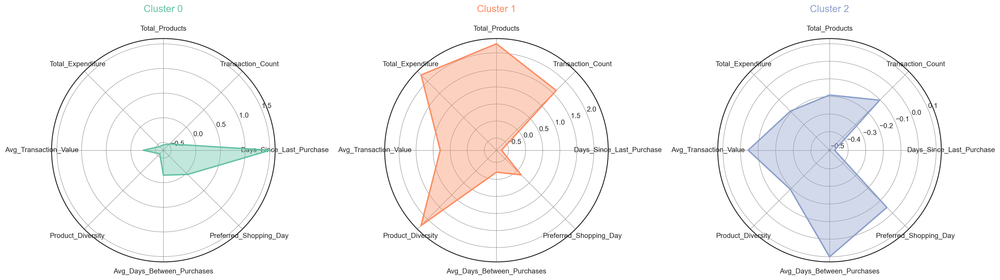

In [67]:
# Display the cluster centroids
print("Cluster Centroids (Standardized Data):")
print(tabulate(cluster_centroids, headers="keys", tablefmt="pretty"))

# Function to create a radar chart for a single cluster
def create_radar_chart(ax, angles, data, color, cluster):
    ax.fill(angles, data, color=color, alpha=0.4)
    ax.plot(angles, data, color=color, linewidth=2, linestyle='solid')
    ax.set_title(f'Cluster {cluster}', size=14, color=color, y=1.1)

# Radar Chart Setup
labels = cluster_centroids.columns
num_vars = len(labels)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Close the radar chart loop

# Create radar charts for each cluster
fig, axes = plt.subplots(1, 3, figsize=(20, 6), subplot_kw=dict(polar=True))

for i, ax in enumerate(axes):
    # Retrieve data for the current cluster and complete the loop for plotting
    data = cluster_centroids.iloc[i].tolist() + cluster_centroids.iloc[i].tolist()[:1]
    create_radar_chart(ax, angles, data, sns.color_palette("Set2", 3)[i], cluster=i)

# Add labels and customize the appearance
for ax in axes:
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels, fontsize=10)
    ax.grid(color='grey', linewidth=0.5)

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


In [ ]:
# Apply KMeans clustering using 4 clusters
kmeans = KMeans(n_clusters=4, init='k-means++', n_init=10, max_iter=300, random_state=42)
kmeans.fit(customer_data_pca)

# Get the frequency of each cluster
# cluster_frequencies = Counter(kmeans.labels_)

Map old labels to new labels based on frequency
label_mapping = {label: new_label for new_label, (label, _) in enumerate(cluster_frequencies.most_common())}

# Apply the mapping to get the new labels
new_labels = np.array([label_mapping[label] for label in kmeans.labels_])

# Append the new cluster labels back to the original dataset
customer_data_cleaned['cluster'] = new_labels

# Append the new cluster labels to the PCA version of the dataset
customer_data_pca['cluster'] = new_labels

# Display the first few rows of the updated dataframe
customer_data_cleaned.head()


,CustomerID,Days_Since_Last_Purchase,Transaction_Count,Total_Products,Total_Expenditure,Avg_Transaction_Value,Product_Diversity,Avg_Days_Between_Purchases,Preferred_Shopping_Day,Cluster_3,Cluster_4,cluster
0,12346.0,334.0,2.0,119.0,5342.40,2671.2000,2.0,0.000000,5.0,0,0,0
1,12347.0,0.0,7.0,8511.0,431501.00,61643.0000,181.0,2.016575,5.0,2,2,0
2,12348.0,91.0,4.0,1539.0,82378.47,20594.6175,31.0,9.133333,2.0,0,0,1
3,12349.0,30.0,1.0,3434.0,176075.12,176075.1200,73.0,0.000000,1.0,1,1,1
4,12350.0,303.0,1.0,917.0,48173.37,48173.3700,17.0,0.000000,1.0,1,1,2


# Step 2: Calculate Cluster Centroids and Create Radar Chart

Cluster Centroids (Standardized Data):


,Days_Since_Last_Purchase,Transaction_Count,Total_Products,Total_Expenditure,Avg_Transaction_Value,Product_Diversity,Avg_Days_Between_Purchases,Preferred_Shopping_Day,Cluster_3,Cluster_4
cluster,,,,,,,,,,
0,0.018621,-0.273401,-0.311250,-0.311487,-0.086041,-0.311348,-0.054699,0.932449,-0.207473,-0.063313
1,-0.538993,0.054679,-0.087409,-0.086992,-0.013579,-0.085502,0.366058,-0.890610,0.037908,0.191998
2,1.607369,-0.564371,-0.566505,-0.565893,-0.253695,-0.570184,-0.372469,-0.769985,-0.334647,-0.556319
3,-0.733498,1.809891,2.410693,2.409546,0.773357,2.410539,-0.355197,-0.141084,1.249987,0.479917


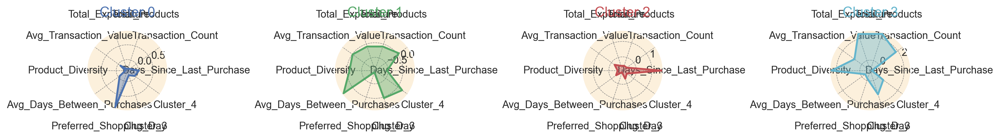

In [ ]:
# Standardize the data (excluding the cluster column)
scaler = StandardScaler()
df_customer = customer_data_cleaned.set_index('CustomerID')
df_standardized = scaler.fit_transform(df_customer.drop(columns=['cluster'], axis=1))

# Create a new dataframe with standardized values and add the cluster column back
df_standardized = pd.DataFrame(df_standardized, columns=df_customer.columns[:-1], index=df_customer.index)
df_standardized['cluster'] = df_customer['cluster']

# Calculate centroids for each cluster
cluster_centroids = df_standardized.groupby('cluster').mean()

# Display cluster centroids as a table
print("Cluster Centroids (Standardized Data):")
display(cluster_centroids)

# Radar Chart Function
def create_radar_chart(ax, angles, data, color, cluster):
    ax.fill(angles, data, color=color, alpha=0.4)
    ax.plot(angles, data, color=color, linewidth=2)
    ax.set_title(f'Cluster {cluster}', size=15, color=color, y=1.1)

# Prepare radar chart data
labels = np.array(cluster_centroids.columns)
num_vars = len(labels)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
labels = np.concatenate((labels, [labels[0]]))  # Close the circle
angles += angles[:1]

# Initialize radar chart
fig, axes = plt.subplots(figsize=(15, 10), subplot_kw=dict(polar=True), nrows=1, ncols=4)

colors = ['b', 'g', 'r', 'c']  # Colors for the clusters
for i, color in enumerate(colors):
    data = cluster_centroids.loc[i].tolist() + cluster_centroids.loc[i].tolist()[:1]
    create_radar_chart(axes[i], angles, data, color, i)

for ax in axes:
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels[:-1])
    ax.grid(color='grey', linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.show()


#Step 3: Compute Evaluation Metric

In [ ]:
# Compute number of observations
num_observations = len(customer_data_pca)

# Separate features and cluster labels
X = customer_data_pca.drop(columns=['cluster'])
clusters = customer_data_pca['cluster']

# Compute clustering metrics
sil_score = silhouette_score(X, clusters)
calinski_score = calinski_harabasz_score(X, clusters)
davies_score = davies_bouldin_score(X, clusters)

# Create a metrics table
table_data = [
    ["Number of Observations", num_observations],
    ["Silhouette Score", sil_score],
    ["Calinski Harabasz Score", calinski_score],
    ["Davies Bouldin Score", davies_score]
]

# Display the metrics table
print(tabulate(table_data, headers=["Metric", "Value"], tablefmt="pretty"))


+-------------------------+--------------------+
|         Metric          |       Value        |
+-------------------------+--------------------+
| Number of Observations  |        4213        |
|    Silhouette Score     | 0.2825930129607483 |
| Calinski Harabasz Score | 1605.4897152116603 |
|  Davies Bouldin Score   | 1.187299145346302  |
+-------------------------+--------------------+


# GMM -GMM Clustering, Radar Chart, and Evaluation Metrics

Cluster Centroids (Standardized Data):
         CustomerID  Days_Since_Last_Purchase  Transaction_Count  \
cluster                                                            
0          0.018103                  0.603105          -0.687542   
1         -0.002305                 -0.548317           0.843114   
2         -0.011689                  0.031937          -0.231236   

         Total_Products  Total_Expenditure  Avg_Transaction_Value  \
cluster                                                             
0             -0.574380          -0.574232               0.134228   
1              1.003213           1.002151               0.484531   
2             -0.460237          -0.459401              -0.534905   

         Product_Diversity  Avg_Days_Between_Purchases  \
cluster                                                  
0                -0.578996                   -0.596908   
1                 1.007583                   -0.199845   
2                -0.460637                

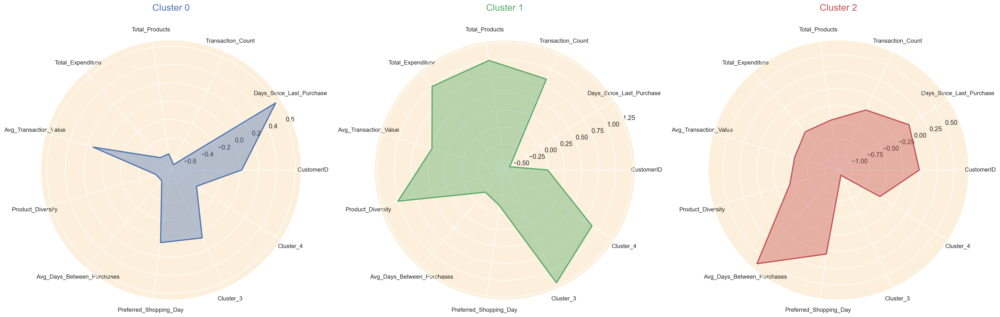

+-------------------------+---------------------+
|         Metric          |        Value        |
+-------------------------+---------------------+
| Number of Observations  |        4213         |
|    Silhouette Score     | 0.08712289117243462 |
| Calinski Harabasz Score |  731.3254189259675  |
|  Davies Bouldin Score   |  2.505086984063937  |
+-------------------------+---------------------+


In [ ]:
# Step 1: Apply GMM Clustering
gmm = GaussianMixture(n_components=3, random_state=0)
gmm_labels = gmm.fit_predict(customer_data_pca.drop(columns=['cluster'], errors='ignore'))  # Exclude any pre-existing cluster column

# Append the new cluster labels back to the original dataset
customer_data_cleaned['cluster'] = gmm_labels
customer_data_pca['cluster'] = gmm_labels

# Step 2: Standardize the data (excluding the cluster column)
scaler = StandardScaler()
df_customer_standardized = scaler.fit_transform(customer_data_cleaned.drop(columns=['cluster'], axis=1))

# Create a new DataFrame for standardized values and add the cluster column
df_customer_standardized = pd.DataFrame(
    df_customer_standardized,
    columns=customer_data_cleaned.columns[:-1],  # Exclude the cluster column
    index=customer_data_cleaned.index
)
df_customer_standardized['cluster'] = customer_data_cleaned['cluster']

# Calculate the centroids of each cluster
cluster_centroids = df_customer_standardized.groupby('cluster').mean()

# Step 3: Display the cluster centroids as a table
print("Cluster Centroids (Standardized Data):")
print(cluster_centroids)

# Step 4: Create Radar Chart
def create_radar_chart(ax, angles, data, color, cluster):
    ax.fill(angles, data, color=color, alpha=0.4)
    ax.plot(angles, data, color=color, linewidth=2)
    ax.set_title(f'Cluster {cluster}', size=16, color=color, y=1.1)

# Radar chart setup
labels = cluster_centroids.columns
num_vars = len(labels)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Complete the loop for radar chart

# Plot each cluster
fig, ax = plt.subplots(1, 3, figsize=(24, 8), subplot_kw=dict(polar=True))
colors = ['b', 'g', 'r']

for i, color in enumerate(colors):
    data = cluster_centroids.loc[i].tolist() + cluster_centroids.loc[i].tolist()[:1]  # Complete the loop
    create_radar_chart(ax[i], angles, data, color, i)
    ax[i].set_xticks(angles[:-1])
    ax[i].set_xticklabels(labels, fontsize=10)

plt.tight_layout()
plt.show()

# Step 5: Compute Evaluation Metrics
num_observations = len(customer_data_pca)
X = customer_data_pca.drop('cluster', axis=1)
clusters = customer_data_pca['cluster']

sil_score = silhouette_score(X, clusters)
calinski_score = calinski_harabasz_score(X, clusters)
davies_score = davies_bouldin_score(X, clusters)

# Create a table to display metrics
table_data = [
    ["Number of Observations", num_observations],
    ["Silhouette Score", sil_score],
    ["Calinski Harabasz Score", calinski_score],
    ["Davies Bouldin Score", davies_score]
]

print(tabulate(table_data, headers=["Metric", "Value"], tablefmt='pretty'))


# Comments:
Based on the evaluation metrics, KMeans with 4 clusters performs better than GMM with 3 clusters for customer segmentation. Here's why:

Silhouette Score:

Higher values indicate better cluster separation.
KMeans: 0.283 (better) vs. GMM: 0.087 (poor separation).
Calinski-Harabasz Score:

Higher values represent better-defined clusters with greater separation and compactness.
KMeans: 1605.49 (better) vs. GMM: 731.33.
Davies-Bouldin Score:

Lower values indicate better clustering quality (less overlap).
KMeans: 1.187 (better) vs. GMM: 2.505 (worse).
Conclusion:
KMeans (4 clusters) outperforms GMM (3 clusters) across all evaluation metrics and should be chosen for customer segmentation.

# 5.4 Model Interpretation

# Summary
Based on the Evaluation Metrics , KMEANS Cluster is chosen model for the Customer Segmentation

# Cluster Analysis for KMeans 4 Clusters:

1. **Cluster 0: Weekend Shoppers with Moderate Activity**
Customers in this cluster are moderately engaged, with slightly below-average purchase frequency, product diversity, and expenditure. However, they tend to shop more frequently on weekends. Their average days between purchases are close to the mean, indicating relatively stable shopping habits.

  * Business Insight: Leverage weekend sales and promotions tailored for these customers to boost engagement. Encourage them to shop on weekdays with exclusive discounts.

2. **Cluster 1: Occasional Shoppers with Stable Spending**
This segment consists of customers who shop less frequently, with average spending and moderate transaction counts. Their purchases are less diverse, and their buying behavior is relatively stable, with longer intervals between purchases compared to other segments.

  * Business Insight: Use targeted marketing campaigns and loyalty programs to increase engagement. Highlight product bundles or special offers to encourage higher spending.

3. **Cluster 2: Dormant Customers**
Customers in this cluster show minimal engagement, with the longest gaps since their last purchase, low transaction counts, and low expenditure. They exhibit the least diversity in products and low average transaction values.

  * Business Insight: Reactivate these customers through win-back campaigns, such as email reminders, special discounts, or personalized offers to incentivize a return to purchasing.

4. **Cluster 3: High-Value Frequent Shoppers**
This cluster represents the most engaged and valuable customers. They make frequent purchases, buy a wide variety of products, and have significantly higher total expenditures and average transaction values. They shop consistently and show high product diversity.

  * Business Insight: Focus on retaining these loyal and profitable customers through personalized recommendations, VIP rewards, or exclusive early access to sales to further enhance their lifetime value.

**Summary of Insights:**
Cluster 0: Weekend shoppers with moderate activity – focus on weekend deals.
Cluster 1: Occasional shoppers – encourage higher engagement and spending.
Cluster 2: Dormant customers – deploy win-back strategies.
Cluster 3: High-value frequent shoppers – prioritize loyalty and retention efforts.

#
Cluster 0: Low-Value Infrequent Shoppers
Customers in this cluster are relatively inactive and less profitable. They make fewer purchases, buy fewer products, and spend below average. While they have made recent purchases, they show less engagement with the brand. Their transaction values are below average, and they tend to purchase less diverse products. Their longer gaps between purchases indicate lower overall loyalty.
Business Insight: Focus on re-engaging these customers with targeted promotions or personalized incentives to increase their purchasing frequency and overall spend.

Cluster 1: High-Value Frequent Shoppers
Customers in this cluster are highly active and profitable. They make frequent purchases, buy a wide variety of products, and spend significantly more than the average customer. They shop relatively recently and prefer a diverse range of items. Their shorter gaps between purchases and above-average transaction values suggest strong engagement and loyalty.
Business Insight: Focus on retaining these customers with exclusive offers, loyalty rewards, or personalized recommendations to maximize their lifetime value.

Cluster 2: Moderate-Value Occasional Shoppers
Customers in this cluster show moderate activity and spending. They purchase somewhat infrequently, buy a limited variety of products, and spend slightly below average. Their transaction values are near the average, and they tend to purchase less diverse products. Their purchase intervals are longer, indicating they are not as engaged as high-value shoppers.
Business Insight: Focus on increasing their purchasing frequency with strategic offers or reminders about new products, encouraging them to become more engaged and increase their lifetime value.






